In [ ]:
import os
import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy
from sklearn.model_selection import train_test_split

In [ ]:
warnings.filterwarnings("ignore")

In [ ]:
from signature_validation.plotting.plotting import (
    boxplot_with_pvalue,
    default_cmap,
    genes_heatmap,
    grouped_boxplot_with_pvalue,
    plot_waterfall,
)
from signature_validation.ssgsea_calc.ssgsea_calc import (
    GeneSet,
    gmt_genes_alt_names,
    ssgsea_formula,
)
from signature_validation.utils.utils import (
    get_expression_table,
    get_gspread,
    median_scale,
    prepare_sample_annot,
    process_generic_dataset,
    read_dataset,
    read_expressions,
    to_common_samples,
)

In [ ]:
import seaborn as sns

sns.set_style("white")

# Signature validation: cell lines with in vitro induced hypoxia

## read anno

In [ ]:
hypo_annot = pd.read_csv(
    "./data/Hypoxia_Annotation_train_data.tsv", sep="\t", index_col=0
)

hypo_annot = hypo_annot[~hypo_annot["Decision"].isin(["bad", "Undefined"])]
hypo_annot = hypo_annot[hypo_annot.Readcounts != ""]
hypo_annot = hypo_annot[hypo_annot["Readcounts"] >= 10e5]
hypo_annot = hypo_annot[hypo_annot.QC_score != ""]

hypo_annot = prepare_sample_annot(hypo_annot)
hypo_annot

,Readcounts,Sample,Dataset,Table,Hypoxia_state,Cell_type_new,Cell_type,Cell_type_details,Extended_details,Stimulation,...,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),Deconvolution_cell_type,Filter_tag,Filter_tag.1
ERX2932016,3.556674e+07,ERX2932016,E-MTAB-6647,Cancer_cell_lines_to_check,Hypoxia,Breast_Neoplasm_hypoxic,Invasive_Ductal_Breast_Carcinoma,line,BT-549,incubated in DMEM-F12 in hypoxia (0.1% O2),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Invasive_Ductal_Breast_Carcinoma,NaN,NaN
ERX2932017,3.013628e+07,ERX2932017,E-MTAB-6647,Cancer_cell_lines_to_check,Hypoxia,Breast_Neoplasm_hypoxic,Invasive_Ductal_Breast_Carcinoma,line,BT-549,incubated in DMEM-F12 in hypoxia (0.1% O2),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Invasive_Ductal_Breast_Carcinoma,NaN,NaN
ERX2932018,2.540770e+07,ERX2932018,E-MTAB-6647,Cancer_cell_lines_to_check,Hypoxia,Breast_Neoplasm_hypoxic,Invasive_Ductal_Breast_Carcinoma,line,BT-549,incubated in DMEM-F12 in hypoxia (0.1% O2),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Invasive_Ductal_Breast_Carcinoma,NaN,NaN
ERX2932019,3.473148e+07,ERX2932019,E-MTAB-6647,Cancer_cell_lines_to_check,Hypoxia,Breast_Neoplasm_hypoxic,Breast_Neoplasm,line,CAL-120,incubated in DMEM-F12 in hypoxia (0.1% O2),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Breast_Neoplasm,NaN,NaN
ERX2932020,2.333791e+07,ERX2932020,E-MTAB-6647,Cancer_cell_lines_to_check,Hypoxia,Breast_Neoplasm_hypoxic,Breast_Neoplasm,line,CAL-120,incubated in DMEM-F12 in hypoxia (0.1% O2),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Breast_Neoplasm,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRX9731514,4.256539e+06,SRX9731514,GSE163827,Cells_to_check,Hypoxia,Endothelium_hypoxic,Endothelium,Brain microvascular endothelal cells,NaN,Hour_24_of_Hypoxia_(0.2%_O2),...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Endothelium,NaN,NaN
SRX984340,2.541182e+07,SRX984340,GSE60217,Cells,Hypoxia,Endothelium_hypoxic,Endothelium,HUVEC,NaN,Hour_24_of_hypoxia,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Endothelium,NaN,NaN
SRX984341,2.490484e+07,SRX984341,GSE60217,Cells,Hypoxia,Endothelium_hypoxic,Endothelium,HUVEC,NaN,Hour_24_of_hypoxia,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Endothelium,NaN,NaN
SRX984342,2.577323e+07,SRX984342,GSE60217,Cells,Control,Endothelium,Endothelium,HUVEC,NaN,Without_stimulation,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Endothelium,NaN,NaN


In [ ]:
hypo_annot["Cell_type"] = (
    hypo_annot.Cell_type.replace("Cutaneous_Melanoma", "Melanoma")
    .replace("Endothelial", "Endothelium")
    .replace("Invasive_Ductal_Breast_Carcinoma", "Breast_Neoplasm")
    .replace("Lung_adenocarcinoma", "Lung_Adenocarcinoma")
    .replace("Triple_negative_Breast_Cancer", "Breast_Neoplasm")
)

## anno stats

In [ ]:
hypo_annot[["Cell_type", "Hypoxia_state"]].value_counts(sort=False)

Cell_type                         Hypoxia_state
Astrocytes                        Control           4
                                  Hypoxia           4
Breast_Neoplasm                   Control          23
                                  Hypoxia          29
Clear_Cell_Carcinoma              Control           3
                                  Hypoxia           3
Endothelium                       Control          15
                                  Hypoxia          38
Epithelium                        Control           3
                                  Hypoxia           3
Fibroblast_line                   Control           8
                                  Hypoxia           8
Fibroblasts                       Control           6
                                  Hypoxia          10
HSPC                              Control           4
                                  Hypoxia           4
Hepatocytes                       Control          10
                                  

In [ ]:
hypo_annot[["Cell_type", "Dataset", "Hypoxia_state"]].value_counts(sort=False)

Cell_type                         Dataset      Hypoxia_state
Astrocytes                        GSE147870    Control           4
                                               Hypoxia           4
Breast_Neoplasm                   E-MTAB-6647  Control          18
                                               Hypoxia          18
                                  GSE107692    Hypoxia           6
                                  GSE131378    Control           2
                                               Hypoxia           2
                                  GSE71401     Control           3
                                               Hypoxia           3
Clear_Cell_Carcinoma              GSE85353     Control           3
                                               Hypoxia           3
Endothelium                       GSE120523    Control           3
                                               Hypoxia           3
                                  GSE136908    Hypoxia           8
 

## read expressions

In [ ]:
hypo_expr = read_expressions(hypo_annot)  # Get via GEO: (see annotation table)

In [ ]:
hypo_expr = np.log2(hypo_expr + 1)

## define custom signature

In [ ]:
signature_of_interest = """FUT11	NDRG1	EPAS1	CA9	LDHA	LOX	SLC2A1	P4HA1	CA12	HK2	PDK1	PGK1	TPI1	ALDOA	PFKFB3""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']

# add here a custon signature name (as a first input)
signature_name = "Main4_Hypoxia_factors"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

## Validation

### Train data

In [ ]:
# define celltypes of interest
categories = [
    "Endothelium",
    "Fibroblasts",
    "Fibroblast_line",
    "Smooth_muscle_cells",
    "Hepatocytes",
    "Astrocytes",
    "HSPC",
    "Macrophages",
    "Epithelium",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Lung_Adenocarcinoma",
    "Clear_Cell_Carcinoma",
    "Melanoma",
]

# dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat([annot, hypo_annot.loc[hypo_annot["Cell_type"].isin([i])]])

# for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(
    annot["Cell_type"], categories=categories, ordered=True
)
annot = annot.sort_values("Cell_type")

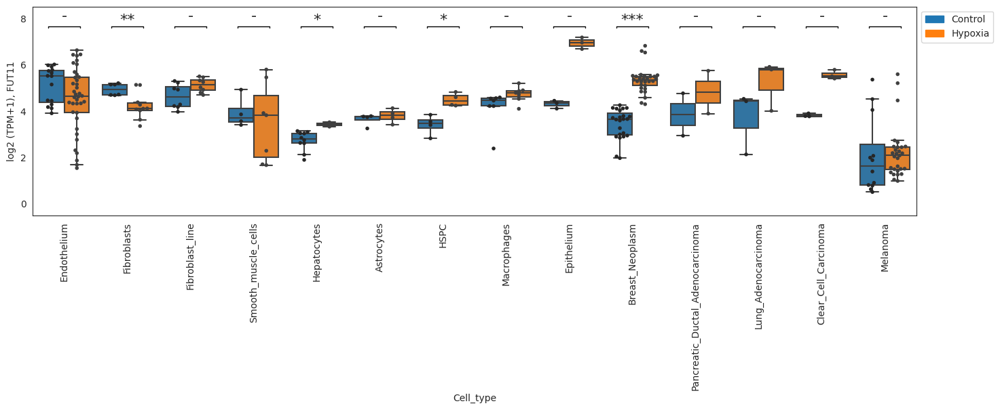

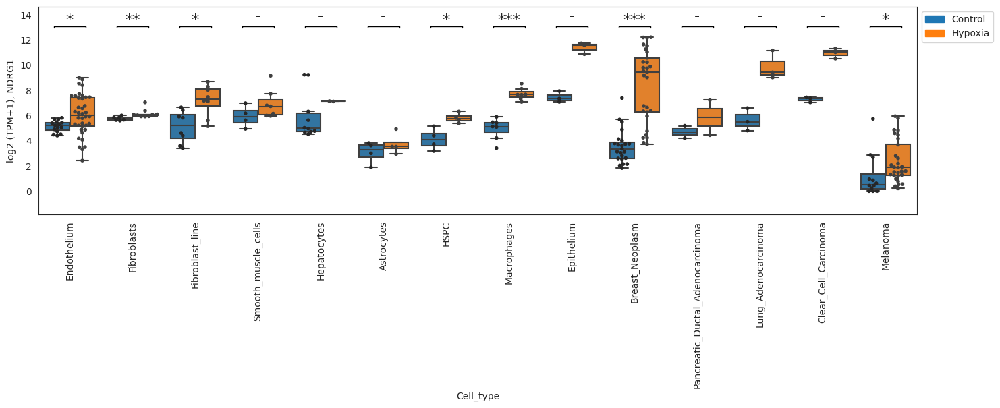

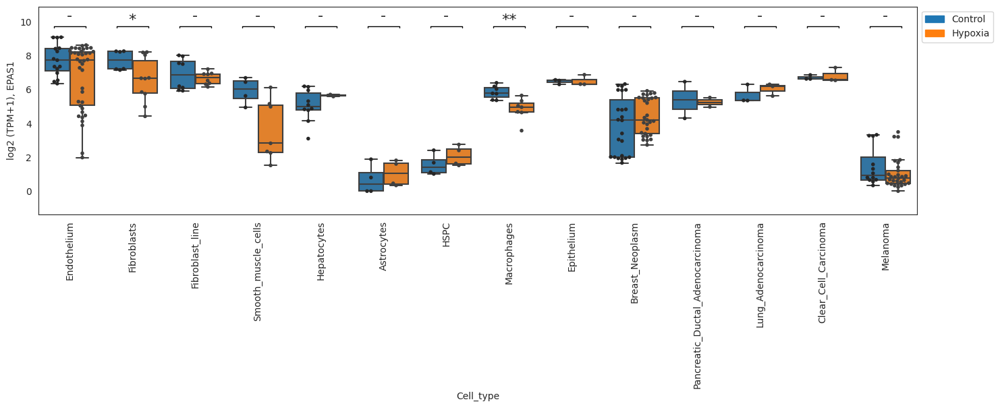

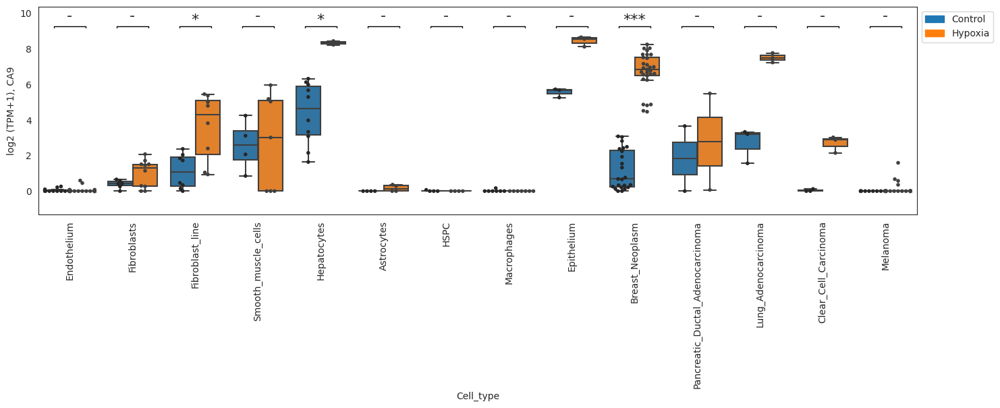

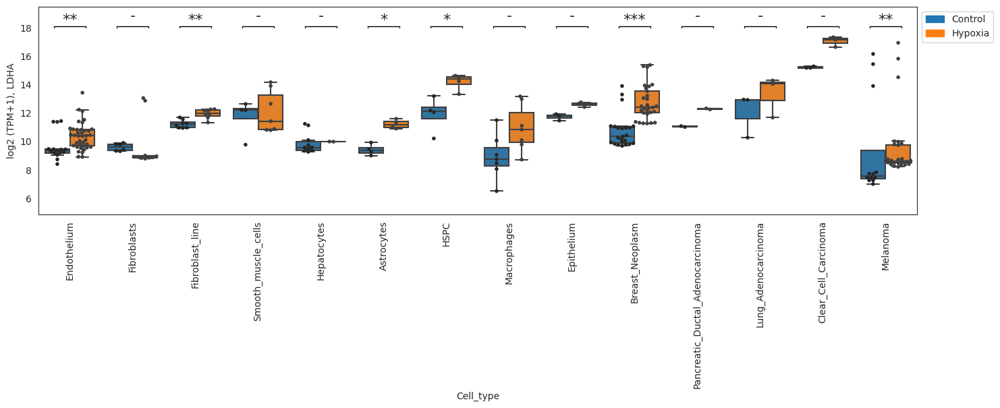

...

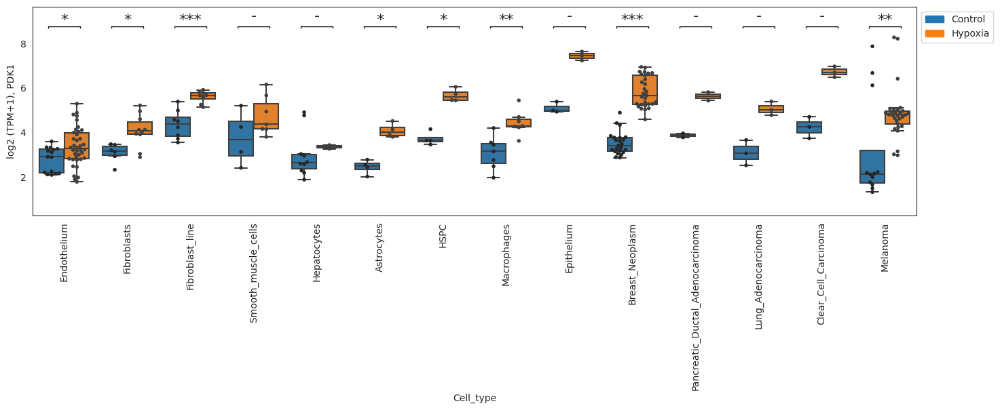

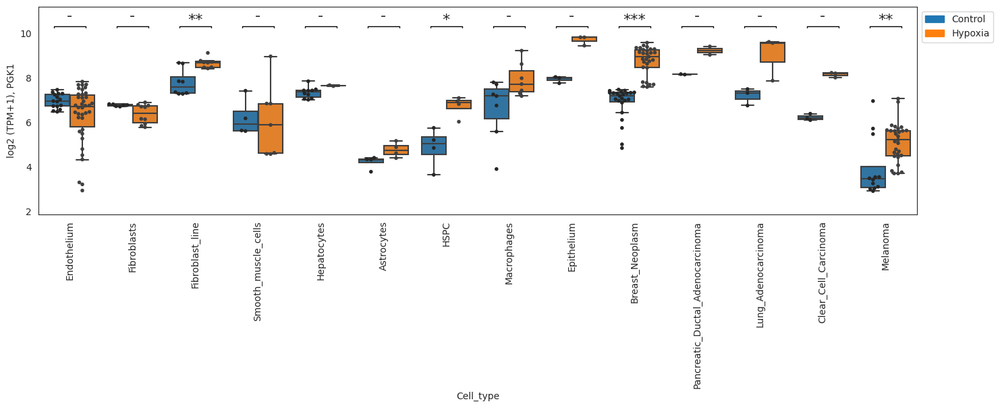

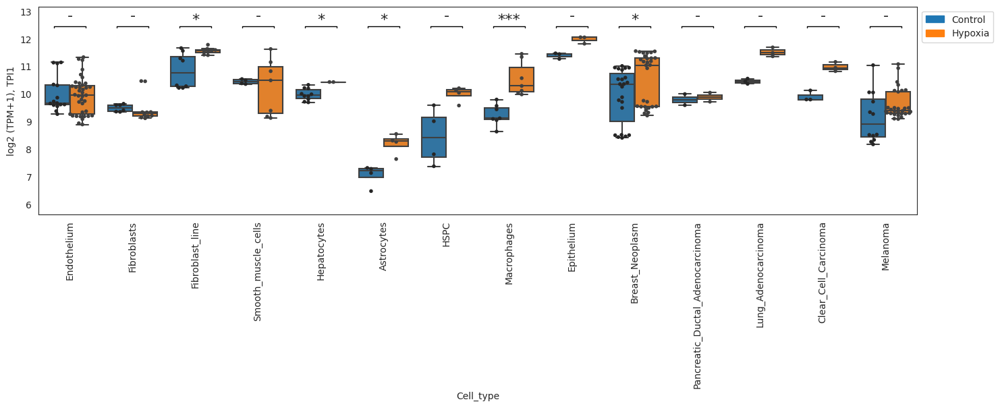

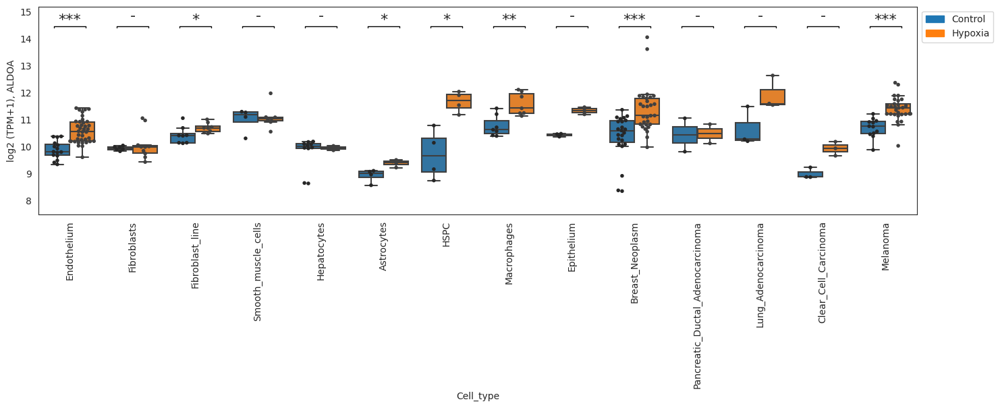

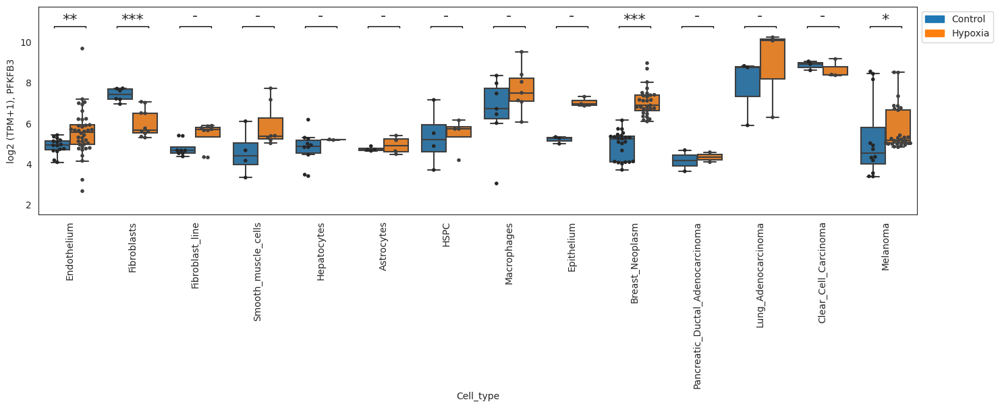

In [ ]:
# boxplots depicting signature genes expression in celltypes of interest

categories = [
    "Endothelium",
    "Fibroblasts",
    "Fibroblast_line",
    "Smooth_muscle_cells",
    "Hepatocytes",
    "Astrocytes",
    "HSPC",
    "Macrophages",
    "Epithelium",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Lung_Adenocarcinoma",
    "Clear_Cell_Carcinoma",
    "Melanoma",
]

for gene in signature_of_interest:
    grouped_boxplot_with_pvalue(
        hypo_expr.loc[gene],
        annot[annot["Cell_type"].isin(categories)]["Cell_type"],
        order=categories,
        s=4,
        hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
        hue_order=["Control", "Hypoxia"],
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
hypo_cells_ssgsea_unscaled = ssgsea_formula(
    hypo_expr, gmt_genes_alt_names(geneset_of_interest, hypo_expr.index, verbose=False)
).T

In [ ]:
x = hypo_annot.groupby("Dataset")

hypo_cells_ssgsea_scaled = {}
for i in x:
    hypo_cells_ssgsea_scaled[i[0]] = median_scale(
        hypo_cells_ssgsea_unscaled.reindex(i[1].index)
    )

hypo_cells_ssgsea_scaled = pd.concat(hypo_cells_ssgsea_scaled.values())

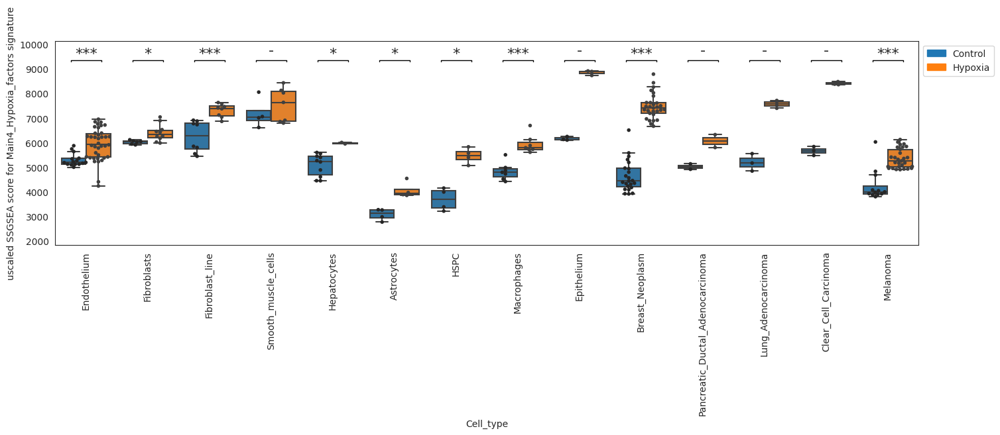

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Endothelium",
    "Fibroblasts",
    "Fibroblast_line",
    "Smooth_muscle_cells",
    "Hepatocytes",
    "Astrocytes",
    "HSPC",
    "Macrophages",
    "Epithelium",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Lung_Adenocarcinoma",
    "Clear_Cell_Carcinoma",
    "Melanoma",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],
)

plt.xticks(rotation=90)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

Suppl figure 3D

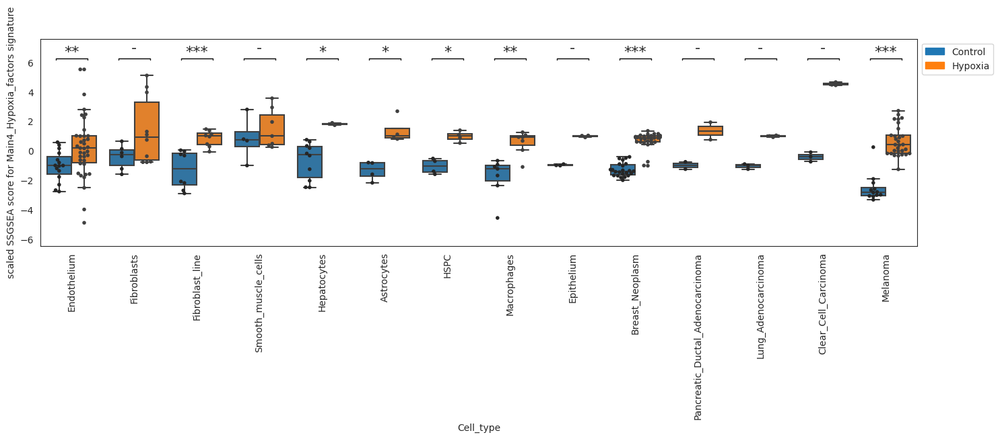

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Endothelium",
    "Fibroblasts",
    "Fibroblast_line",
    "Smooth_muscle_cells",
    "Hepatocytes",
    "Astrocytes",
    "HSPC",
    "Macrophages",
    "Epithelium",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Lung_Adenocarcinoma",
    "Clear_Cell_Carcinoma",
    "Melanoma",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],  # palette=spalette
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
plt.savefig("/uftp/users/msavchenko/figures/Hypoxia_signature_train.svg", format="svg")

plt.show()

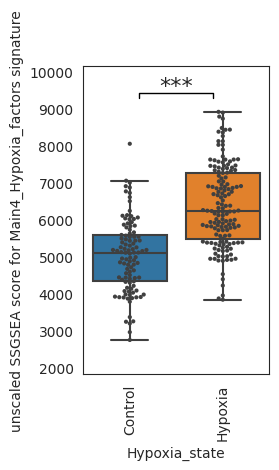

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = ["Control", "Hypoxia"]

boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot[annot["Hypoxia_state"].isin(categories)]["Hypoxia_state"],
    s=3,
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()

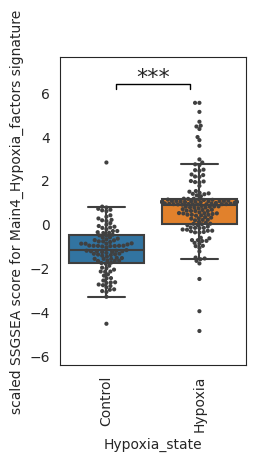

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = ["Control", "Hypoxia"]

boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot[annot["Hypoxia_state"].isin(categories)]["Hypoxia_state"],
    s=3,
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
plt.savefig("./figures/Hypoxia_signature_train_merged.svg", format="svg")

plt.show()

### Test data

In [ ]:
#
hypo_annot = pd.read_csv("Hypoxia_Annotation_test_data.tsv", sep="\t", index_col=0)

hypo_annot = hypo_annot[~hypo_annot["Decision"].isin(["bad", "Undefined"])]
hypo_annot = hypo_annot[hypo_annot.Readcounts != ""]
hypo_annot = hypo_annot[hypo_annot["Readcounts"] >= 10e5]
hypo_annot = hypo_annot[hypo_annot.QC_score != ""]

hypo_annot = prepare_sample_annot(hypo_annot)
hypo_annot

,Readcounts,Sample,Dataset,Table,Hypoxia_state,HIF_modification,Cell_type_new,Cell_type,Cell_type_details,Extended_details,...,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),Deconvolution_cell_type,Filter_tag,Filter_tag.1
SRX1011329,31085153.0,SRX1011329,GSE68297,Cancer_cell_lines_to_check,Control,False,Colon_Carcinoma,Colon_Carcinoma,line,HCT 116,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX1011330,40139294.0,SRX1011330,GSE68297,Cancer_cell_lines_to_check,Control,False,Colon_Carcinoma,Colon_Carcinoma,line,HCT 116,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX1011331,30148885.0,SRX1011331,GSE68297,Cancer_cell_lines_to_check,Control,False,Colon_Carcinoma,Colon_Carcinoma,line,HCT 116,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX1011332,32615550.0,SRX1011332,GSE68297,Cancer_cell_lines_to_check,Control,False,Colon_Carcinoma,Colon_Carcinoma,line,HCT 116,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX1011333,26521245.0,SRX1011333,GSE68297,Cancer_cell_lines_to_check,Control,False,Colon_Carcinoma,Colon_Carcinoma,line,HCT 116,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRX9647721,13859334.0,SRX9647721,GSE162834,Cells_to_check,Control,False,Monocytes,Monocytes,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX9647722,16187071.0,SRX9647722,GSE162834,Cells_to_check,Control,False,Monocytes,Monocytes,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX9647723,17349648.0,SRX9647723,GSE162834,Cells_to_check,Hypoxia,False,Monocytes_hypoxic,Monocytes,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
SRX9647724,15662591.0,SRX9647724,GSE162834,Cells_to_check,Hypoxia,False,Monocytes_hypoxic,Monocytes,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
hypo_annot[["Cell_type", "Hypoxia_state"]].value_counts(sort=False)

Cell_type                         Hypoxia_state
Breast_Neoplasm                   Control          45
                                  Hypoxia          45
Colon_Carcinoma                   Control          11
                                  Hypoxia          17
Epithelium                        Control           2
                                  Hypoxia           4
Melanoma                          Control          12
                                  Hypoxia          25
Monocytes                         Control           3
                                  Hypoxia           3
Pancreatic_Ductal_Adenocarcinoma  Control           6
                                  Hypoxia           6
Smooth_muscle_cells               Control           1
                                  Hypoxia           1
dtype: int64

In [27]:
hypo_expr = read_expressions(hypo_annot)

In [ ]:
hypo_expr = np.log2(hypo_expr + 1)

In [ ]:
# define celltypes of interest
categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

# dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat([annot, hypo_annot.loc[hypo_annot["Cell_type"].isin([i])]])

# for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(
    annot["Cell_type"], categories=categories, ordered=True
)
annot = annot.sort_values("Cell_type")

In [ ]:
annot = annot[annot.HIF_modification == "FALSE"]

In [47]:
annot.Hypoxia_state.value_counts()

Hypoxia    77
Control    60
Name: Hypoxia_state, dtype: int64

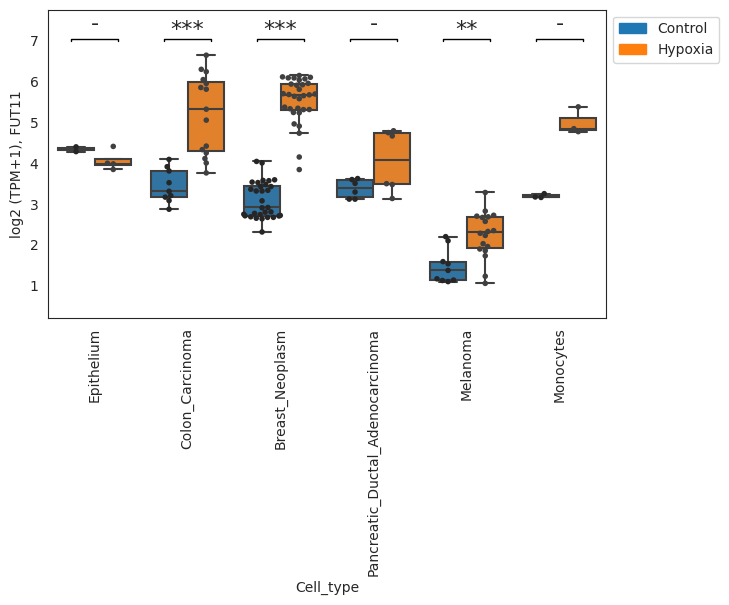

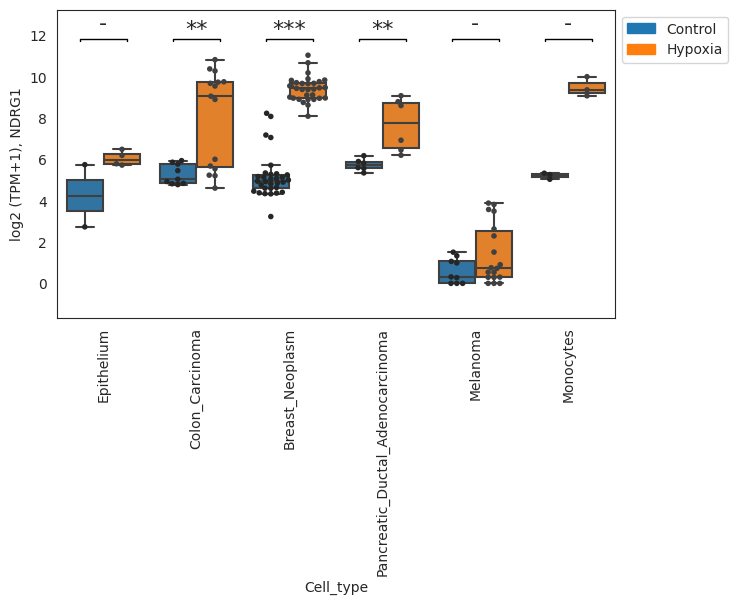

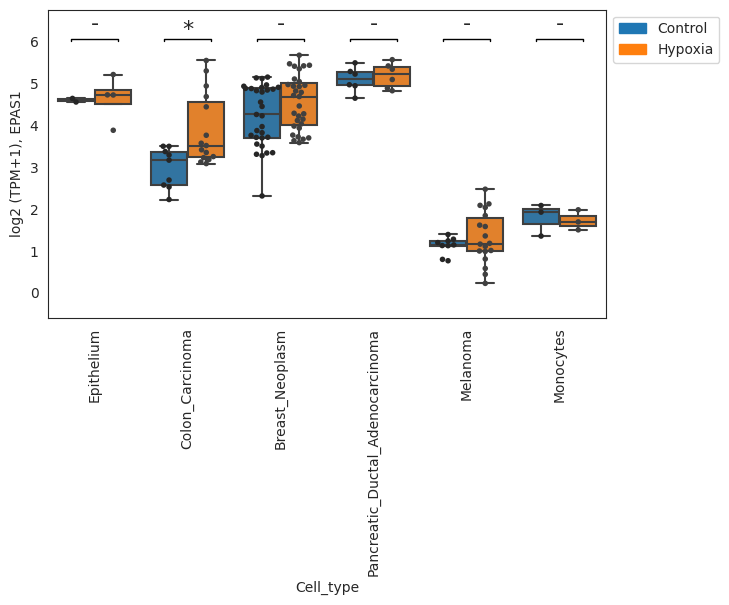

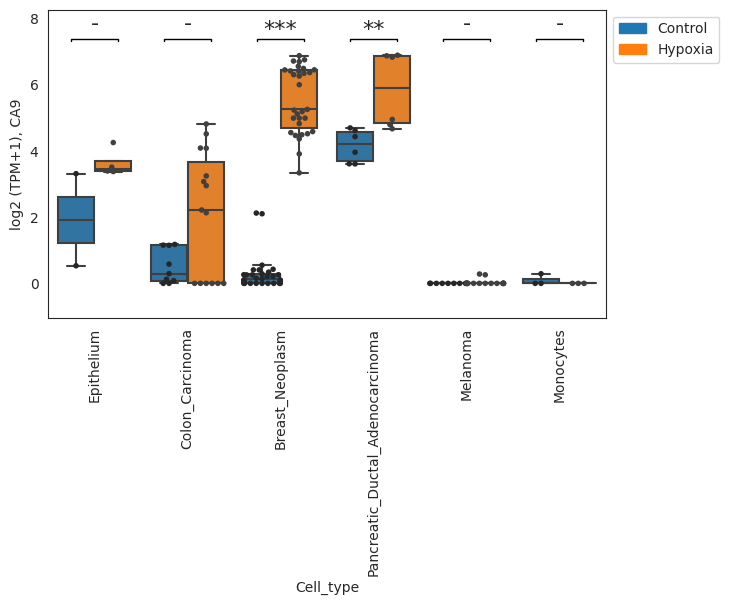

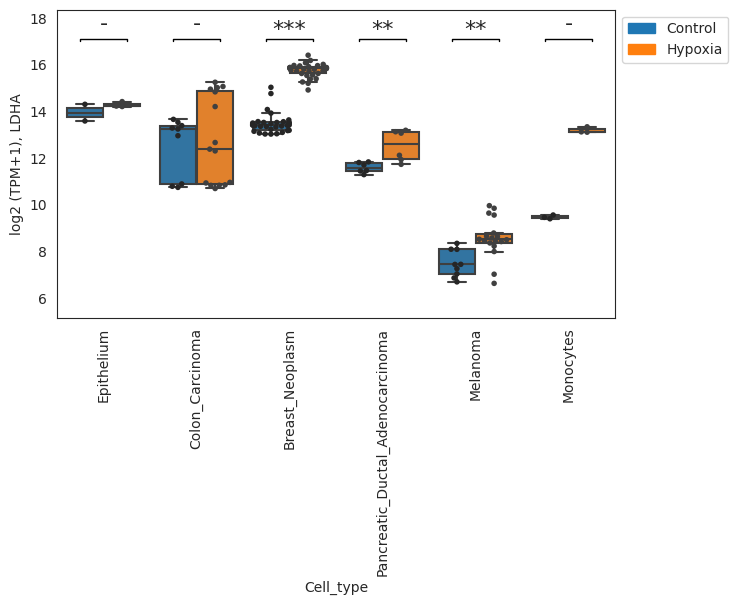

...

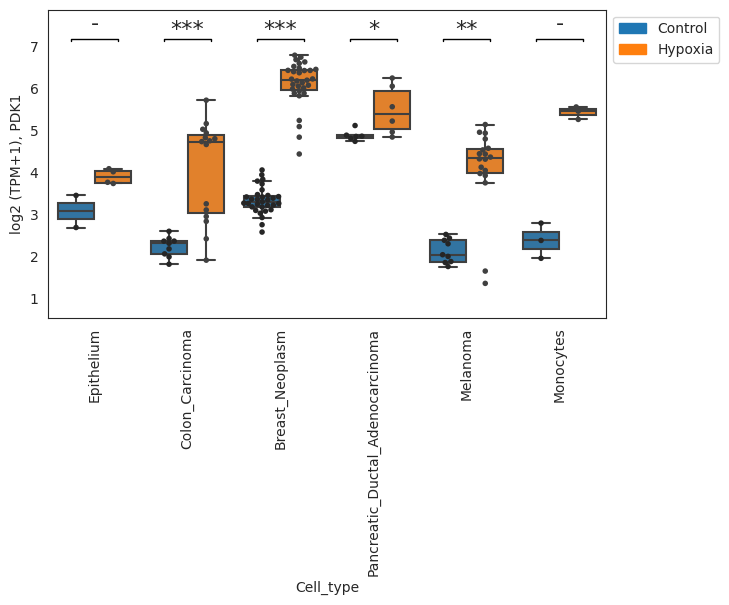

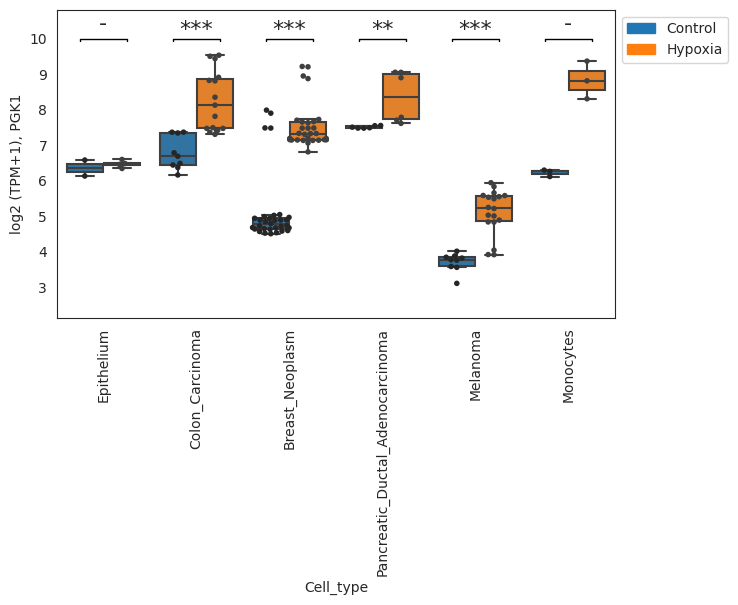

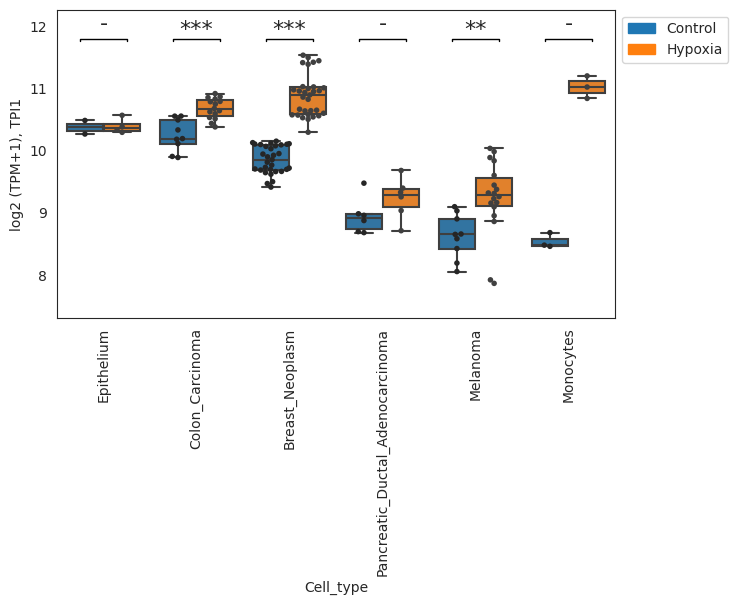

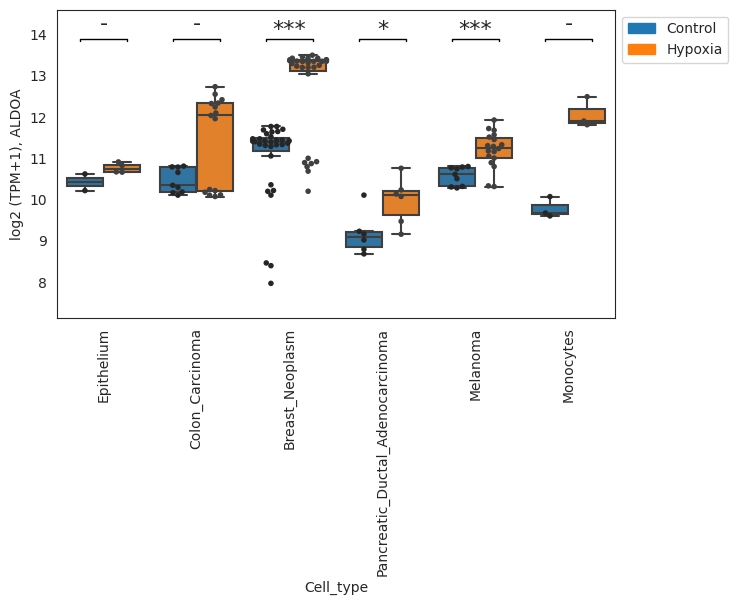

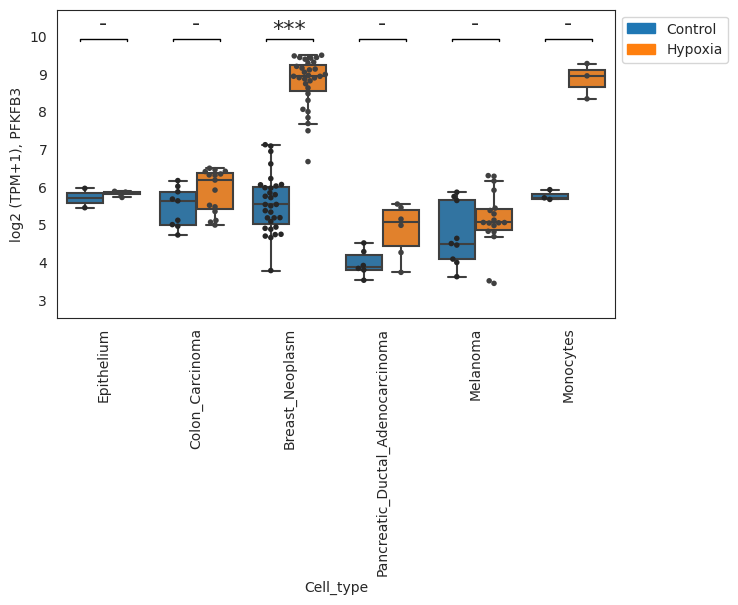

In [ ]:
# boxplots depicting signature genes expression in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

for gene in signature_of_interest:
    grouped_boxplot_with_pvalue(
        hypo_expr.loc[gene],
        annot[annot["Cell_type"].isin(categories)]["Cell_type"],
        order=categories,
        s=4,
        hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
        hue_order=["Control", "Hypoxia"],
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
hypo_cells_ssgsea_unscaled = ssgsea_formula(
    hypo_expr, gmt_genes_alt_names(geneset_of_interest, hypo_expr.index, verbose=False)
).T

In [ ]:
x = annot.groupby("Dataset")

hypo_cells_ssgsea_scaled = {}
for i in x:
    hypo_cells_ssgsea_scaled[i[0]] = median_scale(
        hypo_cells_ssgsea_unscaled.reindex(i[1].index)
    )

hypo_cells_ssgsea_scaled = pd.concat(hypo_cells_ssgsea_scaled.values())

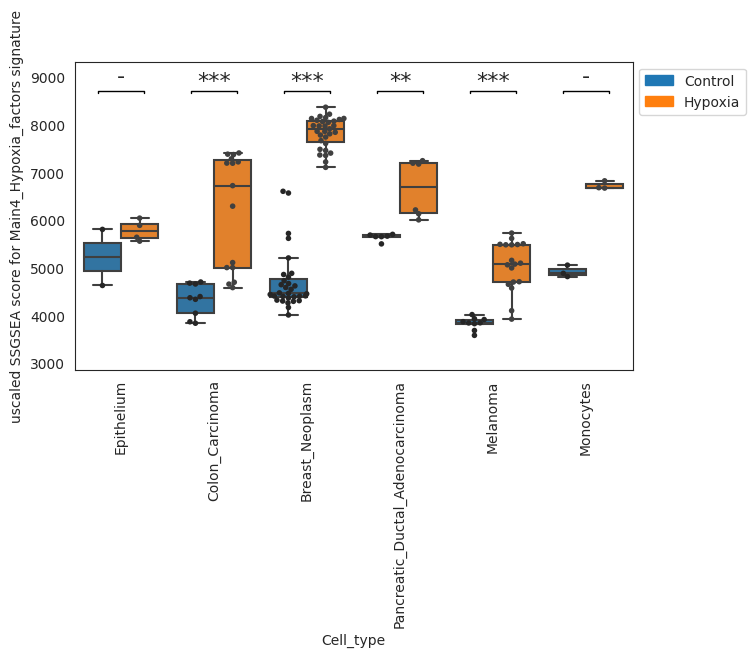

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],
)

plt.xticks(rotation=90)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

Figure 5B

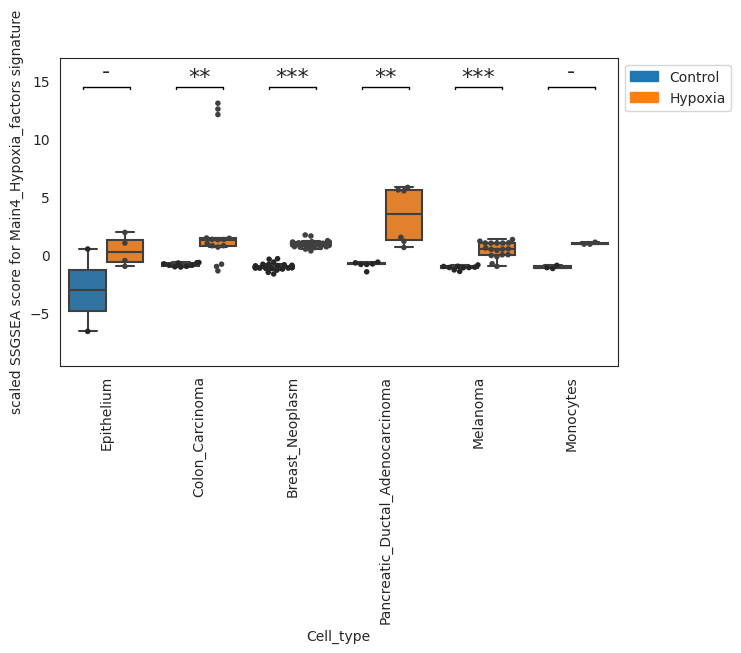

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],  # palette=spalette
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
plt.savefig("/uftp/users/msavchenko/figures/Hypoxia_signature_test.svg", format="svg")

plt.show()

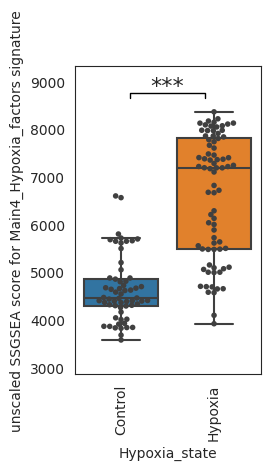

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = ["Control", "Hypoxia"]

boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot[annot["Hypoxia_state"].isin(categories)]["Hypoxia_state"],
    s=4,
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()

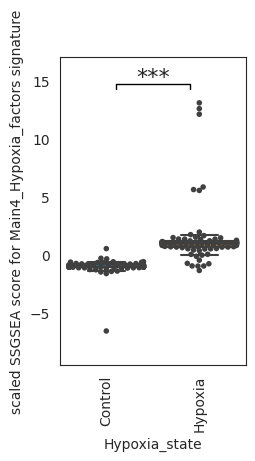

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = ["Control", "Hypoxia"]

boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot[annot["Hypoxia_state"].isin(categories)]["Hypoxia_state"],
    s=4,
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
# plt.savefig("/uftp/users/msavchenko/figures/Hypoxia_signature_test_merged.svg", format="svg")

plt.show()

In [55]:
annot.Dataset.value_counts()

GSE85353     54
GSE95280     27
GSE81513     12
GSE68297     12
GSE139673    12
GSE108833     8
GSE68378      6
GSE162834     6
Name: Dataset, dtype: int64

#### MSigDB signatures

In [ ]:
gmt = read_dataset("genesets_msigdb_hypoxia.gmt")
gmt = {
    j.name: GeneSet(j.name, j.link, set(j[1:].dropna().values))
    for i, j in gmt.iterrows()
}

In [ ]:
df_hypo = ssgsea_formula(
    hypo_expr[annot.index], gmt_genes_alt_names(gmt, hypo_expr.index)
)
df_hypo = df_hypo.T

In [ ]:
x = annot.groupby("Dataset")

df_hypo_scaled = {}
for i in x:
    df_hypo_scaled[i[0]] = median_scale(df_hypo.reindex(i[1].index))

df_hypo_scaled = pd.concat(df_hypo_scaled.values())

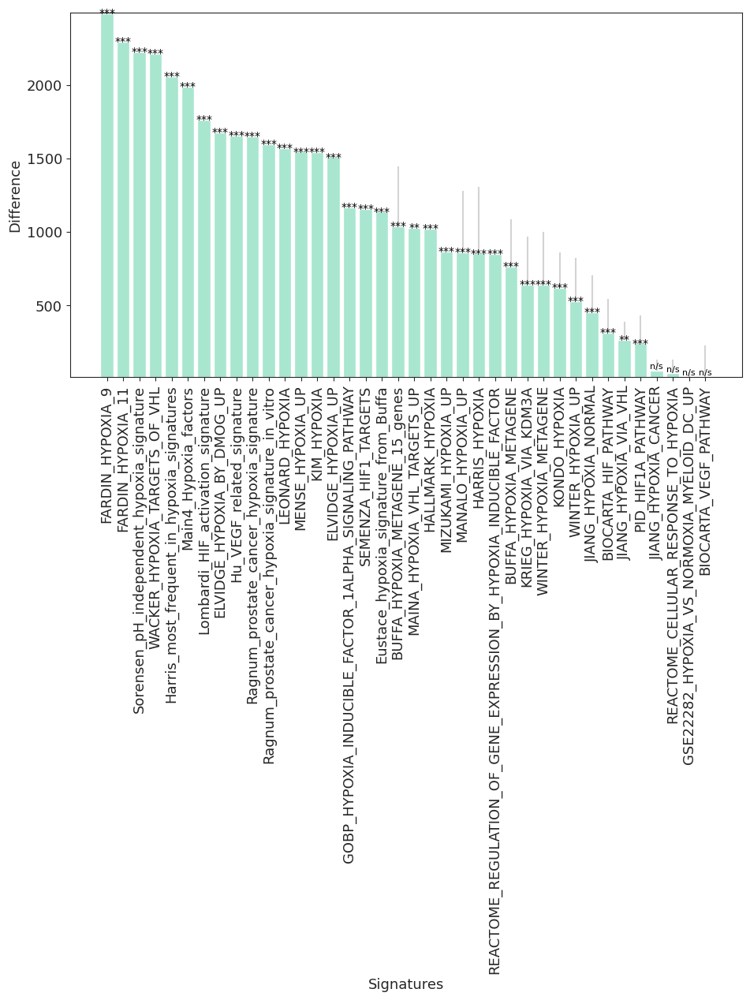

In [ ]:
out, out_stdev, out_mw_corrected = process_generic_dataset(
    df_hypo, annot.Hypoxia_state, annot.Dataset
)
plot_waterfall(
    out, out_mw_corrected, out_stdev, main_column="Hypoxia", save=False
)  # ,path_to_save= 'figures/hypoxia_waterfall_unscaled.svg'

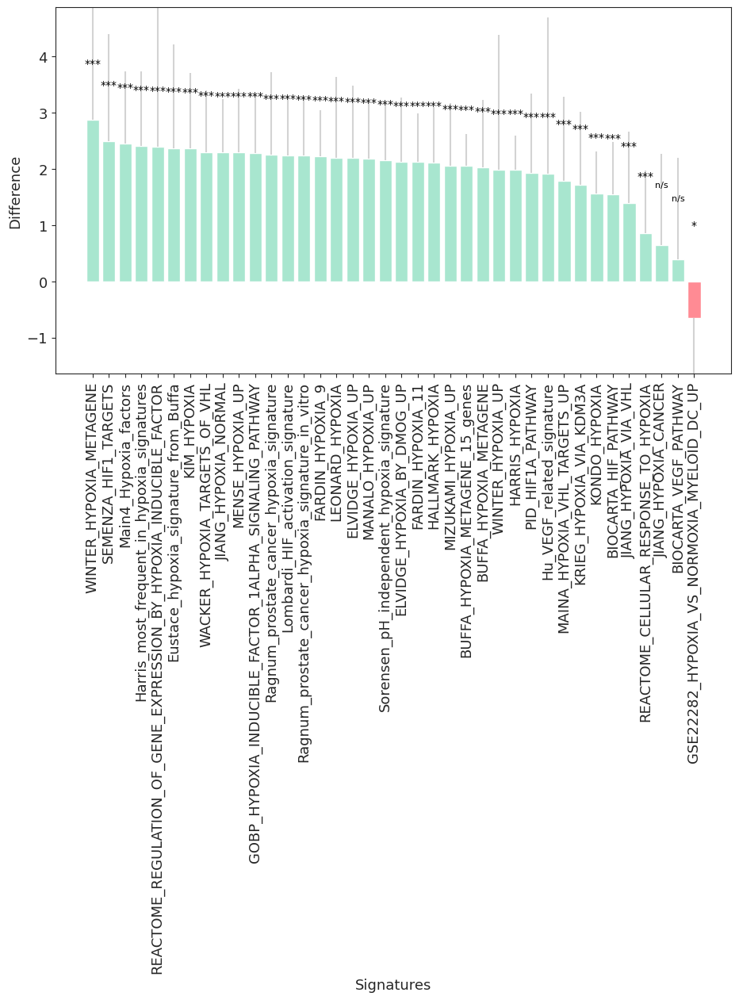

In [ ]:
out, out_stdev, out_mw_corrected = process_generic_dataset(
    df_hypo_scaled, annot.Hypoxia_state, annot.Dataset
)
plot_waterfall(
    out, out_mw_corrected, out_stdev, main_column="Hypoxia", save=False
)  # , path_to_save= 'figures/hypoxia_waterfall_scaled.svg'

Figure 5E

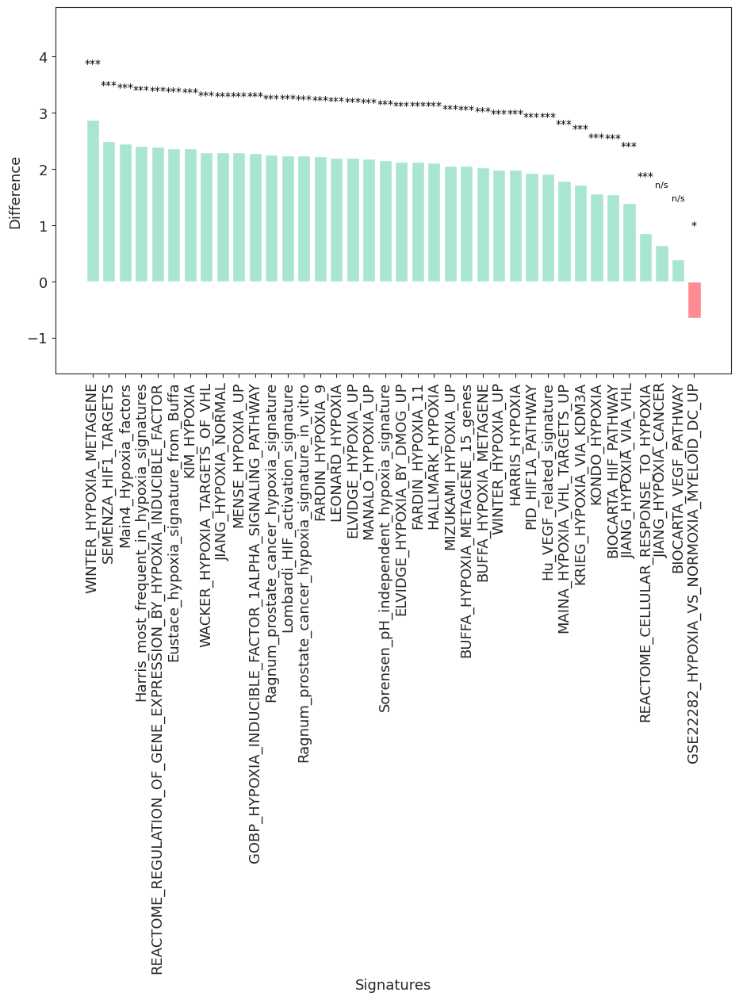

In [ ]:
out, out_stdev, out_mw_corrected = process_generic_dataset(
    df_hypo_scaled, annot.Hypoxia_state, annot.Dataset
)
plot_waterfall(
    out,
    out_mw_corrected,
    out_stdev,
    main_column="Hypoxia",
    errorbar=False,
    path_to_save="/uftp/users/msavchenko/figures/hypoxia_waterfall_scaled_no_error_bars.svg",
)

In [ ]:
out, out_stdev, out_mw_corrected = process_generic_dataset(
    df_hypo_scaled, annot.Hypoxia_state, annot.Dataset
)

In [ ]:
gene_count = pd.DataFrame(columns=["Difference", "n_genes"])
gene_count["Difference"] = out.Hypoxia - out.Control
for i in gmt.keys():
    gene_count["n_genes"][i] = len(gmt[i].genes)

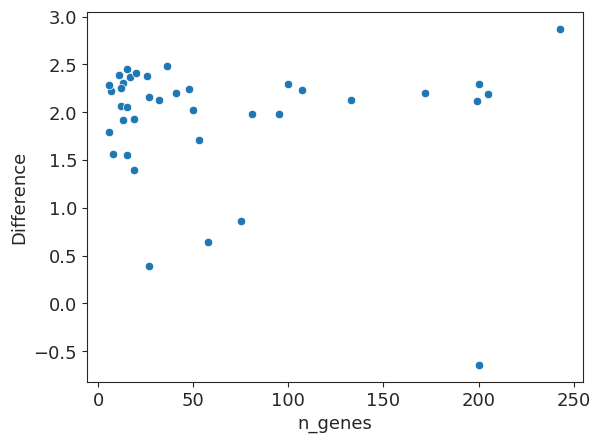

In [ ]:
sns.scatterplot(x="n_genes", y="Difference", data=gene_count)
plt.rcParams["svg.fonttype"] = "none"
# plt.savefig("/uftp/users/msavchenko/figures/Hypoxia_signature_comparison_length.svg", format="svg")
plt.show()

In [ ]:
gene_count["Source"] = ""
gene_count["Source"]["BIOCARTA_HIF_PATHWAY"] = "Pathway"
gene_count["Source"]["BIOCARTA_VEGF_PATHWAY"] = "Pathway"
gene_count["Source"]["BUFFA_HYPOXIA_METAGENE"] = "Multiple_data_in_vitro_and_in_vivo"
gene_count["Source"]["ELVIDGE_HYPOXIA_BY_DMOG_UP"] = "One_cell_line"
gene_count["Source"]["ELVIDGE_HYPOXIA_UP"] = "One_cell_line"
gene_count["Source"]["FARDIN_HYPOXIA_11"] = "Several_lines_of_same_cell_type"
gene_count["Source"]["FARDIN_HYPOXIA_9"] = "Several_lines_of_same_cell_type"
gene_count["Source"][
    "GOBP_HYPOXIA_INDUCIBLE_FACTOR_1ALPHA_SIGNALING_PATHWAY"
] = "Pathway"
gene_count["Source"]["GSE22282_HYPOXIA_VS_NORMOXIA_MYELOID_DC_UP"] = "One_cell_line"
gene_count["Source"]["HARRIS_HYPOXIA"] = "Literature"
gene_count["Source"]["JIANG_HYPOXIA_CANCER"] = "One_cell_line"
gene_count["Source"]["JIANG_HYPOXIA_NORMAL"] = "One_cell_line"
gene_count["Source"]["JIANG_HYPOXIA_VIA_VHL"] = "One_cell_line"
gene_count["Source"]["KIM_HYPOXIA"] = "Several_lines_of_same_cell_type"
gene_count["Source"]["KONDO_HYPOXIA"] = "One_cell_line"
gene_count["Source"]["KRIEG_HYPOXIA_VIA_KDM3A"] = "One_cell_line"
gene_count["Source"]["LEONARD_HYPOXIA"] = "One_cell_line"
gene_count["Source"]["MAINA_HYPOXIA_VHL_TARGETS_UP"] = "One_cell_line"
gene_count["Source"]["MANALO_HYPOXIA_UP"] = "One_cell_line"
gene_count["Source"]["MENSE_HYPOXIA_UP"] = "Several_lines_of_different_cell_types"
gene_count["Source"]["MIZUKAMI_HYPOXIA_UP"] = "One_cell_line"
gene_count["Source"]["PID_HIF1A_PATHWAY"] = "Pathway"
gene_count["Source"]["REACTOME_CELLULAR_RESPONSE_TO_HYPOXIA"] = "Pathway"
gene_count["Source"][
    "REACTOME_REGULATION_OF_GENE_EXPRESSION_BY_HYPOXIA_INDUCIBLE_FACTOR"
] = "Pathway"
gene_count["Source"]["SEMENZA_HIF1_TARGETS"] = "Literature"
gene_count["Source"]["WINTER_HYPOXIA_METAGENE"] = "Literature"
gene_count["Source"]["WINTER_HYPOXIA_UP"] = "Data_in_vitro_and_in_vivo"
gene_count["Source"][
    "WACKER_HYPOXIA_TARGETS_OF_VHL"
] = "Several_lines_of_same_cell_type"
gene_count["Source"]["HALLMARK_HYPOXIA"] = "Hallmark"
gene_count["Source"]["Main4_Hypoxia_factors"] = "BG_signature"
gene_count["Source"][
    "BUFFA_HYPOXIA_METAGENE_15_genes"
] = "Multiple_data_in_vitro_and_in_vivo"
gene_count["Source"][
    "Lombardi_HIF_activation_signature"
] = "Multiple_data_in_vitro_and_in_vivo"
gene_count["Source"]["Hu_VEGF_related_signature"] = "Data_in_vitro_and_in_vivo"
gene_count["Source"][
    "Harris_most_frequent_in_hypoxia_signatures"
] = "Signature_meta-analysis"
gene_count["Source"][
    "Sorensen_pH_independent_hypoxia_signature"
] = "Several_lines_of_different_cell_types"
gene_count["Source"][
    "Ragnum_prostate_cancer_hypoxia_signature"
] = "Data_in_vitro_and_in_vivo"
gene_count["Source"][
    "Ragnum_prostate_cancer_hypoxia_signature_in_vitro"
] = "Several_lines_of_same_cell_type"
gene_count["Source"][
    "Eustace_hypoxia_signature_from_Buffa"
] = "Multiple_data_in_vitro_and_in_vivo"

In [ ]:
gene_count["Difference"]["BIOCARTA_VEGF_PATHWAY"] = 0.5
gene_count["Difference"]["GSE22282_HYPOXIA_VS_NORMOXIA_MYELOID_DC_UP"] = 0.5
gene_count["Difference"]["JIANG_HYPOXIA_CANCER"] = 0.5

Suppl figure 3B

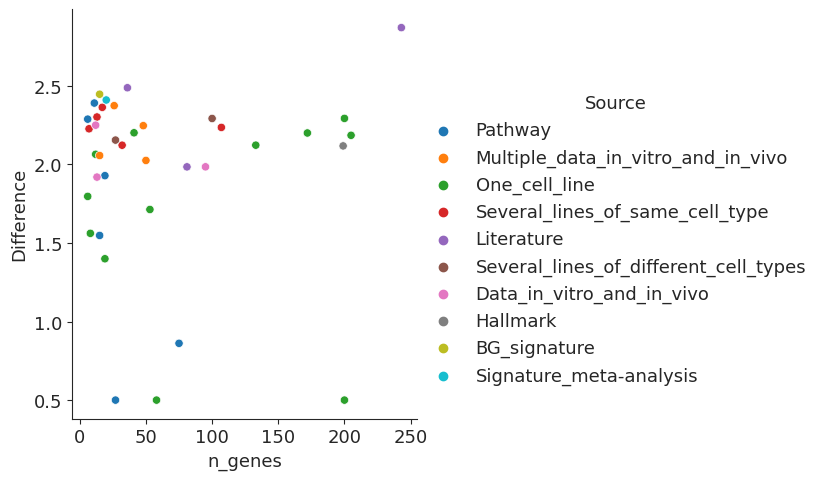

In [ ]:
sns.relplot(
    data=gene_count,
    x="n_genes",
    y="Difference",
    hue="Source",  # size="Difference_unscaled",
)
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Hypoxia_signature_comparison_length_source.svg",
    format="svg",
)
plt.show()

In [ ]:
# out_source, out_stdev_source, out_mw_corrected_source = process_generic_dataset(out, gene_count.Source)
# plot_waterfall(out_source.T, out_mw_corrected_source.T, out_stdev_source.T, main_column='Hypoxia', save=False) #path_to_save= 'figures/hypoxia_waterfall_scaled_source.svg'

<AxesSubplot:xlabel='n_genes', ylabel='Difference'>

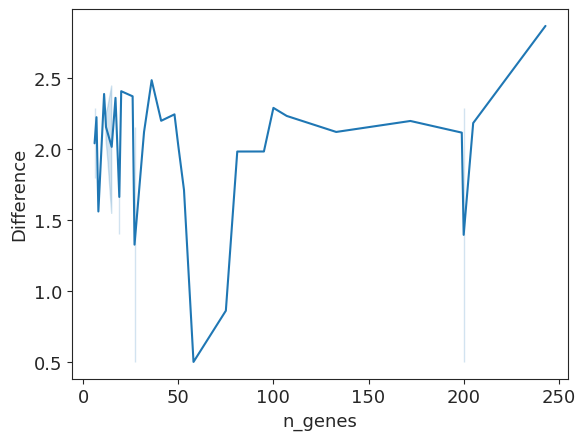

In [80]:
sns.lineplot(x="n_genes", y="Difference", data=gene_count)

In [ ]:
hypo_signatures = {}
for i in gmt.keys():
    df = pd.DataFrame(columns=["ssGSEA", "Hypoxia_state", "Signature"])
    df.ssGSEA = df_hypo_scaled[i]
    df.Hypoxia_state = annot.Hypoxia_state
    df.Signature = i
    df.index = df.index.astype(str) + i
    hypo_signatures[i] = df
hypo_signatures = pd.concat(hypo_signatures.values())
hypo_signatures

,ssGSEA,Hypoxia_state,Signature
SRX3583274BIOCARTA_HIF_PATHWAY,1.020103,Hypoxia,BIOCARTA_HIF_PATHWAY
SRX3583273BIOCARTA_HIF_PATHWAY,2.066163,Hypoxia,BIOCARTA_HIF_PATHWAY
SRX3583270BIOCARTA_HIF_PATHWAY,-0.029369,Hypoxia,BIOCARTA_HIF_PATHWAY
SRX3583269BIOCARTA_HIF_PATHWAY,-0.979897,Hypoxia,BIOCARTA_HIF_PATHWAY
SRX3583268BIOCARTA_HIF_PATHWAY,0.029369,Control,BIOCARTA_HIF_PATHWAY
...,...,...,...
SRX2584143Eustace_hypoxia_signature_from_Buffa,-1.083137,Control,Eustace_hypoxia_signature_from_Buffa
SRX2584144Eustace_hypoxia_signature_from_Buffa,-0.616467,Control,Eustace_hypoxia_signature_from_Buffa
SRX2584145Eustace_hypoxia_signature_from_Buffa,-1.248872,Control,Eustace_hypoxia_signature_from_Buffa
SRX2584146Eustace_hypoxia_signature_from_Buffa,0.905714,Hypoxia,Eustace_hypoxia_signature_from_Buffa


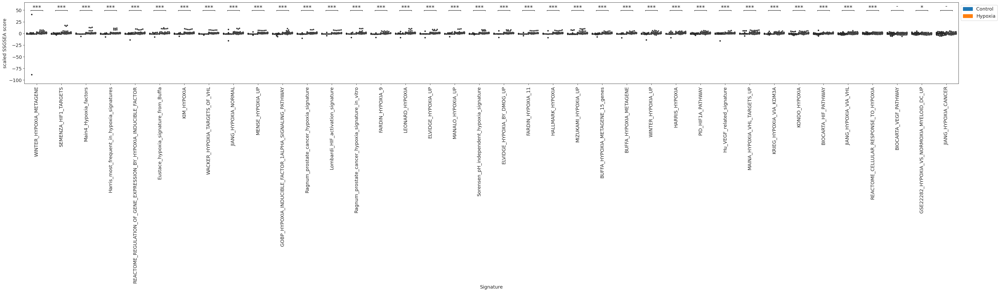

In [ ]:
# boxplot depicting signature SSGSEA score in signatures of interest

categories = gene_count.sort_values("Difference", ascending=False).index

grouped_boxplot_with_pvalue(
    hypo_signatures["ssGSEA"],
    hypo_signatures[hypo_signatures["Signature"].isin(categories)]["Signature"],
    order=categories,
    s=4,
    hue=hypo_signatures[hypo_signatures["Signature"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],
)

plt.xticks(rotation=90)
plt.ylabel("scaled SSGSEA score")
plt.show()

Suppl figure 3K

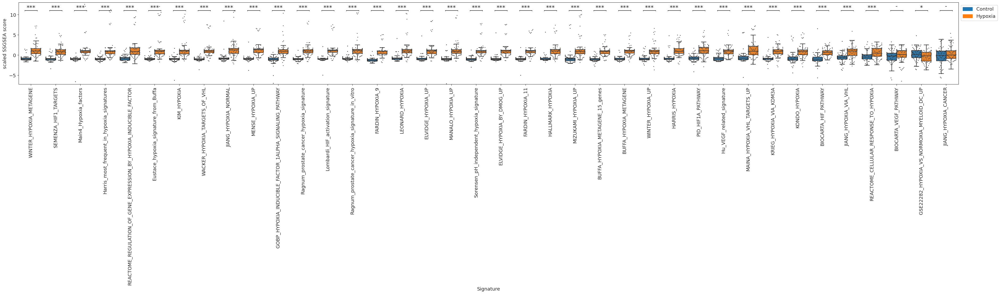

In [ ]:
# boxplot depicting signature SSGSEA score in signatures of interest

categories = gene_count.sort_values("Difference", ascending=False).index

grouped_boxplot_with_pvalue(
    hypo_signatures["ssGSEA"],
    hypo_signatures[hypo_signatures["Signature"].isin(categories)]["Signature"],
    order=categories,
    s=2,
    hue=hypo_signatures[hypo_signatures["Signature"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],
    y_min=-5,
    y_max=10,
)

plt.xticks(rotation=90)
plt.ylabel("scaled SSGSEA score")
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Hypoxia_signature_comparison_grouped.svg",
    format="svg",
)
plt.show()

#### HALLMARK_HYPOXIA

In [ ]:
signature_of_interest = """ADM,ADORA2B,AK4,AKAP12,ALDOA,ALDOB,ALDOC,AMPD3,ANGPTL4,ANKZF1,ANXA2,ATF3,ATP7A,B3GALT6,B4GALNT2,BCAN,BCL2,BGN,BHLHE40,BNIP3L,BRS3,BTG1,CA12,CASP6,CAV1,CCNG2,CCRN4L,CDKN1A,CDKN1B,CDKN1C,CHST2,CHST3,CITED2,COL5A1,CP,CSRP2,CTGF,CXCR4,ACKR3,CYR61,DCN,DDIT3,DDIT4,DPYSL4,DTNA,DUSP1,EDN2,EFNA1,EFNA3,EGFR,ENO1,ENO2,ENO3,ERO1L,ERRFI1,ETS1,EXT1,F3,FAM162A,FBP1,FOS,FOSL2,FOXO3,GAA,GALK1,GAPDH,GAPDHS,GBE1,GCK,GCNT2,GLRX,GPC1,GPC3,GPC4,GPI,GRHPR,GYS1,HAS1,HDLBP,HEXA,HK1,HK2,HMOX1,HOXB9,HS3ST1,HSPA5,IDS,IER3,IGFBP1,IGFBP3,IL6,ILVBL,INHA,IRS2,ISG20,JMJD6,JUN,KDELR3,KDM3A,KIF5A,KLF6,KLF7,KLHL24,LALBA,LARGE,LDHA,LDHC,LOX,LXN,MAFF,MAP3K1,MIF,MT1E,MT2A,MXI1,MYH9,NAGK,NCAN,NDRG1,NDST1,NDST2,NEDD4L,NFIL3,NR3C1,P4HA1,P4HA2,PAM,PCK1,PDGFB,PDK1,PDK3,PFKFB3,PFKL,PFKP,PGAM2,PGF,PGK1,PGM1,PGM2,PHKG1,PIM1,PKLR,PKP1,PLAC8,PLAUR,PLIN2,PNRC1,PPARGC1A,PPFIA4,PPP1R15A,PPP1R3C,PRDX5,PRKCA,PRKCDBP,PTRF,PYGM,RBPJ,RORA,RRAGD,S100A4,SAP30,SCARB1,SDC2,SDC3,SDC4,SELENBP1,SERPINE1,SIAH2,SLC25A1,SLC2A1,SLC2A3,SLC2A5,SLC37A4,SLC6A6,SRPX,STC1,STC2,SULT2B1,TES,TGFB3,TGFBI,TGM2,TIPARP,TKTL1,TMEM45A,TNFAIP3,TPBG,TPD52,TPI1,TPST2,UGP2,VEGFA,VHL,VLDLR,WISP2,WSB1,XPNPEP1,ZFP36,ZNF292""".split(
    ","
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']
# STBD1,
# add here a custon signature name (as a first input)
signature_name = "HALLMARK_HYPOXIA"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
hypo_cells_ssgsea_unscaled = ssgsea_formula(
    hypo_expr, gmt_genes_alt_names(geneset_of_interest, hypo_expr.index, verbose=False)
).T

In [ ]:
x = hypo_annot.groupby("Dataset")

hypo_cells_ssgsea_scaled = {}
for i in x:
    hypo_cells_ssgsea_scaled[i[0]] = median_scale(
        hypo_cells_ssgsea_unscaled.reindex(i[1].index)
    )

hypo_cells_ssgsea_scaled = pd.concat(hypo_cells_ssgsea_scaled.values())

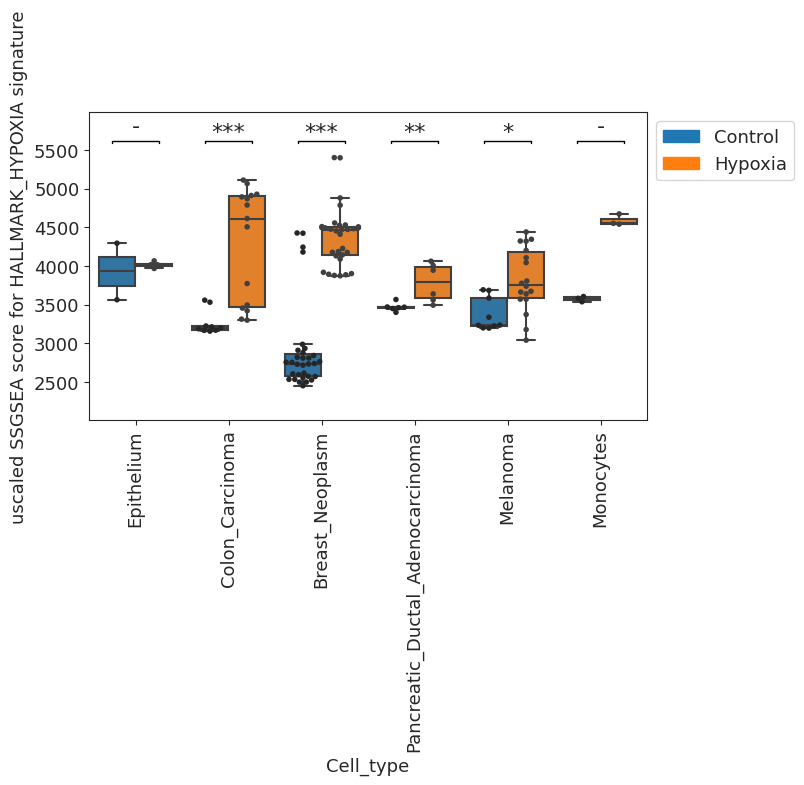

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],
)

plt.xticks(rotation=90)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

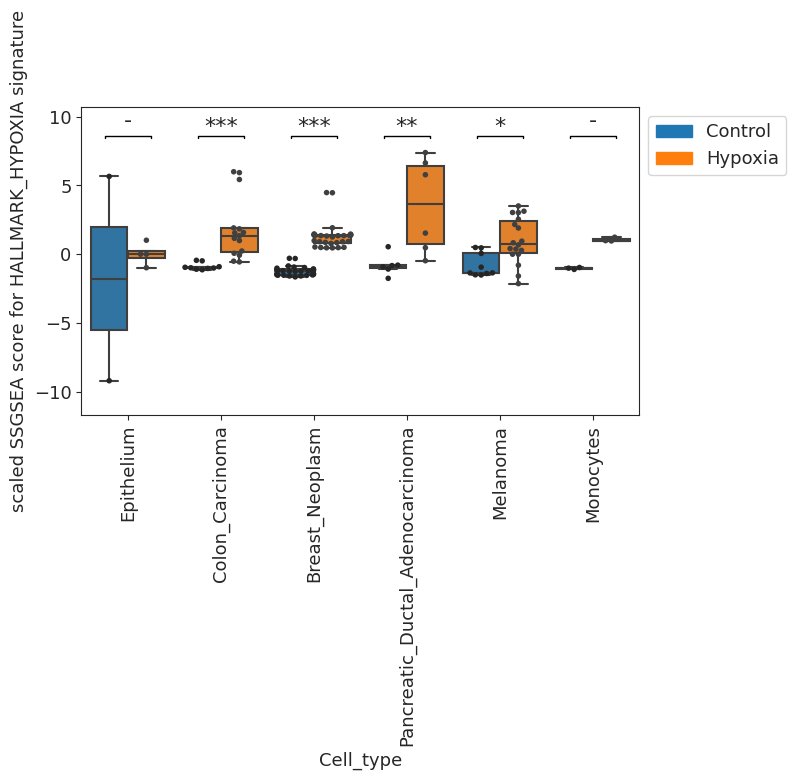

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],  # palette=spalette
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

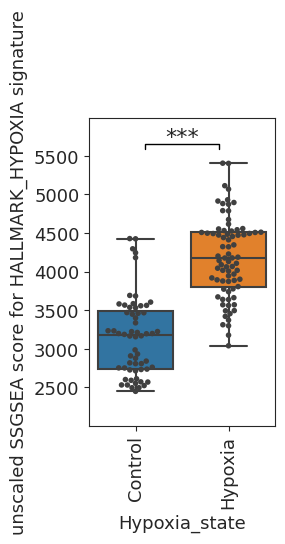

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = ["Control", "Hypoxia"]

boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot[annot["Hypoxia_state"].isin(categories)]["Hypoxia_state"],
    s=4,
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()

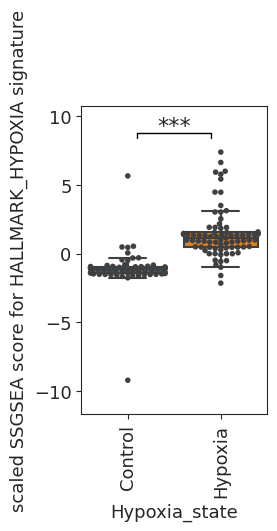

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = ["Control", "Hypoxia"]

boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot[annot["Hypoxia_state"].isin(categories)]["Hypoxia_state"],
    s=4,
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

#### WINTER_HYPOXIA_METAGENE

In [ ]:
signature_of_interest = """ABCB1	ACAT1	ADM	ADORA2B	AK2	AK3	ALDH1A1	ALDH1A3	ALDOA	ALDOC	ANGPT2	ANGPTL4	ANXA1	ANXA2	ANXA5	ARHGAP5	ARSL	ART1	BACE2	BATF3	BCL2L1	BCL2L2	BHLHE40	BHLHE41	BIK	BIRC2	BNIP3	BNIP3L	BPI	BTG1	CA12	CA9	CALD1	CCNG2	CCT6A	CD99	CDK1	CDKN1A	CDKN1B	CITED2	CLK1	CNOT7	COL4A5	COL5A1	COL5A2	COL5A3	CP	CTSD	CXCL8	CXCR4	DDIT3	DDIT4	DELEC1	DKC1	DR1	EDN1	EDN2	EFNA1	EGF	EGR1	EIF4A3	ELF3	ELL2	ENG	ENO1	ENO3	ENPEP	EPO	ERRFI1	ETS1	F3	FABP5	FGF3	FKBP4	FLT1	FN1	FOS	FTL	GAPDH	GBE1	GLRX	GPI	HAP1	HBP1	HDAC1	HDAC9	HERC3	HERPUD1	HGF	HIF1A	HILPDA	HK1	HK2	HLA-DQB1	HMOX1	HMOX2	HSP90B1	HSPA5	HSPD1	HSPH1	HYOU1	ICAM1	ID2	IFI27	IGF2	IGFBP1	IGFBP2	IGFBP3	IGFBP5	IL6	INSIG1	IRF6	ITGA5	JUN	KDR	KRT14	KRT18	KRT19	LDHA	LDHB	LEP	LGALS1	LONP1	LOX	LRP1	MAP4	MET	MIF	MMP13	MMP2	MMP7	MPI	MT-CO1	MT-CO2	MT1L	MTL3P	MUC1	MXI1	NDRG1	NFIL3	NFKB1	NFKB2	NOS1	NOS2	NOS2P1	NOS2P2	NOS3	NR3C1	NR4A1	NSG1	NT5E	ODC1	P4HA1	P4HA2	PAICS	PDGFB	PDK3	PFKFB1	PFKFB3	PFKFB4	PFKL	PGAM1	PGF	PGK1	PGK2	PGM1	PIM1	PIM2	PKM	PLAU	PLAUR	PLIN2	PLOD2	PNN	PNP	POLM	PPARA	PPAT	PROK1	PSMA3	PSMD9	PTGS1	PTGS2	QSOX1	RBPJ	RELA	RIOK3	RNASEL	RPL36A	RRP9	SAT1	SERPINB2	SERPINE1	SGSM2	SIAH2	SIN3A	SIRPA	SLC16A1	SLC16A2	SLC20A1	SLC2A1	SLC2A3	SLC3A2	SLC6A10P	SLC6A16	SLC6A6	SLC6A8	SORL1	SPP1	SRSF6	STC2	SYT7	TBPL1	TCEAL1	TEK	TF	TFF3	TFRC	TGFA	TGFB1	TGFB3	TGFBI	TGM2	TH	THBS1	THBS2	TIMM17A	TNFAIP3	TP53	TPBG	TPD52	TPI1	TXN	TXNIP	UMPS	VEGFA	VEGFB	VEGFC	VIM	VPS11	VPS51	XRCC6	ZNRD2""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']
# STBD1,
# add here a custon signature name (as a first input)
signature_name = "WINTER_HYPOXIA_METAGENE"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
hypo_cells_ssgsea_unscaled = ssgsea_formula(
    hypo_expr, gmt_genes_alt_names(geneset_of_interest, hypo_expr.index, verbose=False)
).T

In [ ]:
x = hypo_annot.groupby("Dataset")

hypo_cells_ssgsea_scaled = {}
for i in x:
    hypo_cells_ssgsea_scaled[i[0]] = median_scale(
        hypo_cells_ssgsea_unscaled.reindex(i[1].index)
    )

hypo_cells_ssgsea_scaled = pd.concat(hypo_cells_ssgsea_scaled.values())

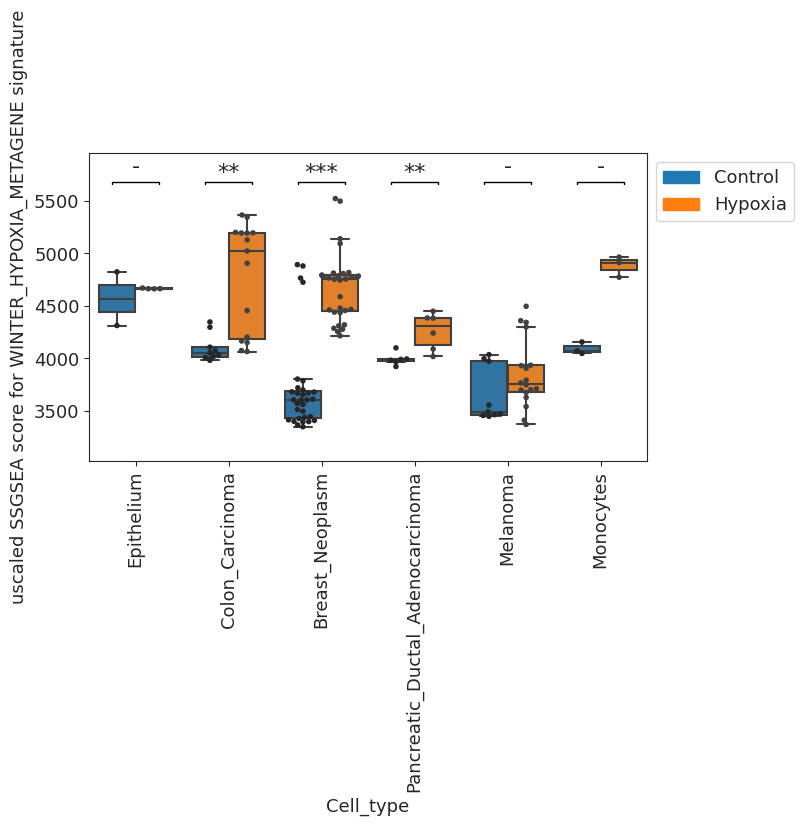

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],
)

plt.xticks(rotation=90)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

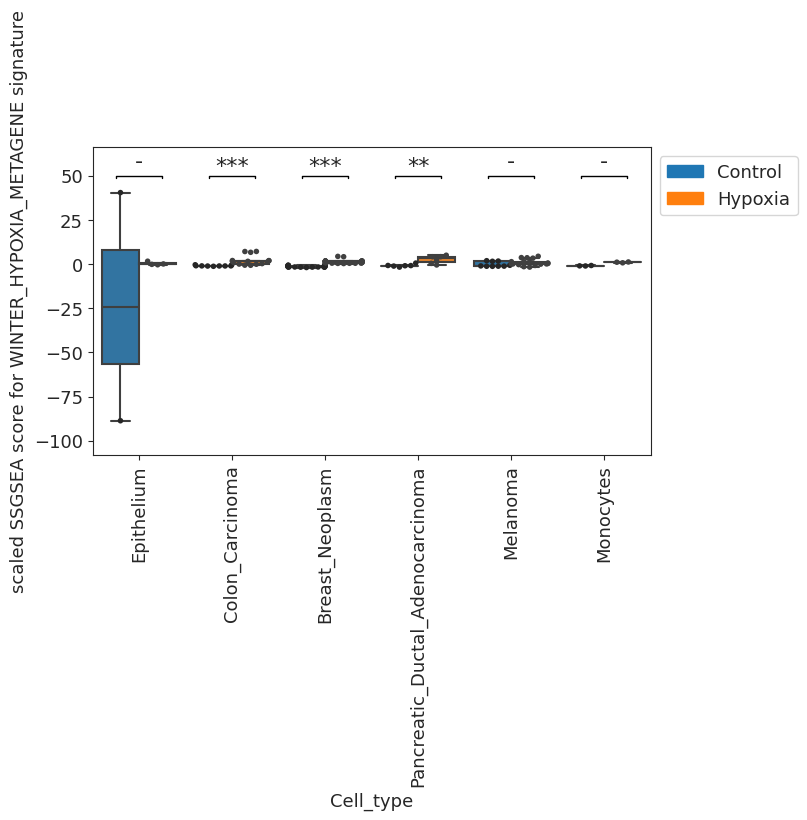

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],  # palette=spalette
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

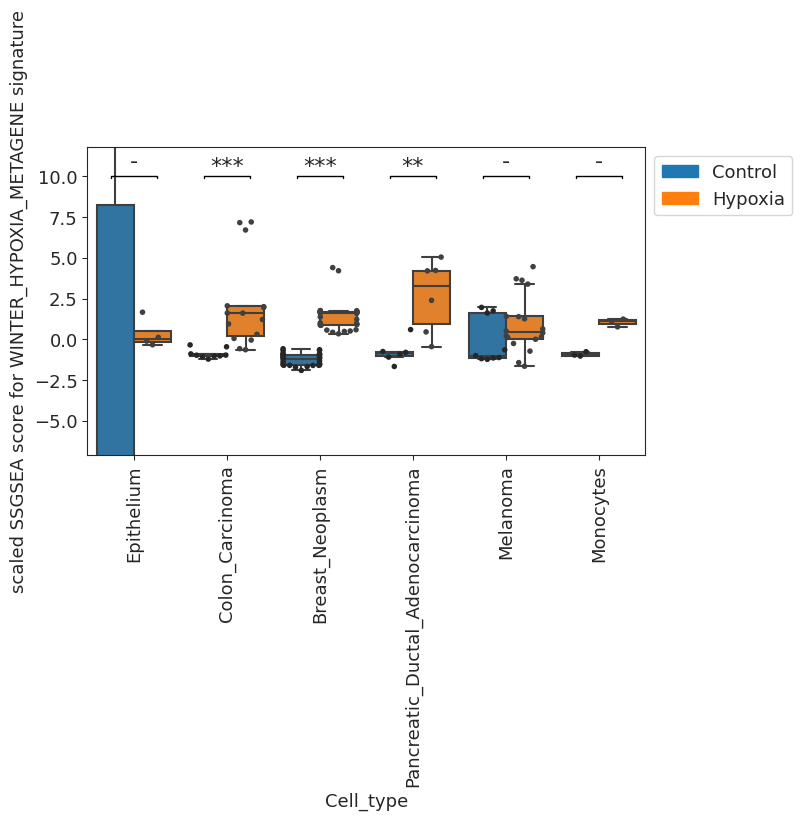

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],
    y_min=-5,
    y_max=9,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

#### Harris_most_frequent_in_hypoxia_signatures

In [ ]:
signature_of_interest = """BNIP3	F3	LOX	TNF	TH	SLC2A1	PGK1	NDRG1	GAL	BNIP3L	ANG	P4HA1	ADM	AK3	PDK1	ERO1L	ALDOC	PLOD2	P4HA2	MXI1""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']
# STBD1,
# add here a custon signature name (as a first input)
signature_name = "Harris_most_frequent_in_hypoxia_signatures"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
hypo_cells_ssgsea_unscaled = ssgsea_formula(
    hypo_expr, gmt_genes_alt_names(geneset_of_interest, hypo_expr.index, verbose=False)
).T

In [ ]:
x = hypo_annot.groupby("Dataset")

hypo_cells_ssgsea_scaled = {}
for i in x:
    hypo_cells_ssgsea_scaled[i[0]] = median_scale(
        hypo_cells_ssgsea_unscaled.reindex(i[1].index)
    )

hypo_cells_ssgsea_scaled = pd.concat(hypo_cells_ssgsea_scaled.values())

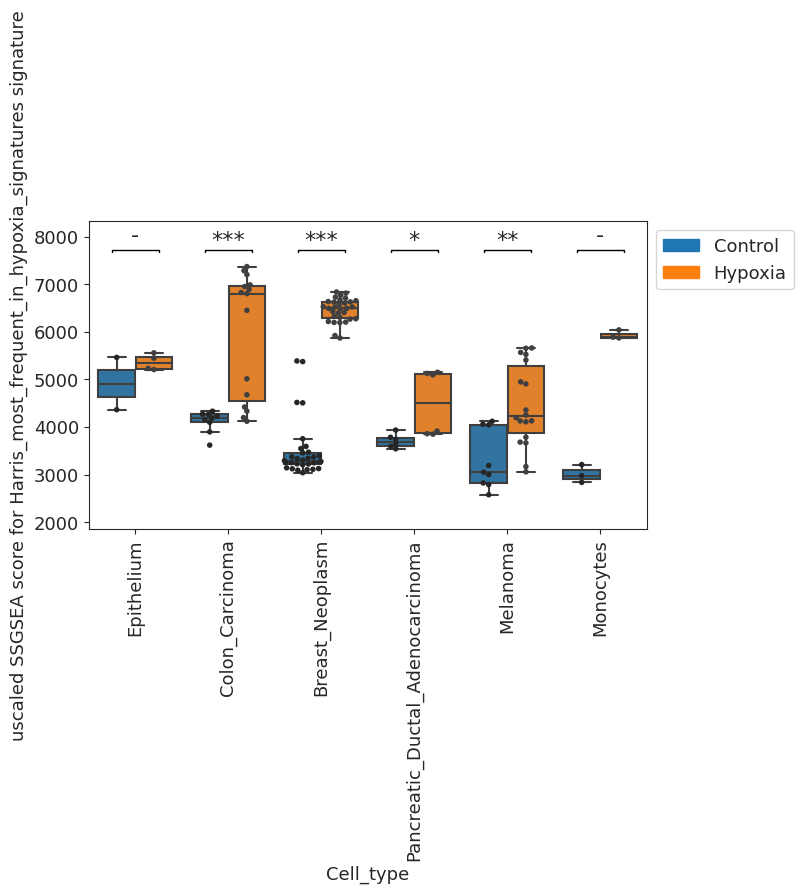

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],
)

plt.xticks(rotation=90)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

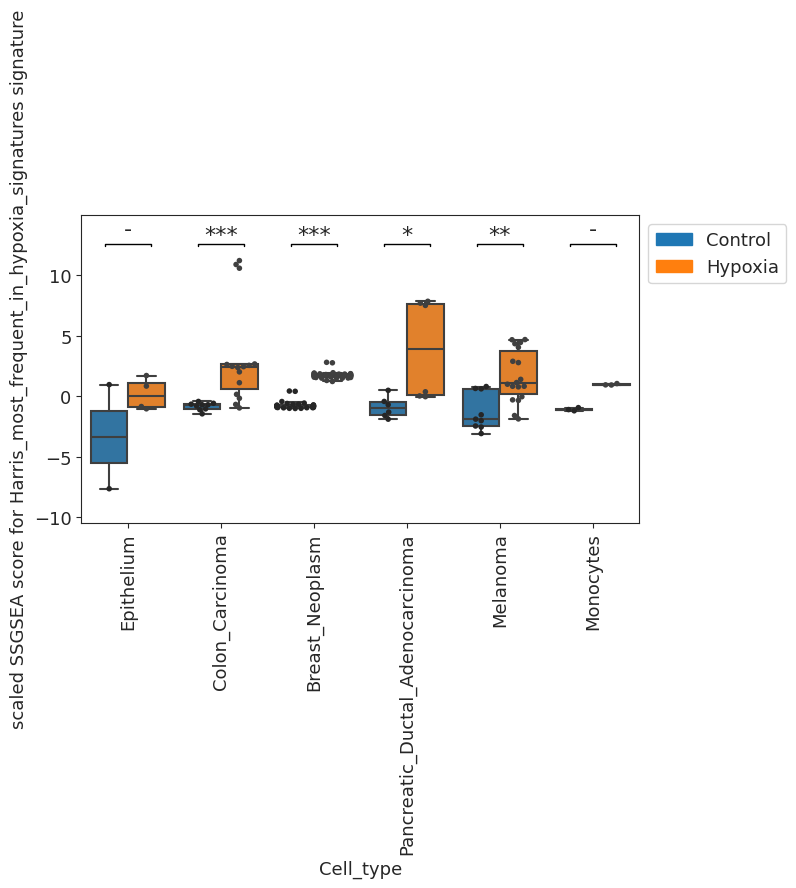

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],  # palette=spalette
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

#### Eustace

In [ ]:
signature_of_interest = """ALDOA	ANGPTL4	ANLN	BNC1	C20orf20	CA9	CDKN3	COL4A6	DCBLD1	ENO1	FAM83B	FOSL1	GNAI1	HIG2	KCTD11	KRT17	LDHA	MPRS17	P4HA1	PGAM1	PGK1	SDC1	SLC16A1	SLC2A1	TPI1	VEGFA""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']
# STBD1,
# add here a custon signature name (as a first input)
signature_name = "Eustace_hypoxia_signature_from_Buffa"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
hypo_cells_ssgsea_unscaled = ssgsea_formula(
    hypo_expr, gmt_genes_alt_names(geneset_of_interest, hypo_expr.index, verbose=False)
).T

In [ ]:
x = hypo_annot.groupby("Dataset")

hypo_cells_ssgsea_scaled = {}
for i in x:
    hypo_cells_ssgsea_scaled[i[0]] = median_scale(
        hypo_cells_ssgsea_unscaled.reindex(i[1].index)
    )

hypo_cells_ssgsea_scaled = pd.concat(hypo_cells_ssgsea_scaled.values())

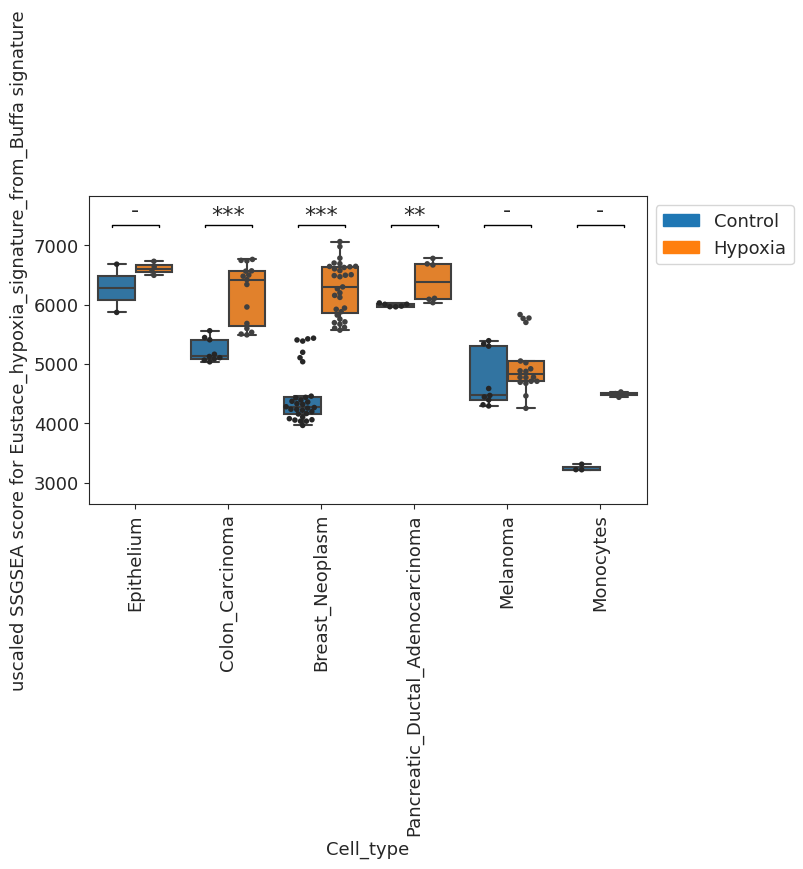

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],
)

plt.xticks(rotation=90)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

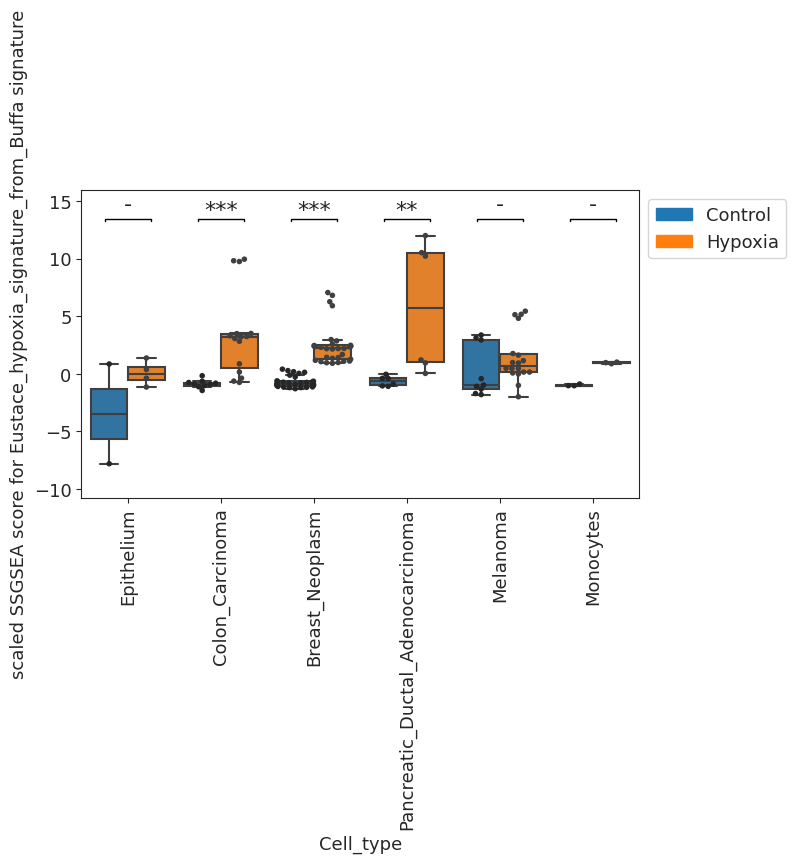

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot[annot["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],  # palette=spalette
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

### HIF modified samples

In [ ]:
# define celltypes of interest
categories = [
    "Epithelium",
    "Colon_Carcinoma",
    "Breast_Neoplasm",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Melanoma",
    "Monocytes",
]

# dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat([annot, hypo_annot.loc[hypo_annot["Cell_type"].isin([i])]])

# for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(
    annot["Cell_type"], categories=categories, ordered=True
)
annot = annot.sort_values("Cell_type")

In [ ]:
annot_ko = annot[annot.HIF_modification == "TRUE"]
annot_ko.Hypoxia_state.value_counts()

Hypoxia    23
Control    19
Name: Hypoxia_state, dtype: int64

In [ ]:
signature_of_interest = """FUT11	NDRG1	EPAS1	CA9	LDHA	LOX	SLC2A1	P4HA1	CA12	HK2	PDK1	PGK1	TPI1	ALDOA	PFKFB3""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']

# add here a custon signature name (as a first input)
signature_name = "Main4_Hypoxia_factors"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

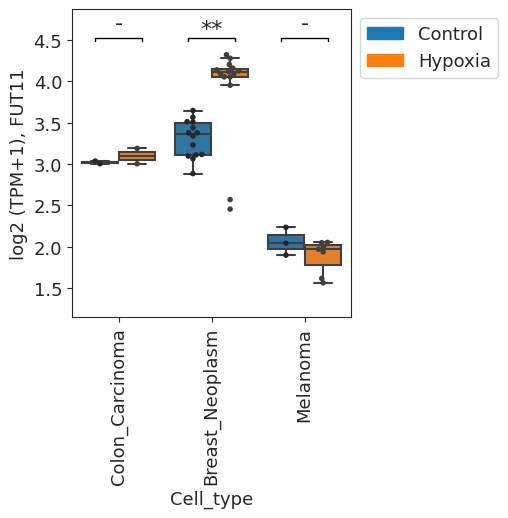

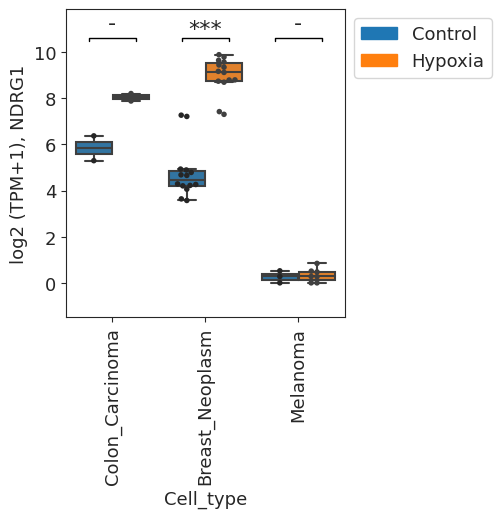

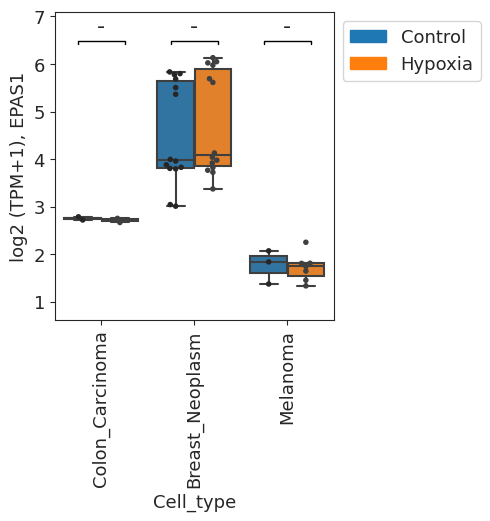

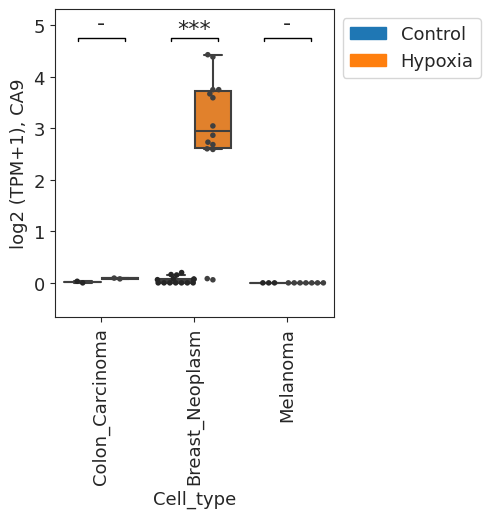

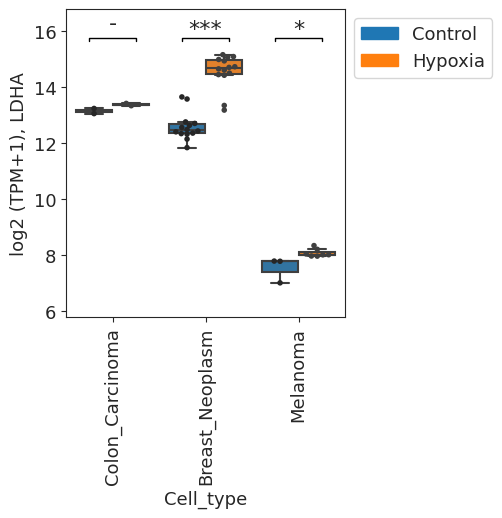

...

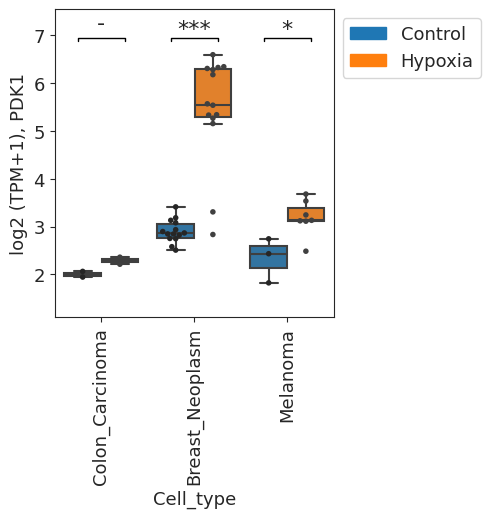

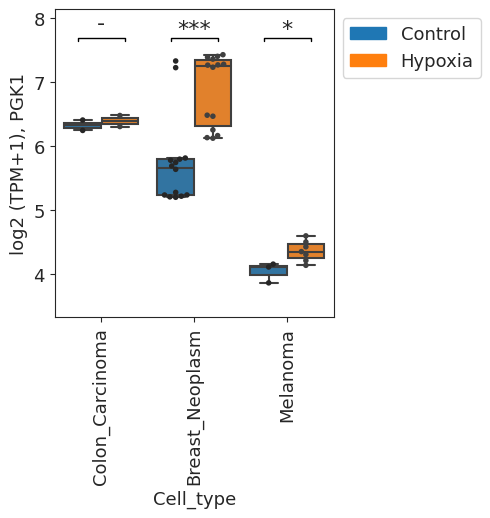

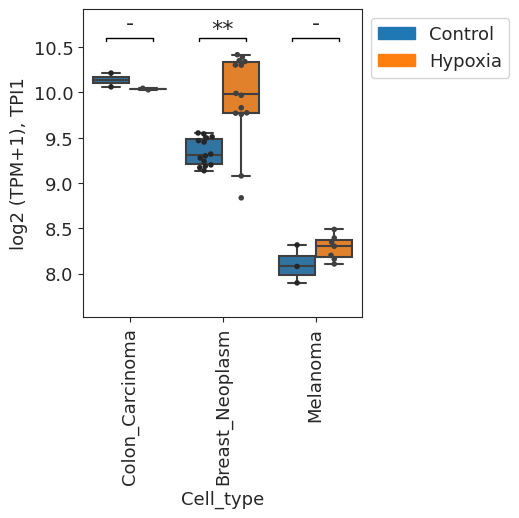

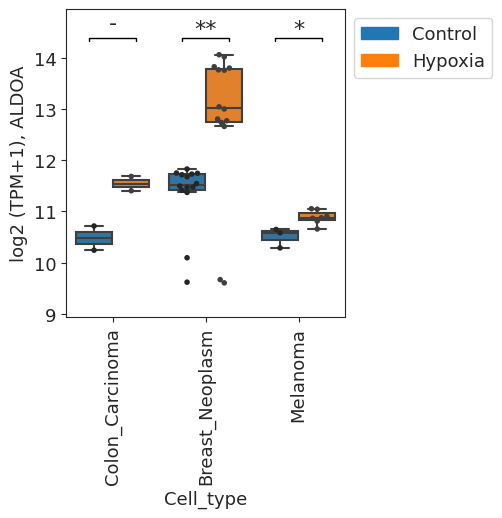

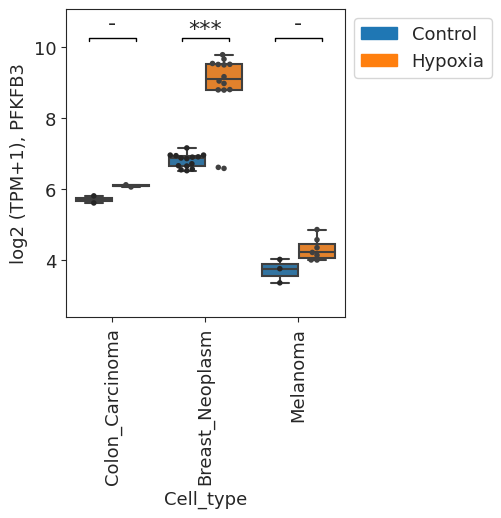

In [ ]:
# boxplots depicting signature genes expression in celltypes of interest

categories = ["Colon_Carcinoma", "Breast_Neoplasm", "Melanoma"]

for gene in signature_of_interest:
    grouped_boxplot_with_pvalue(
        hypo_expr.loc[gene],
        annot_ko[annot_ko["Cell_type"].isin(categories)]["Cell_type"],
        order=categories,
        s=4,
        hue=annot_ko[annot_ko["Cell_type"].isin(categories)]["Hypoxia_state"],
        hue_order=["Control", "Hypoxia"],
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
hypo_cells_ssgsea_unscaled = ssgsea_formula(
    hypo_expr, gmt_genes_alt_names(geneset_of_interest, hypo_expr.index, verbose=False)
).T

In [ ]:
x = annot_ko.groupby("Dataset")

hypo_cells_ssgsea_scaled = {}
for i in x:
    hypo_cells_ssgsea_scaled[i[0]] = median_scale(
        hypo_cells_ssgsea_unscaled.reindex(i[1].index)
    )

hypo_cells_ssgsea_scaled = pd.concat(hypo_cells_ssgsea_scaled.values())

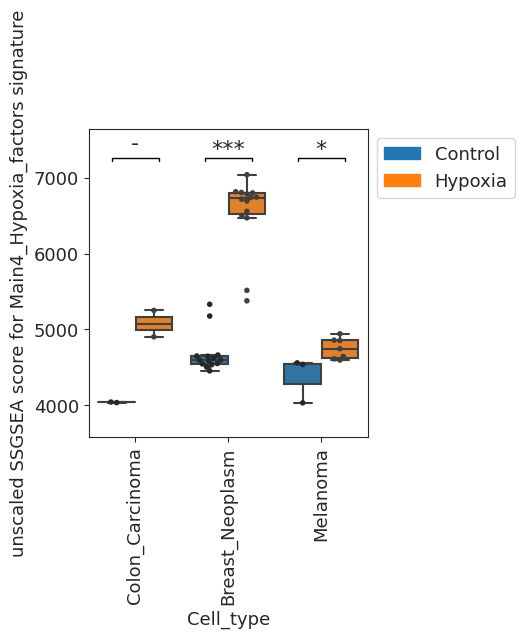

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Colon_Carcinoma", "Breast_Neoplasm", "Melanoma"]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot_ko[annot_ko["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_ko[annot_ko["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()

Figure 5B

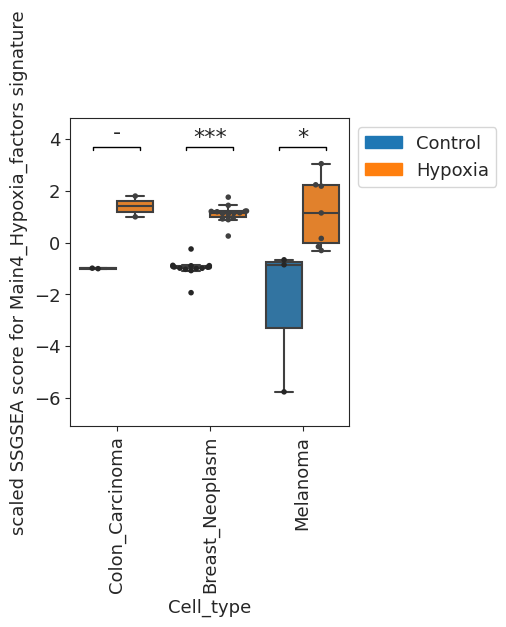

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Colon_Carcinoma", "Breast_Neoplasm", "Melanoma"]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot_ko[annot_ko["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_ko[annot_ko["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],  # palette=spalette
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Hypoxia_signature_test_HIF_modified.svg",
    format="svg",
)

plt.show()

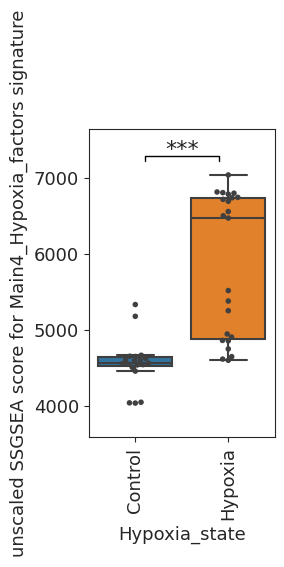

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = ["Control", "Hypoxia"]

boxplot_with_pvalue(
    hypo_cells_ssgsea_unscaled[signature_name],
    annot_ko[annot_ko["Hypoxia_state"].isin(categories)]["Hypoxia_state"],
    s=4,
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()

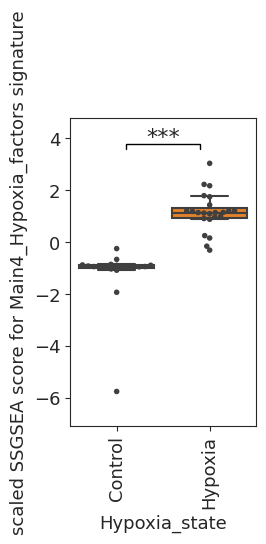

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = ["Control", "Hypoxia"]

boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot_ko[annot_ko["Hypoxia_state"].isin(categories)]["Hypoxia_state"],
    s=4,
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
# plt.savefig("/uftp/users/msavchenko/figures/Hypoxia_signature_test_HIF_modified_merged.svg", format="svg")

plt.show()

In [ ]:
signature_of_interest = """ADM,ADORA2B,AK4,AKAP12,ALDOA,ALDOB,ALDOC,AMPD3,ANGPTL4,ANKZF1,ANXA2,ATF3,ATP7A,B3GALT6,B4GALNT2,BCAN,BCL2,BGN,BHLHE40,BNIP3L,BRS3,BTG1,CA12,CASP6,CAV1,CCNG2,CCRN4L,CDKN1A,CDKN1B,CDKN1C,CHST2,CHST3,CITED2,COL5A1,CP,CSRP2,CTGF,CXCR4,ACKR3,CYR61,DCN,DDIT3,DDIT4,DPYSL4,DTNA,DUSP1,EDN2,EFNA1,EFNA3,EGFR,ENO1,ENO2,ENO3,ERO1L,ERRFI1,ETS1,EXT1,F3,FAM162A,FBP1,FOS,FOSL2,FOXO3,GAA,GALK1,GAPDH,GAPDHS,GBE1,GCK,GCNT2,GLRX,GPC1,GPC3,GPC4,GPI,GRHPR,GYS1,HAS1,HDLBP,HEXA,HK1,HK2,HMOX1,HOXB9,HS3ST1,HSPA5,IDS,IER3,IGFBP1,IGFBP3,IL6,ILVBL,INHA,IRS2,ISG20,JMJD6,JUN,KDELR3,KDM3A,KIF5A,KLF6,KLF7,KLHL24,LALBA,LARGE,LDHA,LDHC,LOX,LXN,MAFF,MAP3K1,MIF,MT1E,MT2A,MXI1,MYH9,NAGK,NCAN,NDRG1,NDST1,NDST2,NEDD4L,NFIL3,NR3C1,P4HA1,P4HA2,PAM,PCK1,PDGFB,PDK1,PDK3,PFKFB3,PFKL,PFKP,PGAM2,PGF,PGK1,PGM1,PGM2,PHKG1,PIM1,PKLR,PKP1,PLAC8,PLAUR,PLIN2,PNRC1,PPARGC1A,PPFIA4,PPP1R15A,PPP1R3C,PRDX5,PRKCA,PRKCDBP,PTRF,PYGM,RBPJ,RORA,RRAGD,S100A4,SAP30,SCARB1,SDC2,SDC3,SDC4,SELENBP1,SERPINE1,SIAH2,SLC25A1,SLC2A1,SLC2A3,SLC2A5,SLC37A4,SLC6A6,SRPX,STC1,STC2,SULT2B1,TES,TGFB3,TGFBI,TGM2,TIPARP,TKTL1,TMEM45A,TNFAIP3,TPBG,TPD52,TPI1,TPST2,UGP2,VEGFA,VHL,VLDLR,WISP2,WSB1,XPNPEP1,ZFP36,ZNF292""".split(
    ","
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']
# STBD1,
# add here a custon signature name (as a first input)
signature_name = "HALLMARK_HYPOXIA"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
hypo_cells_ssgsea_unscaled = ssgsea_formula(
    hypo_expr, gmt_genes_alt_names(geneset_of_interest, hypo_expr.index, verbose=False)
).T

x = annot_ko.groupby("Dataset")
hypo_cells_ssgsea_scaled = {}
for i in x:
    hypo_cells_ssgsea_scaled[i[0]] = median_scale(
        hypo_cells_ssgsea_unscaled.reindex(i[1].index)
    )
hypo_cells_ssgsea_scaled = pd.concat(hypo_cells_ssgsea_scaled.values())

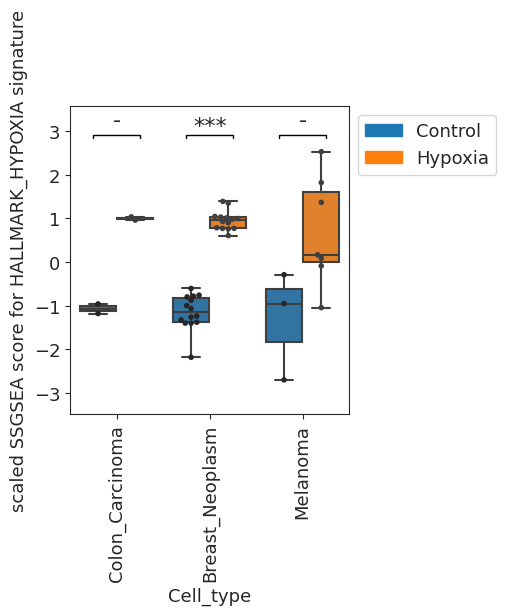

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Colon_Carcinoma", "Breast_Neoplasm", "Melanoma"]

grouped_boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot_ko[annot_ko["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_ko[annot_ko["Cell_type"].isin(categories)]["Hypoxia_state"],
    hue_order=["Control", "Hypoxia"],  # palette=spalette
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

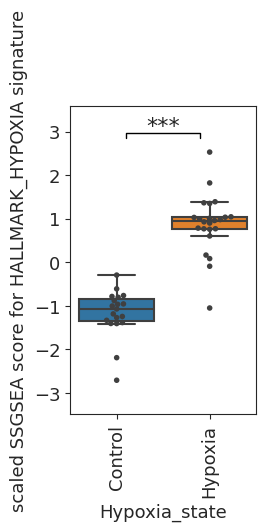

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = ["Control", "Hypoxia"]

boxplot_with_pvalue(
    hypo_cells_ssgsea_scaled[signature_name],
    annot_ko[annot_ko["Hypoxia_state"].isin(categories)]["Hypoxia_state"],
    s=4,
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

# Signature validation: Sorted cells and cell lines, public

## read anno

In [ ]:
# Here we check which version of annotation is the newest - oldest directories go first
paths = sorted(
    Path("/uftp2/Databases/sorted_cell_databases/").iterdir(), key=os.path.getmtime
)
paths

[PosixPath('/uftp2/Databases/sorted_cell_databases/jan2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/march2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/june2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/jan2023'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/current_version'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/March2024')]

In [ ]:
cells_clean = read_dataset(
    "/uftp2/Databases/sorted_cell_databases/current_version/cells_clean_annotation.tsv"
)

In [ ]:
cells_clean = cells_clean[
    (~cells_clean.index.str.contains("RNA"))
    & (~cells_clean.index.str.contains("WES"))
    & (~cells_clean.index.str.contains("210514_NovaA"))
]

In [128]:
cells_clean.shape

(10874, 49)

NB: Клеточный тип из описания датасета обозначен в колонке Cell_type, однако бывает, 
    что более подробное описание образца содержится в колонке Cell_type_details. 
    Также есть колонка Deconvolution_cell_type, 
    в которой значению в колонке Cell_type по возможности сопоставляется такой клеточный тип, 
    для которого сейчас существует модель (https://bostongene.atlassian.net/wiki/spaces/TD/pages/3626696724/bulk+RNA-seq)

In [ ]:
cells_clean = cells_clean[["Cell_type", "Dataset", "Sample", "Cell_origin"]]

In [130]:
public_cells_annot = cells_clean.copy()
public_cells_annot = public_cells_annot.reset_index(drop=True)

In [ ]:
# split celltypes in case there are multiple celltypes per sample

celltypes_split = pd.DataFrame()

for i, j in public_cells_annot.dropna(subset=["Cell_type"]).iterrows():
    if ";" in j["Cell_type"]:
        ct = j["Cell_type"].split(";")
        new_row = j.copy()
        for c in ct:
            new_row["Cell_type"] = c
            celltypes_split = celltypes_split.append(new_row, ignore_index=True)
        public_cells_annot.drop(i, inplace=True)

public_cells_annot = public_cells_annot.append(celltypes_split)

In [132]:
public_cells_annot.index = public_cells_annot.Sample

In [ ]:
# TAM
public_cells_annot["Cell_type"] = [
    (
        public_cells_annot[public_cells_annot.index == x]["Cell_type"]
        .replace("Macrophages", "TAM")
        .get(x)
        if x
        in [
            "SRX4495404",
            "ERX1270123",
            "ERX1270124",
            "ERX1270125",
            "ERX1270126",
            "ERX1270127",
            "ERX1270128",
            "ERX1270130",
        ]
        else public_cells_annot[public_cells_annot.index == x]["Cell_type"].get(x)
    )
    for x in public_cells_annot.index
]

In [ ]:
# Mast cells
cells_annot = get_gspread("Cells", "Cells")
cells_annot = cells_annot.loc[cells_annot.Cell_type.str.contains("Mast_cells")]
cells_annot = prepare_sample_annot(cells_annot)
cells_annot = cells_annot[["Cell_type", "Dataset", "Cell_origin"]]
cells_to_check_annot = get_gspread("Annotation calculated", "Cells_to_check")
cells_to_check_annot = cells_to_check_annot.loc[
    cells_to_check_annot.Cell_type.str.contains("Mast_cells")
]
cells_to_check_annot = prepare_sample_annot(cells_to_check_annot)
cells_to_check_annot = cells_to_check_annot[["Cell_type", "Dataset", "Cell_origin"]]
public_cells_annot = pd.concat([public_cells_annot, cells_annot, cells_to_check_annot])
public_cells_annot = public_cells_annot.loc[
    ~public_cells_annot.index.isin(
        [
            "SRX5026003",
            "SRX5026001",
            "SRX5026000",
            "SRX5026002",
            "SRX5025998",
            "SRX5025999",
            "SRX9977242",
            "SRX9977243",
        ]
    )
]  # bad samples

## anno stats

In [ ]:
pd.options.display.max_rows = len(public_cells_annot["Cell_type"].value_counts())
public_cells_annot["Cell_type"].value_counts()

CD4_T_cells                           1718
Fibroblasts                           1094
Platelets                              763
Monocytic_DC                           545
Macrophages                            519
B_cells                                504
CD8_T_cells                            453
Monocytes                              443
Endothelium                            322
Keratinocytes                          281
Smooth_muscle_cells                    256
Hepatocytes                            224
NK_cells                               202
Neutrophils                            199
Macrophages_M1                         189
Cardiac_myofibroblasts                 168
T_cells                                164
Monocyte_derived_dendritic_cells       160
Dendritic_cells                        146
Non_plasma_B_cells                     128
Plasmacytoid_dendritic_cells           113
Myeloid_cells                           93
MAIT_cells                              91
Endothelium

In [136]:
pd.options.display.max_rows = 20

In [137]:
public_cells_annot.shape

(10925, 4)

In [138]:
public_cells_annot.head()

,Cell_type,Dataset,Sample,Cell_origin
SRX3263500,Monocytes,GSE104744,SRX3263500,Whole_blood
SRX5019107,gd_T_cells,GSE122624,SRX5019107,PBMC
SRX5019094,T_cells,GSE122624,SRX5019094,PBMC
SRX2915885,Fibroblasts,GSE99999,SRX2915885,Skin
SRX4948597,Keratinocytes,GSE121906,SRX4948597,Foreskin


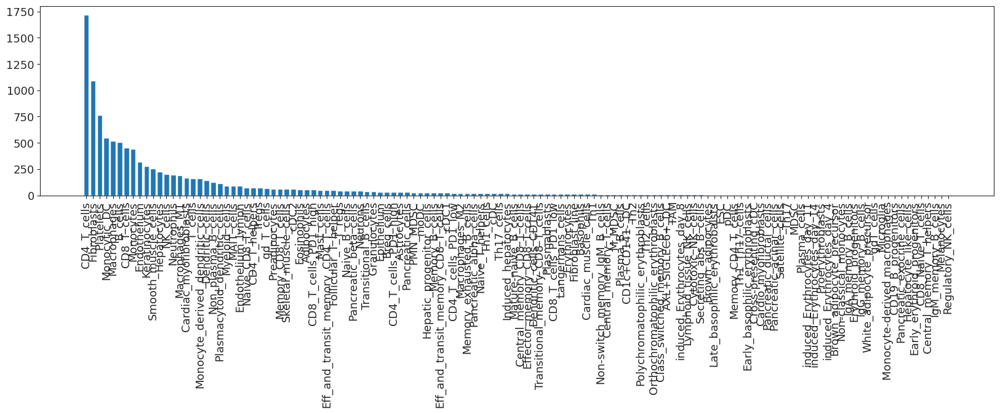

In [ ]:
# a little bit of statistics
# example: which cell types do we have in public_cells_annot?
plt.figure(figsize=(20, 4))
x = public_cells_annot["Cell_type"].value_counts().sort_values(ascending=False)
plt.bar(range(len(x)), x)
plt.xticks(range(len(x)), x.index, rotation=90)
plt.show()

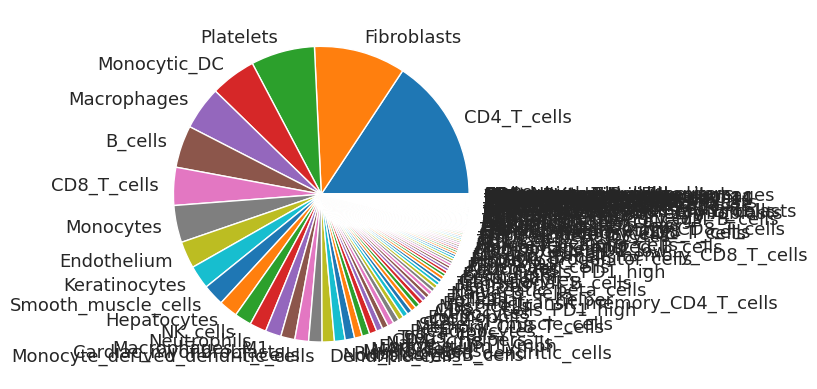

In [140]:
plt.pie(x, labels=x.index)
plt.show()

## read expressions

In [141]:
public_cells_expr = read_expressions(public_cells_annot)

no GSE183854 expression
no GSE199286 expression
no GSE162712 expression
no GSE199490 expression
no GSE214624 expression


In [ ]:
public_cells_expr = np.log2(public_cells_expr + 1)

In [143]:
public_cells_expr = public_cells_expr.T.drop_duplicates().T
public_cells_expr.shape

(20062, 10721)

## define custom signature

In [ ]:
signature_of_interest = """FUT11	NDRG1	EPAS1	CA9	LDHA	LOX	SLC2A1	P4HA1	CA12	HK2	PDK1	PGK1	TPI1	ALDOA	PFKFB3""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']

# add here a custon signature name (as a first input)
signature_name = "Main4_Hypoxia_factors"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

## Validation

### train-test split

NB: for train-test split to work adequately, we need sufficient number of every celltype, so here we get rid of celltypes presented by less than 5 cells

In [ ]:
suf_cells = (
    public_cells_annot["Cell_type"]
    .value_counts()[public_cells_annot["Cell_type"].value_counts() > 5]
    .index
)
public_cells_annot = public_cells_annot[public_cells_annot["Cell_type"].isin(suf_cells)]

In [ ]:
public_cells_expr, public_cells_annot = to_common_samples(
    [public_cells_expr.T, public_cells_annot]
)
public_cells_expr = public_cells_expr.T

expr_train, expr_test, d_train, d_test = train_test_split(
    public_cells_expr.T,
    public_cells_annot["Cell_type"],
    stratify=public_cells_annot["Cell_type"],
    random_state=42,
    train_size=0.75,
)

First, select if you want to use train data to add/remove genes to your signature, or test data to make you did not 'adjust' your data to describe train dataset best

In [ ]:
# type 'train' or 'test' below
train_or_test = "train"
if train_or_test == "train":
    public_cells_expressions_to_use = expr_train.T
elif train_or_test == "test":
    public_cells_expressions_to_use = expr_test.T
else:
    public_cells_expressions_to_use = public_cells_expr

### heatmaps and ssgsea score comparison

In [ ]:
# define celltypes of interest
categories = [
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "TAM",
    "Dendritic_cells",
    "Neutrophils",
    "Eosinophils",
    "Basophils",
    "NK_cells",
    "CD8_T_cells",
    "CD4_T_cells",
    "Tregs",
    "B_cells",
    "Plasma_B_cells",
]

# dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat(
        [annot, public_cells_annot.loc[public_cells_annot["Cell_type"].isin([i])]]
    )

# for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(
    annot["Cell_type"], categories=categories, ordered=True
)
annot = annot.sort_values("Cell_type")

In [ ]:
subsampling_public = [
    i[1].sample(np.min([5, i[1].shape[0]])).index.tolist()
    for i in annot.groupby("Cell_type")
]

In [154]:
subsampling_public = [item for sublist in subsampling_public for item in sublist]

<AxesSubplot:xlabel='Cell_type'>

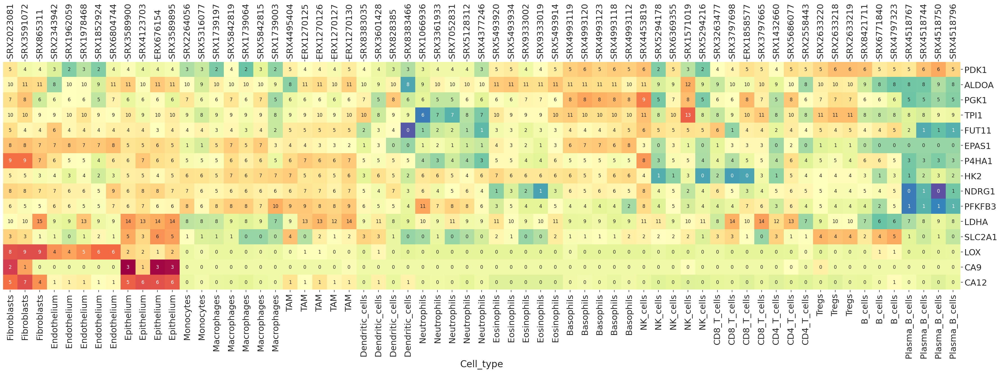

In [ ]:
# A simple heatmap with log2 TPM of subsampled cells from celltypes of interest
subsampling_public = [
    i for i in subsampling_public if i in public_cells_expressions_to_use.columns
]

genes_heatmap(
    public_cells_expressions_to_use[subsampling_public],
    annot.reindex(subsampling_public)["Cell_type"],
    signature_of_interest,
    show_expression=True,
    highlight_genes=[],
    gene_highlight_lw=1,
    highlight_columns=[],
    col_highlight_color="blue",
    figsize=(45, 13),
    font_scale=2,
    show_indices=True,
    col_cluster=False,
    col_dendrogram=False,
    row_dendrogram=False,
)

In [ ]:
sns.reset_defaults()
sns.set_style("white")

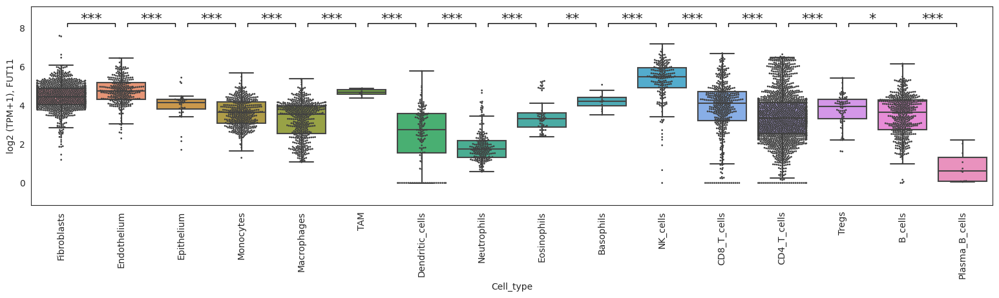

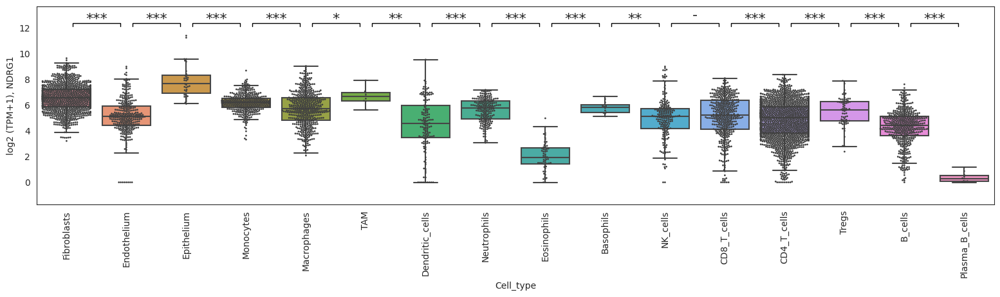

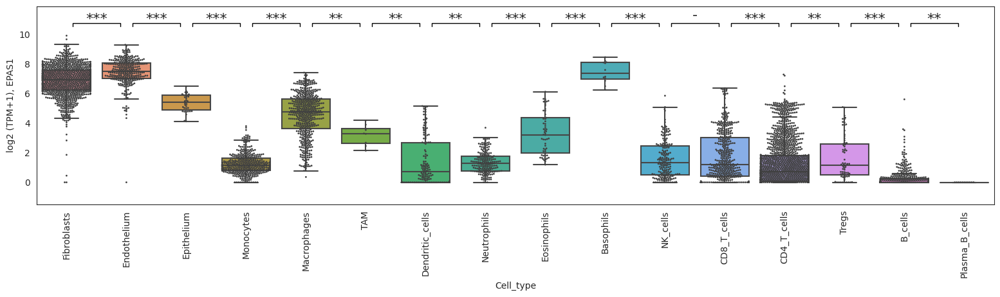

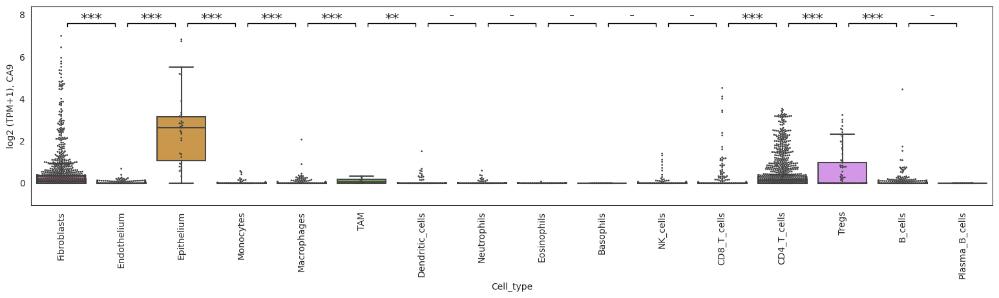

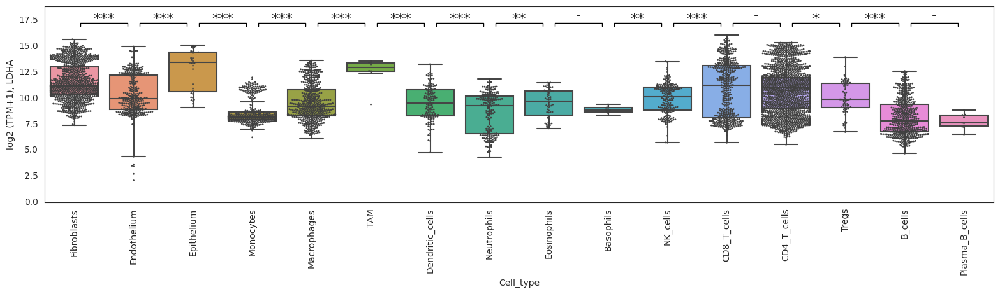

...

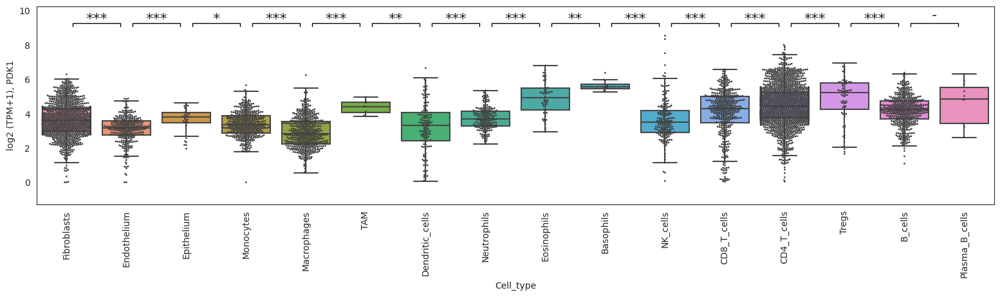

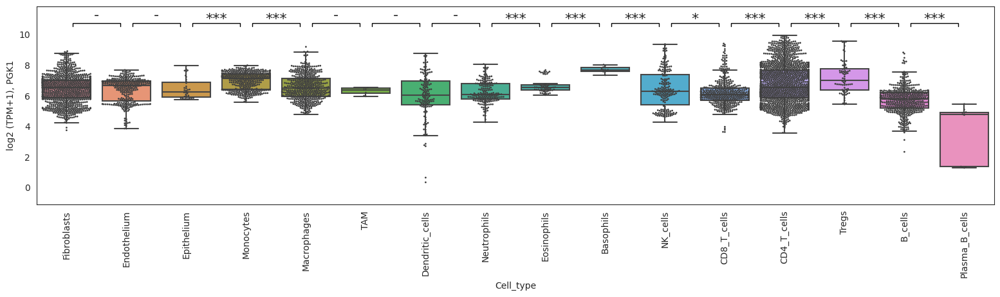

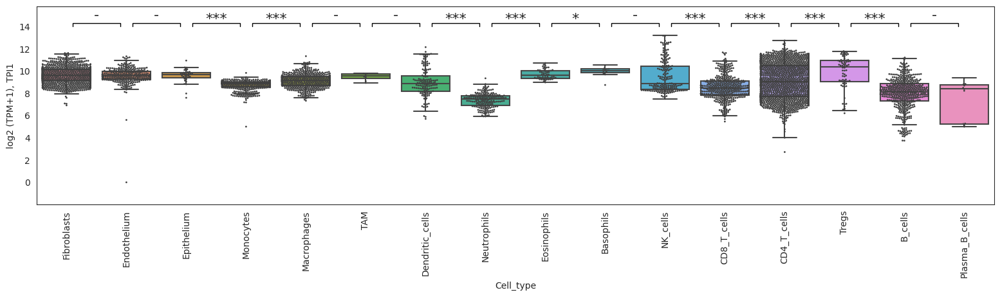

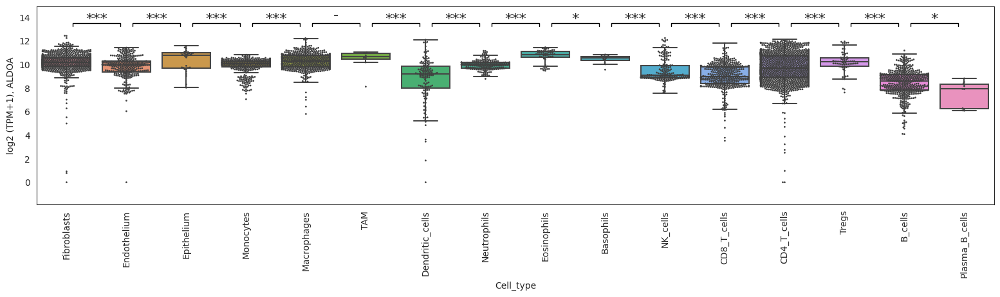

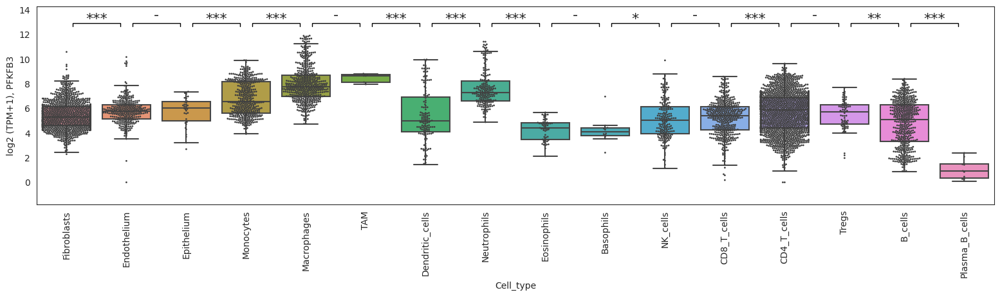

In [ ]:
# boxplots depicting signature genes expression in celltypes of interest

categories = [
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "TAM",
    "Dendritic_cells",
    "Neutrophils",
    "Eosinophils",
    "Basophils",
    "NK_cells",
    "CD8_T_cells",
    "CD4_T_cells",
    "Tregs",
    "B_cells",
    "Plasma_B_cells",
]

public_cells_expressions_to_use_ss, annot_ss = to_common_samples(
    [public_cells_expr.T, annot]
)
public_cells_expressions_to_use_ss = public_cells_expressions_to_use_ss.T

for gene in signature_of_interest:
    boxplot_with_pvalue(
        public_cells_expressions_to_use_ss.loc[gene],
        annot_ss[annot_ss["Cell_type"].isin(categories)]["Cell_type"],
        s=2,
        order=[i for i in categories if i in annot_ss["Cell_type"].unique()],
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
public_cells_ssgsea_unscaled = ssgsea_formula(
    public_cells_expressions_to_use,
    gmt_genes_alt_names(
        geneset_of_interest, public_cells_expressions_to_use.index, verbose=False
    ),
).T

In [ ]:
x = public_cells_annot.groupby("Dataset")

public_cells_ssgsea_scaled = {}
for i in x:
    public_cells_ssgsea_scaled[i[0]] = median_scale(
        public_cells_ssgsea_unscaled.reindex(i[1].index)
    )

public_cells_ssgsea_scaled = pd.concat(public_cells_ssgsea_scaled.values())

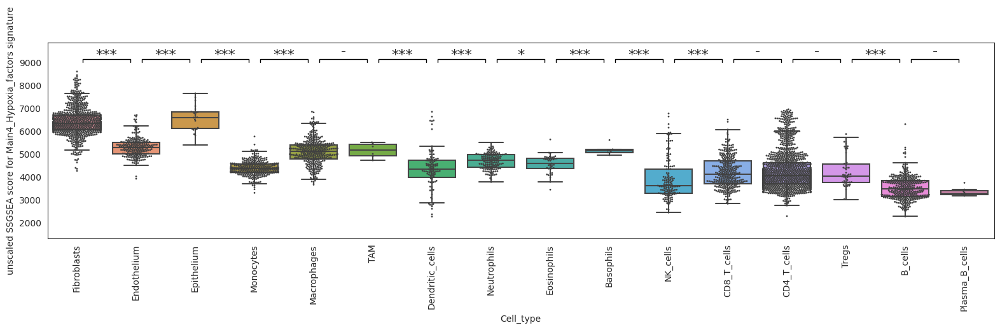

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = [
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "TAM",
    "Dendritic_cells",
    "Neutrophils",
    "Eosinophils",
    "Basophils",
    "NK_cells",
    "CD8_T_cells",
    "CD4_T_cells",
    "Tregs",
    "B_cells",
    "Plasma_B_cells",
]

public_cells_ssgsea_unscaled_ss, annot_ss = to_common_samples(
    [public_cells_ssgsea_unscaled, annot]
)

boxplot_with_pvalue(
    public_cells_ssgsea_unscaled[signature_name],
    annot_ss[annot_ss["Cell_type"].isin(categories)]["Cell_type"],
    s=2,
    order=[i for i in categories if i in annot_ss["Cell_type"].unique()],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()

#### HALLMARK_HYPOXIA

In [ ]:
signature_of_interest = """ADM,ADORA2B,AK4,AKAP12,ALDOA,ALDOB,ALDOC,AMPD3,ANGPTL4,ANKZF1,ANXA2,ATF3,ATP7A,B3GALT6,B4GALNT2,BCAN,BCL2,BGN,BHLHE40,BNIP3L,BRS3,BTG1,CA12,CASP6,CAV1,CCNG2,CCRN4L,CDKN1A,CDKN1B,CDKN1C,CHST2,CHST3,CITED2,COL5A1,CP,CSRP2,CTGF,CXCR4,ACKR3,CYR61,DCN,DDIT3,DDIT4,DPYSL4,DTNA,DUSP1,EDN2,EFNA1,EFNA3,EGFR,ENO1,ENO2,ENO3,ERO1L,ERRFI1,ETS1,EXT1,F3,FAM162A,FBP1,FOS,FOSL2,FOXO3,GAA,GALK1,GAPDH,GAPDHS,GBE1,GCK,GCNT2,GLRX,GPC1,GPC3,GPC4,GPI,GRHPR,GYS1,HAS1,HDLBP,HEXA,HK1,HK2,HMOX1,HOXB9,HS3ST1,HSPA5,IDS,IER3,IGFBP1,IGFBP3,IL6,ILVBL,INHA,IRS2,ISG20,JMJD6,JUN,KDELR3,KDM3A,KIF5A,KLF6,KLF7,KLHL24,LALBA,LARGE,LDHA,LDHC,LOX,LXN,MAFF,MAP3K1,MIF,MT1E,MT2A,MXI1,MYH9,NAGK,NCAN,NDRG1,NDST1,NDST2,NEDD4L,NFIL3,NR3C1,P4HA1,P4HA2,PAM,PCK1,PDGFB,PDK1,PDK3,PFKFB3,PFKL,PFKP,PGAM2,PGF,PGK1,PGM1,PGM2,PHKG1,PIM1,PKLR,PKP1,PLAC8,PLAUR,PLIN2,PNRC1,PPARGC1A,PPFIA4,PPP1R15A,PPP1R3C,PRDX5,PRKCA,PRKCDBP,PTRF,PYGM,RBPJ,RORA,RRAGD,S100A4,SAP30,SCARB1,SDC2,SDC3,SDC4,SELENBP1,SERPINE1,SIAH2,SLC25A1,SLC2A1,SLC2A3,SLC2A5,SLC37A4,SLC6A6,SRPX,STC1,STC2,SULT2B1,TES,TGFB3,TGFBI,TGM2,TIPARP,TKTL1,TMEM45A,TNFAIP3,TPBG,TPD52,TPI1,TPST2,UGP2,VEGFA,VHL,VLDLR,WISP2,WSB1,XPNPEP1,ZFP36,ZNF292""".split(
    ","
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']
# STBD1,
# add here a custon signature name (as a first input)
signature_name = "HALLMARK_HYPOXIA"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
public_cells_ssgsea_unscaled = ssgsea_formula(
    public_cells_expressions_to_use,
    gmt_genes_alt_names(
        geneset_of_interest, public_cells_expressions_to_use.index, verbose=False
    ),
).T

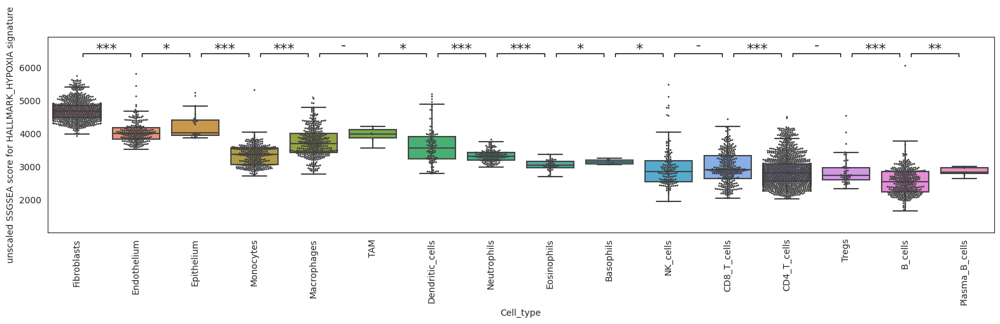

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = [
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "TAM",
    "Dendritic_cells",
    "Neutrophils",
    "Eosinophils",
    "Basophils",
    "NK_cells",
    "CD8_T_cells",
    "CD4_T_cells",
    "Tregs",
    "B_cells",
    "Plasma_B_cells",
]

public_cells_ssgsea_unscaled_ss, annot_ss = to_common_samples(
    [public_cells_ssgsea_unscaled, annot]
)

boxplot_with_pvalue(
    public_cells_ssgsea_unscaled[signature_name],
    annot_ss[annot_ss["Cell_type"].isin(categories)]["Cell_type"],
    s=2,
    order=[i for i in categories if i in annot_ss["Cell_type"].unique()],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()

# Signature validation: Sorted cells and cell lines from BG lab

## read anno

In [ ]:
# Here we check which version of annotation is the newest - oldest directories go first
paths = sorted(
    Path("/uftp2/Databases/sorted_cell_databases/").iterdir(), key=os.path.getmtime
)
paths

[PosixPath('/uftp2/Databases/sorted_cell_databases/jan2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/march2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/june2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/jan2023'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/current_version'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/March2024')]

In [ ]:
cells_clean = read_dataset(
    "/uftp2/Databases/sorted_cell_databases/current_version/lab_clean_annotation.tsv"
)

In [ ]:
cells_clean = cells_clean.loc[
    ~cells_clean["Cell_type_details"].str.contains("topoff", case=False, na=False)
]
cells_clean = cells_clean.loc[
    ~cells_clean["Cell_type_details"].str.contains(
        "minimal sample", case=False, na=False
    )
]

NB: Клеточный тип из описания датасета обозначен в колонке Cell_type, однако бывает, 
    что более подробное описание образца содержится в колонке Cell_type_details. 
    Также есть колонка Deconvolution_cell_type, 
    в которой значению в колонке Cell_type по возможности сопоставляется такой клеточный тип, 
    для которого сейчас существует модель (https://bostongene.atlassian.net/wiki/spaces/TD/pages/3626696724/bulk+RNA-seq)

In [ ]:
cells_clean = cells_clean[["Cell_type", "Dataset", "Sample"]]

In [168]:
lab_cells_annot = cells_clean.copy()
lab_cells_annot = lab_cells_annot.reset_index(drop=True)

In [ ]:
# split celltypes in case there are multiple celltypes per sample

celltypes_split = pd.DataFrame()

for i, j in lab_cells_annot.dropna(subset=["Cell_type"]).iterrows():
    if ";" in j["Cell_type"]:
        ct = j["Cell_type"].split(";")
        new_row = j.copy()
        for c in ct:
            new_row["Cell_type"] = c
            celltypes_split = celltypes_split.append(new_row, ignore_index=True)
        lab_cells_annot.drop(i, inplace=True)

lab_cells_annot = lab_cells_annot.append(celltypes_split)

In [170]:
lab_cells_annot.index = lab_cells_annot.Sample

In [ ]:
lab_cells_annot["Cell_type"] = (
    lab_cells_annot["Cell_type"]
    .replace("Fibroblasts_CD146int_PDPN+_FAP+", "Fibroblasts_FAP+")
    .replace("Fibroblasts_CD146-_FAP+", "Fibroblasts_FAP+")
    .replace("Fibroblasts_CD146low_FAP+", "Fibroblasts_FAP+")
)

## anno stats

In [ ]:
pd.options.display.max_rows = len(lab_cells_annot["Cell_type"].value_counts())
lab_cells_annot["Cell_type"].value_counts()

Monocytes                                      30
Central_memory_T_helpers                       26
Total_live                                     24
Effector_memory_T_helpers                      21
CD4_T_cells                                    20
B_cells                                        17
Tfh_cells                                      17
Tumor                                          16
CD206pos_Macrophages                           15
NK_cells                                       13
CD8_T_cells                                    13
Naive_CD8_T_cells                              13
Th1_CTL                                        12
CD206neg_Macrophages                           12
Fibroblasts_CD146+                             11
Naive_CD4_T_cells                              11
Th1_resting_cells                              10
CX3CR1+_PD1+_CD45RA-_Memory_CD8_T_cells        10
CX3CR1-_PD1-_CXCR3+_Memory_CD8_T_cells          9
Central_memory_CD8_T_cells                      9


In [173]:
pd.options.display.max_rows = 20

In [174]:
lab_cells_annot.head()

,Cell_type,Dataset,Sample
Sample,,,
RNASeq-normal-201202_Next_Sample2,Classical_monocytes,RNASeq-normal-201202_Next_Sample2_dataset,RNASeq-normal-201202_Next_Sample2
RNASeq-normal-201202_Next_Sample3,B_cells,RNASeq-normal-201202_Next_Sample3_dataset,RNASeq-normal-201202_Next_Sample3
RNASeq-normal-201202_Next_Sample4,CD4_T_cells,RNASeq-normal-201202_Next_Sample4_dataset,RNASeq-normal-201202_Next_Sample4
RNASeq-normal-201202_Next_Sample5,Central_memory_CD4_T_cells,RNASeq-normal-201202_Next_Sample5_dataset,RNASeq-normal-201202_Next_Sample5
RNASeq-normal-201202_Next_Sample6,Effector_memory_CD4_T_cells,RNASeq-normal-201202_Next_Sample6_dataset,RNASeq-normal-201202_Next_Sample6


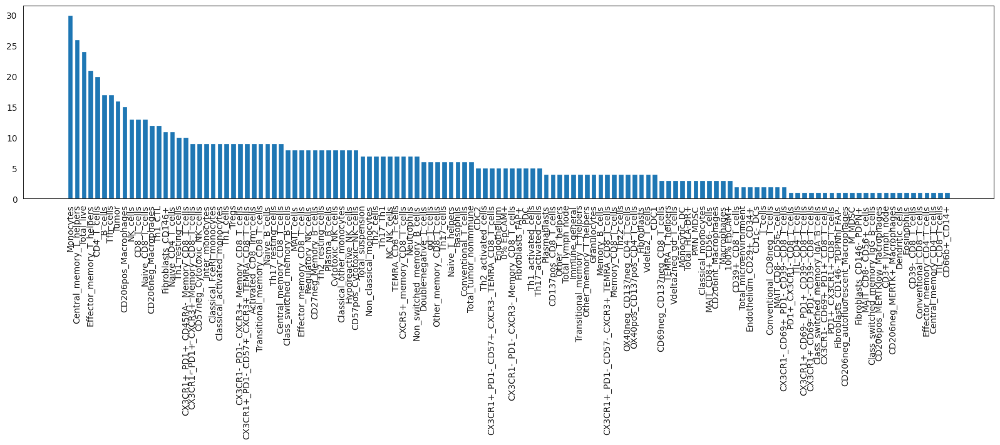

In [ ]:
# a little bit of statistics
# example: which cell types do we have in lab_cells_annot?
plt.figure(figsize=(20, 4))
x = lab_cells_annot["Cell_type"].value_counts().sort_values(ascending=False)
plt.bar(range(len(x)), x)
plt.xticks(range(len(x)), x.index, rotation=90)
plt.show()

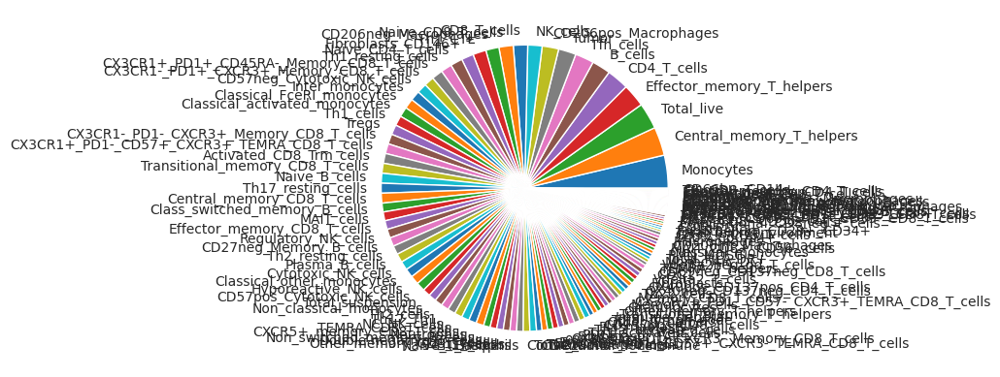

In [176]:
plt.pie(x, labels=x.index)
plt.show()

## read expressions

In [ ]:
lab_cells_expr = pd.read_csv(
    "/uftp2/Databases/sorted_cell_databases/current_version/lab_clean_expressions.tsv",
    sep="\t",
    index_col=0,
)

In [ ]:
lab_cells_expr = np.log2(lab_cells_expr + 1)

In [179]:
lab_cells_expr = lab_cells_expr[~lab_cells_expr.index.duplicated()]

## define custom signature

In [ ]:
signature_of_interest = """FUT11	NDRG1	EPAS1	CA9	LDHA	LOX	SLC2A1	P4HA1	CA12	HK2	PDK1	PGK1	TPI1	ALDOA	PFKFB3""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']

# add here a custon signature name (as a first input)
signature_name = "Main4_Hypoxia_factors"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

## Validation itself

In [ ]:
# define celltypes of interest
categories = [
    "Fibroblasts",
    "Endothelium",
    "Tumor",
    "Monocytes",
    "CD206pos_Macrophages",
    "CDC1",
    "CDC2",
    "PDC",
    "Neutrophils",
    "Basophils",
    "NK_cells",
    "CD8_T_cells",
    "CD4_T_cells",
    "Tregs",
    "B_cells",
    "Plasma_B_cells",
]

# dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat(
        [annot, lab_cells_annot.loc[lab_cells_annot["Cell_type"].isin([i])]]
    )

# for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(
    annot["Cell_type"], categories=categories, ordered=True
)
annot = annot.sort_values("Cell_type")

In [ ]:
subsampling_lab = [
    i[1].sample(np.min([5, i[1].shape[0]])).index.tolist()
    for i in annot.groupby("Cell_type")
]

In [183]:
subsampling_lab = [item for sublist in subsampling_lab for item in sublist]

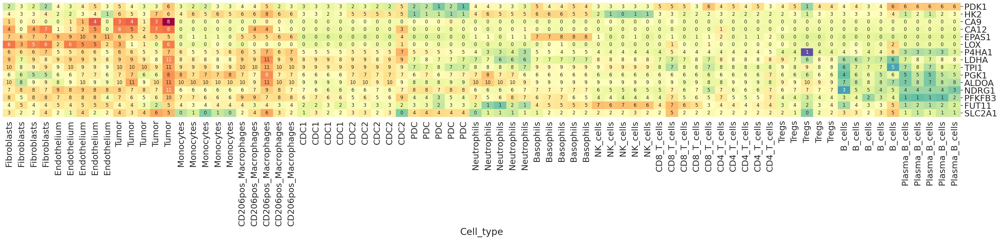

In [ ]:
# A simple heatmap with log2 TPM of subsampled cells from celltypes of interest
genes_heatmap(
    lab_cells_expr[subsampling_lab],
    annot.reindex(subsampling_lab)["Cell_type"],
    signature_of_interest,
    show_expression=True,
    highlight_genes=[],
    gene_highlight_lw=1,
    highlight_columns=[],
    col_highlight_color="blue",
    figsize=(45, 13),
    font_scale=2,
    show_indices=False,
    col_cluster=False,
    col_dendrogram=False,
    row_dendrogram=False,
)
plt.show()

In [ ]:
sns.reset_defaults()
sns.set_style("white")

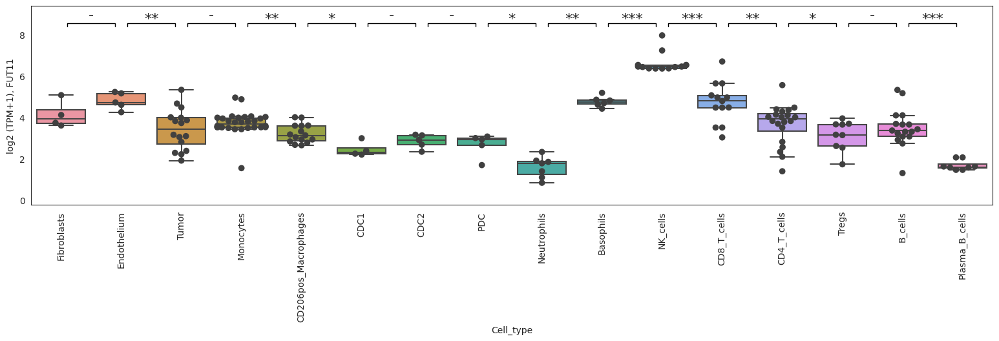

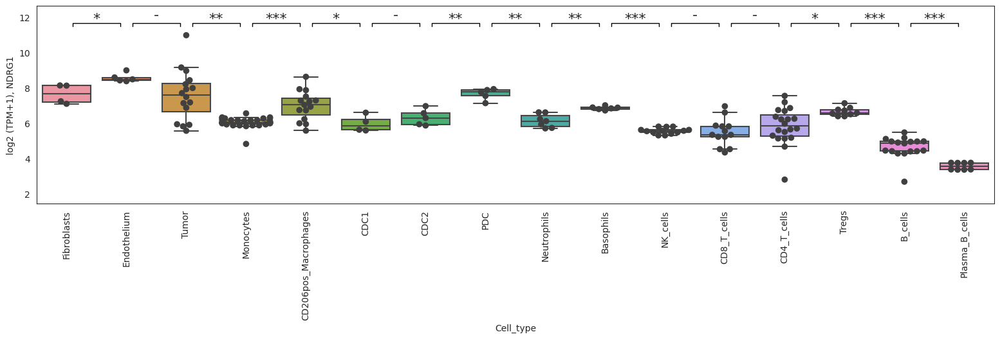

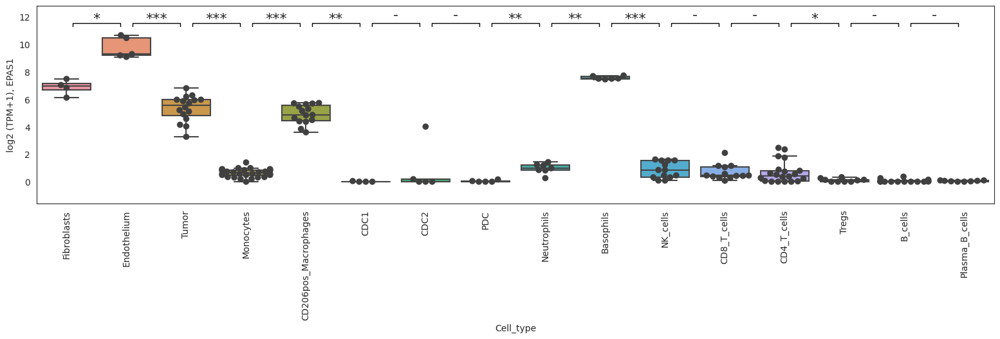

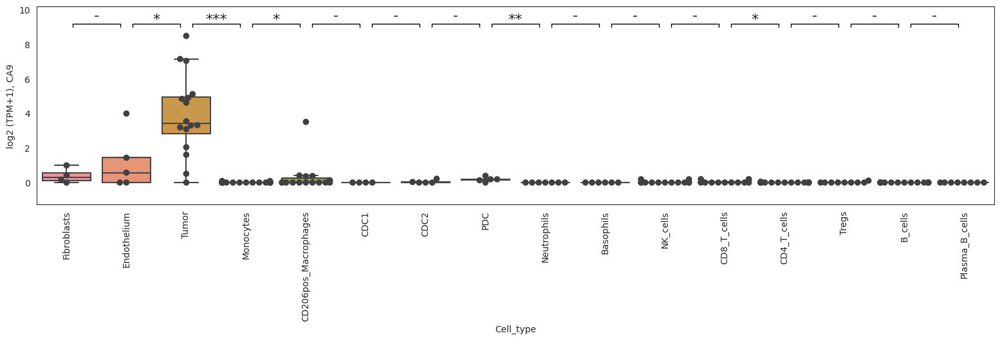

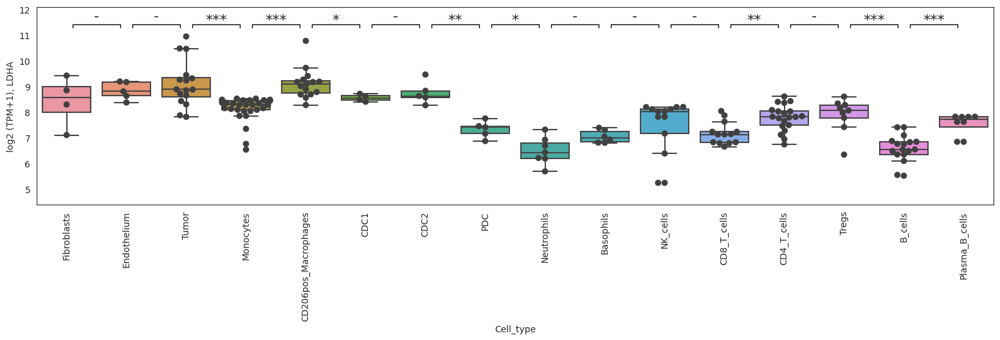

...

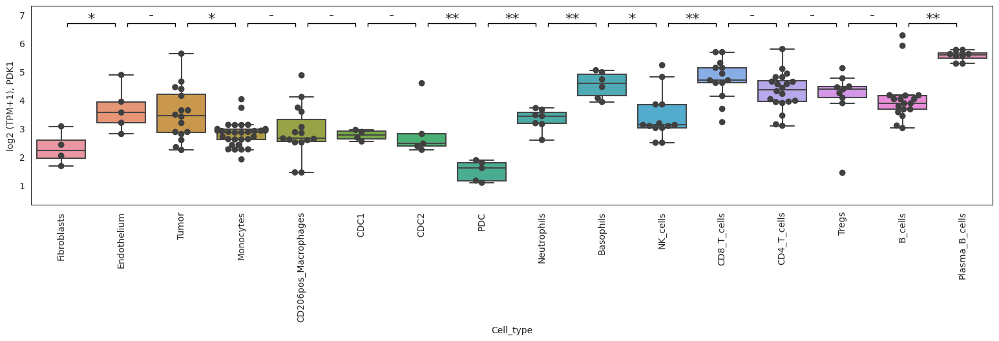

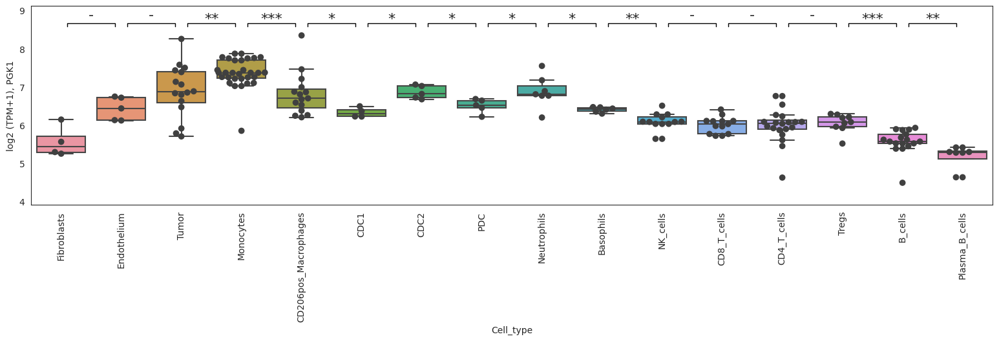

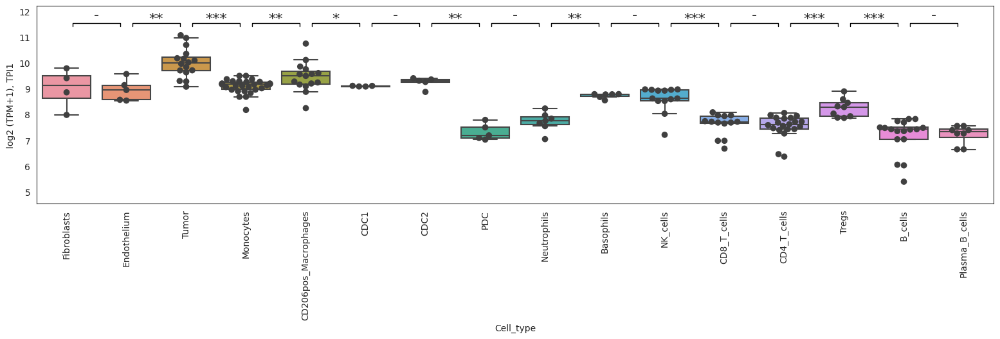

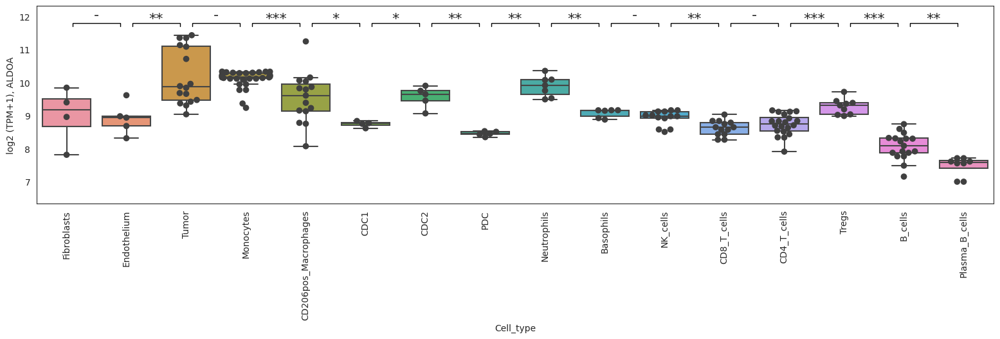

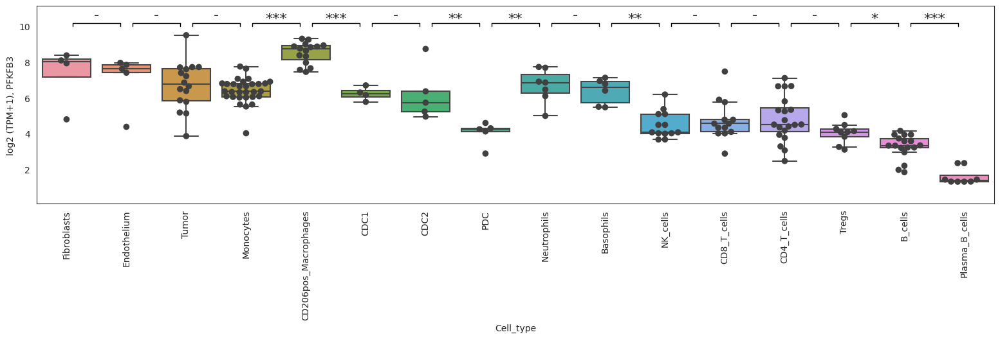

In [ ]:
# boxplots depicting signature genes expression in celltypes of interest

categories = [
    "Fibroblasts",
    "Endothelium",
    "Tumor",
    "Monocytes",
    "CD206pos_Macrophages",
    "CDC1",
    "CDC2",
    "PDC",
    "Neutrophils",
    "Basophils",
    "NK_cells",
    "CD8_T_cells",
    "CD4_T_cells",
    "Tregs",
    "B_cells",
    "Plasma_B_cells",
]

for gene in signature_of_interest:
    boxplot_with_pvalue(
        lab_cells_expr.loc[gene],
        annot[annot["Cell_type"].isin(categories)]["Cell_type"],
        order=categories,
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
lab_cells_ssgsea_unscaled = ssgsea_formula(
    lab_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, lab_cells_expr.index, verbose=False),
).T

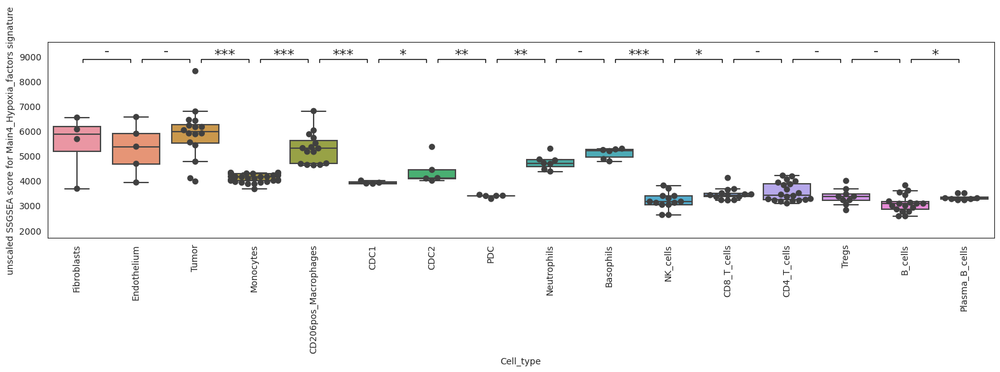

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = [
    "Fibroblasts",
    "Endothelium",
    "Tumor",
    "Monocytes",
    "CD206pos_Macrophages",
    "CDC1",
    "CDC2",
    "PDC",
    "Neutrophils",
    "Basophils",
    "NK_cells",
    "CD8_T_cells",
    "CD4_T_cells",
    "Tregs",
    "B_cells",
    "Plasma_B_cells",
]

boxplot_with_pvalue(
    lab_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()

#### HALLMARK_HYPOXIA

In [ ]:
signature_of_interest = """ADM,ADORA2B,AK4,AKAP12,ALDOA,ALDOB,ALDOC,AMPD3,ANGPTL4,ANKZF1,ANXA2,ATF3,ATP7A,B3GALT6,B4GALNT2,BCAN,BCL2,BGN,BHLHE40,BNIP3L,BRS3,BTG1,CA12,CASP6,CAV1,CCNG2,CCRN4L,CDKN1A,CDKN1B,CDKN1C,CHST2,CHST3,CITED2,COL5A1,CP,CSRP2,CTGF,CXCR4,ACKR3,CYR61,DCN,DDIT3,DDIT4,DPYSL4,DTNA,DUSP1,EDN2,EFNA1,EFNA3,EGFR,ENO1,ENO2,ENO3,ERO1L,ERRFI1,ETS1,EXT1,F3,FAM162A,FBP1,FOS,FOSL2,FOXO3,GAA,GALK1,GAPDH,GAPDHS,GBE1,GCK,GCNT2,GLRX,GPC1,GPC3,GPC4,GPI,GRHPR,GYS1,HAS1,HDLBP,HEXA,HK1,HK2,HMOX1,HOXB9,HS3ST1,HSPA5,IDS,IER3,IGFBP1,IGFBP3,IL6,ILVBL,INHA,IRS2,ISG20,JMJD6,JUN,KDELR3,KDM3A,KIF5A,KLF6,KLF7,KLHL24,LALBA,LARGE,LDHA,LDHC,LOX,LXN,MAFF,MAP3K1,MIF,MT1E,MT2A,MXI1,MYH9,NAGK,NCAN,NDRG1,NDST1,NDST2,NEDD4L,NFIL3,NR3C1,P4HA1,P4HA2,PAM,PCK1,PDGFB,PDK1,PDK3,PFKFB3,PFKL,PFKP,PGAM2,PGF,PGK1,PGM1,PGM2,PHKG1,PIM1,PKLR,PKP1,PLAC8,PLAUR,PLIN2,PNRC1,PPARGC1A,PPFIA4,PPP1R15A,PPP1R3C,PRDX5,PRKCA,PRKCDBP,PTRF,PYGM,RBPJ,RORA,RRAGD,S100A4,SAP30,SCARB1,SDC2,SDC3,SDC4,SELENBP1,SERPINE1,SIAH2,SLC25A1,SLC2A1,SLC2A3,SLC2A5,SLC37A4,SLC6A6,SRPX,STC1,STC2,SULT2B1,TES,TGFB3,TGFBI,TGM2,TIPARP,TKTL1,TMEM45A,TNFAIP3,TPBG,TPD52,TPI1,TPST2,UGP2,VEGFA,VHL,VLDLR,WISP2,WSB1,XPNPEP1,ZFP36,ZNF292""".split(
    ","
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']
# STBD1,
# add here a custon signature name (as a first input)
signature_name = "HALLMARK_HYPOXIA"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
lab_cells_ssgsea_unscaled = ssgsea_formula(
    lab_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, lab_cells_expr.index, verbose=False),
).T

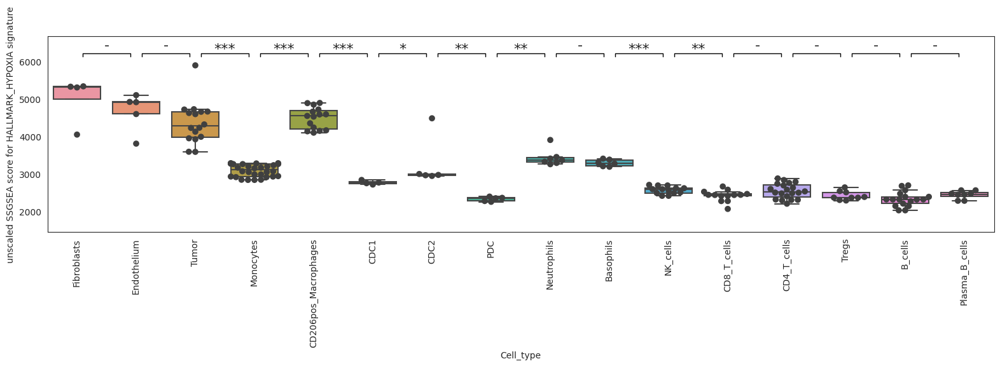

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest (unscaled)

categories = [
    "Fibroblasts",
    "Endothelium",
    "Tumor",
    "Monocytes",
    "CD206pos_Macrophages",
    "CDC1",
    "CDC2",
    "PDC",
    "Neutrophils",
    "Basophils",
    "NK_cells",
    "CD8_T_cells",
    "CD4_T_cells",
    "Tregs",
    "B_cells",
    "Plasma_B_cells",
]

boxplot_with_pvalue(
    lab_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()

# Signature validation: Cancer cell lines

## read anno

In [ ]:
# Here we check which version of annotation is the newest - oldest directories go first
paths = sorted(
    Path("/uftp2/Databases/sorted_cell_databases/").iterdir(), key=os.path.getmtime
)
paths

[PosixPath('/uftp2/Databases/sorted_cell_databases/jan2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/march2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/june2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/jan2023'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/current_version'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/March2024')]

In [ ]:
cells_clean = read_dataset(
    "/uftp2/Databases/sorted_cell_databases/current_version/cancer_cell_lines_all_annotation.tsv"
)

In [ ]:
cells_clean = cells_clean[["Tumor_type", "Dataset", "Sample", "Therapy"]]

In [198]:
cancer_cells_annot = cells_clean.copy()

## anno stats

In [ ]:
pd.options.display.max_rows = len(cancer_cells_annot["Tumor_type"].value_counts())
cancer_cells_annot["Tumor_type"].value_counts()

Lung_Adenocarcinoma                                  886
Prostate_Cancer                                      553
Pancreatic_Ductal_Adenocarcinoma                     269
Melanoma                                             247
Invasive_Breast_Carcinoma                            188
Acute_Myeloid_Leukemia                               186
EBV-B_cells                                          185
Large_Cell_Lung_Carcinoma                            181
Diffuse_Large_B_Cell_Lymphoma                        176
Mantle_Cell_Lymphoma                                 167
Cutaneous_Melanoma                                   126
Squamous_Cell_Carcinoma_of_the_Head_and_Neck         121
Chronic_Lymphocytic_Leukemia                         114
Colon_Adenocarinoma                                  102
Breast_Adenocarcinoma                                 95
Colon_Carinoma                                        94
Breast_Neoplasm                                       87
Glioblastoma                   

In [200]:
pd.options.display.max_rows = 20

In [201]:
cancer_cells_annot.head()

,Tumor_type,Dataset,Sample,Therapy
SRX4143039,Small_Cell_Lung_Carcinoma,GSE115122,SRX4143039,Without_therapy
SRX2495594,Diffuse_Large_B_Cell_Lymphoma,GSE93675,SRX2495594,Without_therapy
SRX3506075,Lung_Adenocarcinoma,GSE108464,SRX3506075,Without_therapy
SRX2314325,Diffuse_Large_B_Cell_Lymphoma,GSE89339,SRX2314325,Without_therapy
SRX2035865,Multiple_Myeloma,GSE85840,SRX2035865,Without_therapy


In [202]:
pd.crosstab(cancer_cells_annot.Tumor_type, cancer_cells_annot.Therapy)

Therapy,BRAFi,BRAFi+MEKi,BTK inhibitor (Ibrutinib),Day_10_of_PBS,Day_10_of_Ribavarin_80mg/kg/twice daily intraperitoneally,Lck inhibitor,No_data,Without_therapy,previously treated for non-Hodgkin lymphoma (NHL),"rituximab dosed 25 mg/kg, three times a week over 21 days."
Tumor_type,,,,,,,,,,
Acute_Erythroid_Leukemia,0,0,0,0,0,0,6,0,0,0
Acute_Lymphoblastic_Leukemia,0,0,0,0,0,0,0,42,0,0
Acute_Monocytic_Leukemia,0,0,0,0,0,0,0,20,0,0
Acute_Myeloid_Leukemia,0,0,0,0,0,0,0,186,0,0
Adenosquamous_Cell_Lung_Carcinoma,0,0,0,0,0,0,0,4,0,0
...,...,...,...,...,...,...,...,...,...,...
hESC,0,0,0,0,0,0,1,0,0,0
mesenchymal stem cells day 1,0,0,0,0,0,0,1,0,0,0
mesenchymal stem cells day 3,0,0,0,0,0,0,1,0,0,0


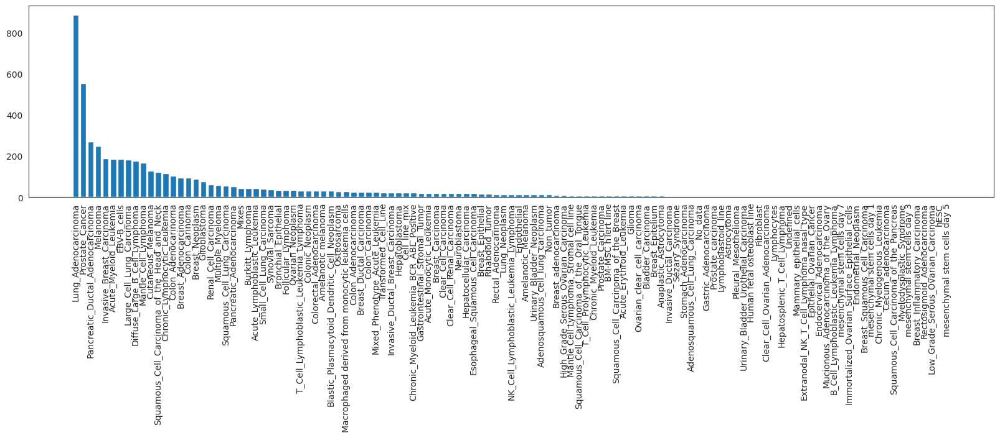

In [ ]:
# a little bit of statistics
# example: which cell types do we have in cancer_cells_annot?
plt.figure(figsize=(20, 4))
x = cancer_cells_annot["Tumor_type"].value_counts().sort_values(ascending=False)
plt.bar(range(len(x)), x)
plt.xticks(range(len(x)), x.index, rotation=90)
plt.show()

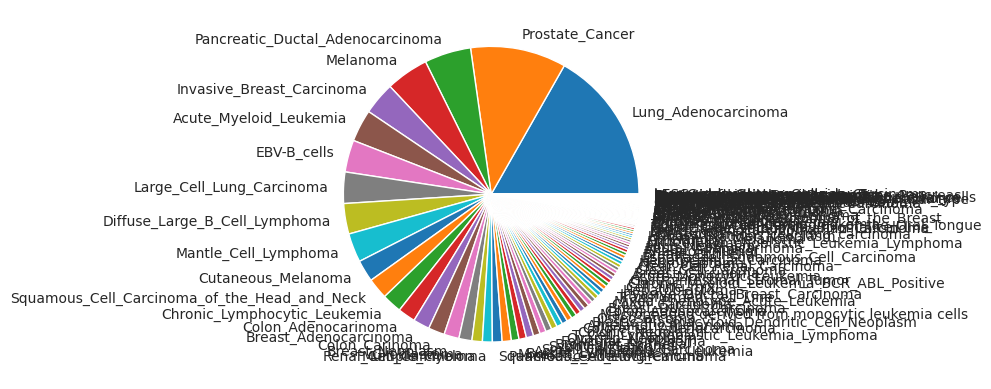

In [204]:
plt.pie(x, labels=x.index)
plt.show()

## read expressions

In [205]:
cancer_cells_expr = read_expressions(cancer_cells_annot)

In [ ]:
cancer_cells_expr = np.log2(cancer_cells_expr + 1)

## define custom signature

In [ ]:
signature_of_interest = """FUT11	NDRG1	EPAS1	CA9	LDHA	LOX	SLC2A1	P4HA1	CA12	HK2	PDK1	PGK1	TPI1	ALDOA	PFKFB3""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']

# add here a custon signature name (as a first input)
signature_name = "Main4_Hypoxia_factors"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

## Validation

### train-test split

NB: for train-test split to work adequately, we need sufficient number of every celltype, so here we get rid of celltypes presented by less than 5 cells

In [ ]:
suf_cells = (
    cancer_cells_annot["Tumor_type"]
    .value_counts()[cancer_cells_annot["Tumor_type"].value_counts() > 5]
    .index
)
cancer_cells_annot = cancer_cells_annot[
    cancer_cells_annot["Tumor_type"].isin(suf_cells)
]

In [ ]:
cancer_cells_expr, cancer_cells_annot = to_common_samples(
    [cancer_cells_expr.T, cancer_cells_annot]
)
cancer_cells_expr = cancer_cells_expr.T

c_expr_train, c_expr_test, c_d_train, c_d_test = train_test_split(
    cancer_cells_expr.T,
    cancer_cells_annot["Tumor_type"],
    stratify=cancer_cells_annot["Tumor_type"],
    random_state=42,
    train_size=0.75,
)

First, select if you want to use train data to add/remove genes to your signature, or test data to make you did not 'adjust' your data to describe train dataset best

In [ ]:
# type 'train' or 'test' below
train_or_test = "train"
if train_or_test == "train":
    cancer_cells_expressions_to_use = c_expr_train.T
elif train_or_test == "test":
    cancer_cells_expressions_to_use = c_expr_test.T

### ssgsea score comparison

In [ ]:
# define diagnoses of interest
categories = [
    "Lung_Adenocarcinoma",
    "Large_Cell_Lung_Carcinoma",
    "Prostate_Cancer",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Invasive_Breast_Carcinoma",
    "Colon_Adenocarinoma",
    "Ovarian_Neoplasm",
    "Squamous_Cell_Carcinoma_of_the_Head_and_Neck",
    "Melanoma",
    "Renal_Cell_Carcinoma",
    "Bladder_Carcinoma",
    "Small_Cell_Lung_Carcinoma",
    "Synovial_Sarcoma",
    "Hepatoblastoma",
    "Glioblastoma",
    "Neuroblastoma",
    "Diffuse_Large_B_Cell_Lymphoma",
    "Mantle_Cell_Lymphoma",
    "Burkitt_Lymphoma",
    "Chronic_Lymphocytic_Leukemia",
    "Acute_Myeloid_Leukemia",
    "Multiple_Myeloma",
]

# dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat(
        [annot, cancer_cells_annot.loc[cancer_cells_annot["Tumor_type"].isin([i])]]
    )

# for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(annot.Tumor_type, categories=categories, ordered=True)
annot = annot.sort_values("Tumor_type")

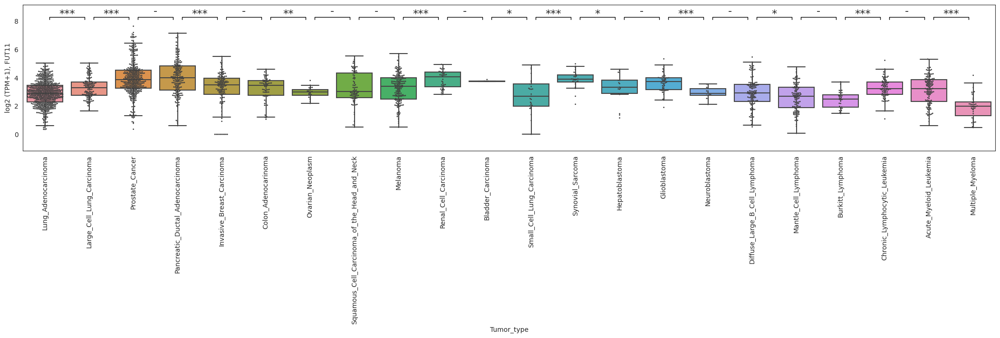

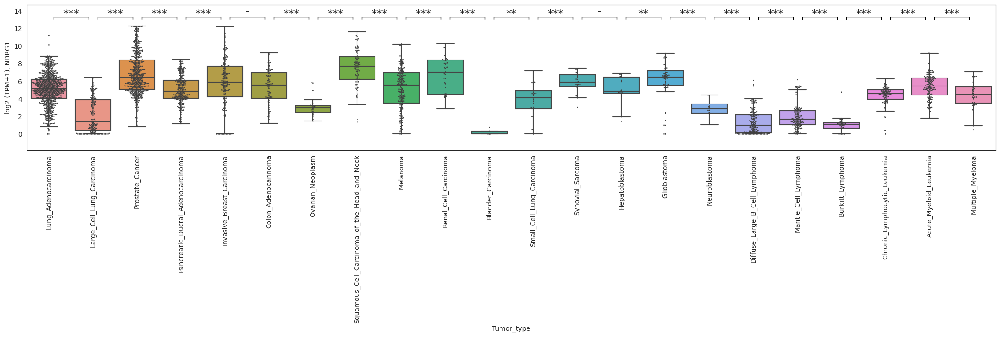

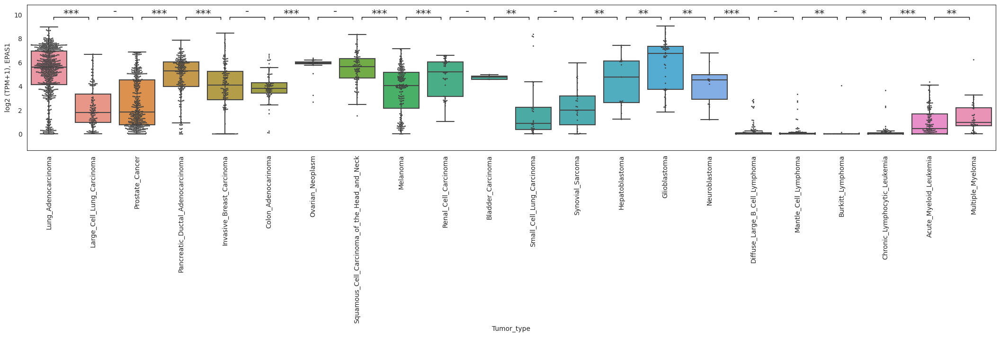

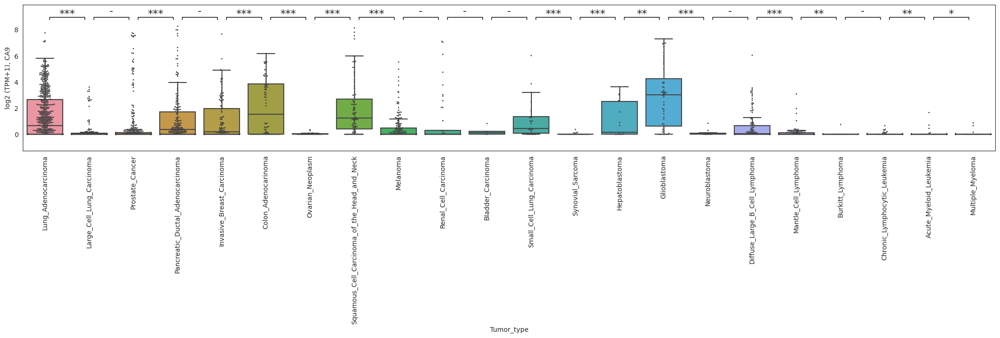

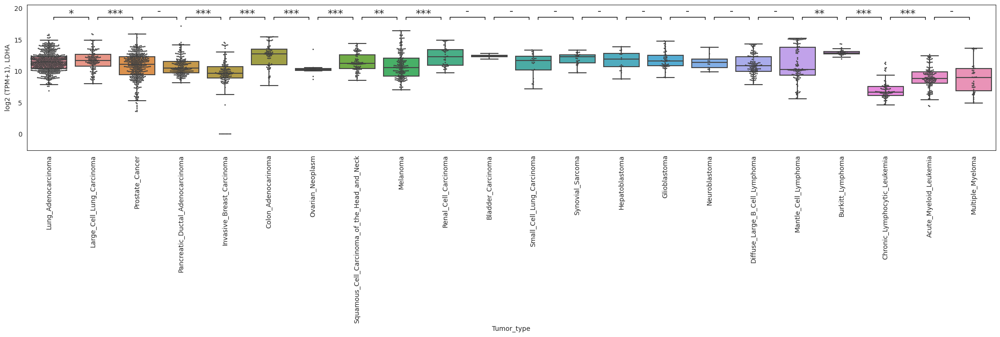

...

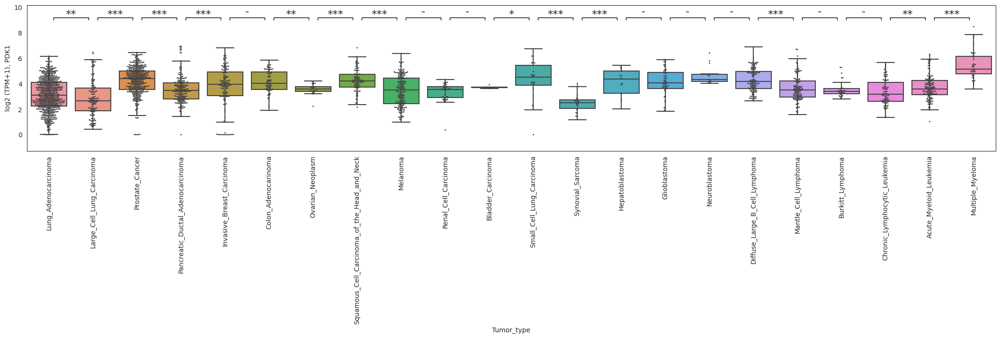

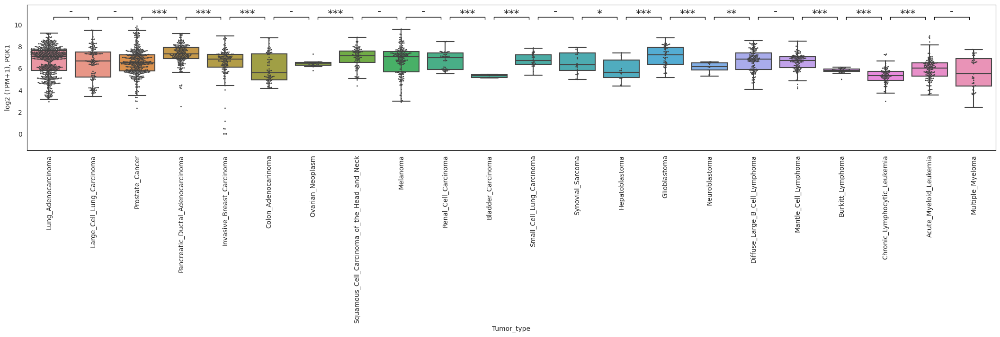

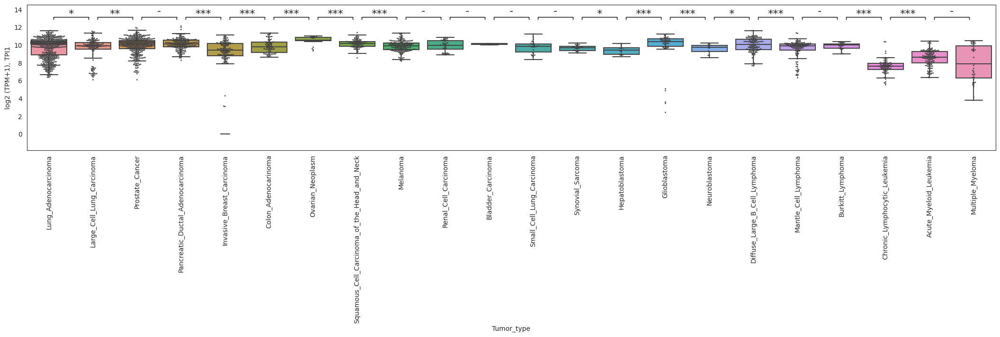

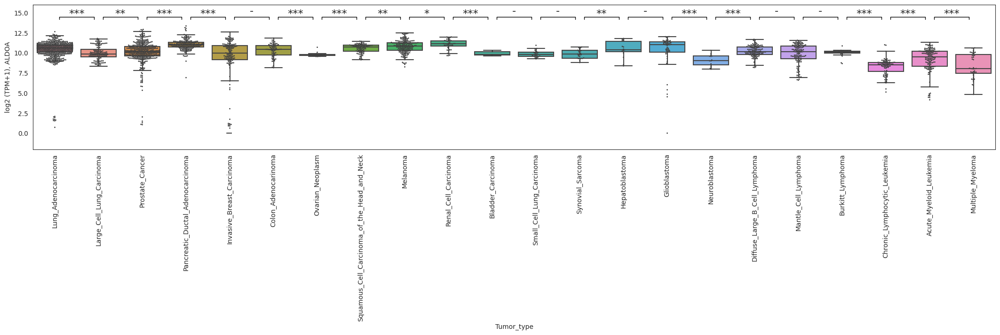

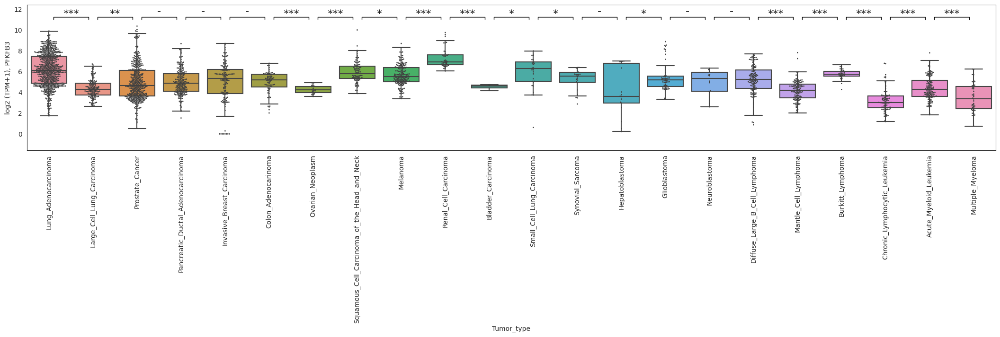

In [ ]:
# boxplots depicting signature genes expression in diagnoses of interest

categories = [
    "Lung_Adenocarcinoma",
    "Large_Cell_Lung_Carcinoma",
    "Prostate_Cancer",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Invasive_Breast_Carcinoma",
    "Colon_Adenocarinoma",
    "Ovarian_Neoplasm",
    "Squamous_Cell_Carcinoma_of_the_Head_and_Neck",
    "Melanoma",
    "Renal_Cell_Carcinoma",
    "Bladder_Carcinoma",
    "Small_Cell_Lung_Carcinoma",
    "Synovial_Sarcoma",
    "Hepatoblastoma",
    "Glioblastoma",
    "Neuroblastoma",
    "Diffuse_Large_B_Cell_Lymphoma",
    "Mantle_Cell_Lymphoma",
    "Burkitt_Lymphoma",
    "Chronic_Lymphocytic_Leukemia",
    "Acute_Myeloid_Leukemia",
    "Multiple_Myeloma",
]

for gene in signature_of_interest:
    boxplot_with_pvalue(
        cancer_cells_expressions_to_use.loc[gene],
        annot[annot["Tumor_type"].isin(categories)]["Tumor_type"],
        order=categories,
        s=2,
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
cancer_cells_ssgsea_unscaled = ssgsea_formula(
    cancer_cells_expressions_to_use,
    gmt_genes_alt_names(
        geneset_of_interest, cancer_cells_expressions_to_use.index, verbose=False
    ),
).T

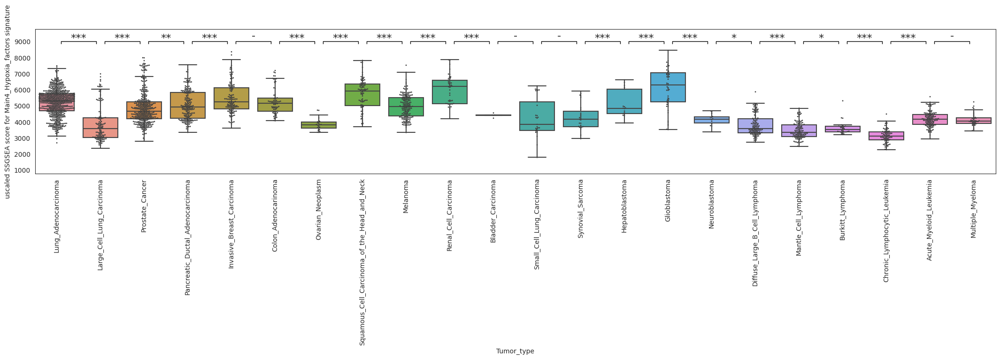

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Lung_Adenocarcinoma",
    "Large_Cell_Lung_Carcinoma",
    "Prostate_Cancer",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Invasive_Breast_Carcinoma",
    "Colon_Adenocarinoma",
    "Ovarian_Neoplasm",
    "Squamous_Cell_Carcinoma_of_the_Head_and_Neck",
    "Melanoma",
    "Renal_Cell_Carcinoma",
    "Bladder_Carcinoma",
    "Small_Cell_Lung_Carcinoma",
    "Synovial_Sarcoma",
    "Hepatoblastoma",
    "Glioblastoma",
    "Neuroblastoma",
    "Diffuse_Large_B_Cell_Lymphoma",
    "Mantle_Cell_Lymphoma",
    "Burkitt_Lymphoma",
    "Chronic_Lymphocytic_Leukemia",
    "Acute_Myeloid_Leukemia",
    "Multiple_Myeloma",
]

boxplot_with_pvalue(
    cancer_cells_ssgsea_unscaled[signature_name],
    annot[annot["Tumor_type"].isin(categories)]["Tumor_type"],
    order=categories,
    s=2,
)

plt.xticks(rotation=90)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

#### HALLMARK_HYPOXIA

In [ ]:
signature_of_interest = """ADM,ADORA2B,AK4,AKAP12,ALDOA,ALDOB,ALDOC,AMPD3,ANGPTL4,ANKZF1,ANXA2,ATF3,ATP7A,B3GALT6,B4GALNT2,BCAN,BCL2,BGN,BHLHE40,BNIP3L,BRS3,BTG1,CA12,CASP6,CAV1,CCNG2,CCRN4L,CDKN1A,CDKN1B,CDKN1C,CHST2,CHST3,CITED2,COL5A1,CP,CSRP2,CTGF,CXCR4,ACKR3,CYR61,DCN,DDIT3,DDIT4,DPYSL4,DTNA,DUSP1,EDN2,EFNA1,EFNA3,EGFR,ENO1,ENO2,ENO3,ERO1L,ERRFI1,ETS1,EXT1,F3,FAM162A,FBP1,FOS,FOSL2,FOXO3,GAA,GALK1,GAPDH,GAPDHS,GBE1,GCK,GCNT2,GLRX,GPC1,GPC3,GPC4,GPI,GRHPR,GYS1,HAS1,HDLBP,HEXA,HK1,HK2,HMOX1,HOXB9,HS3ST1,HSPA5,IDS,IER3,IGFBP1,IGFBP3,IL6,ILVBL,INHA,IRS2,ISG20,JMJD6,JUN,KDELR3,KDM3A,KIF5A,KLF6,KLF7,KLHL24,LALBA,LARGE,LDHA,LDHC,LOX,LXN,MAFF,MAP3K1,MIF,MT1E,MT2A,MXI1,MYH9,NAGK,NCAN,NDRG1,NDST1,NDST2,NEDD4L,NFIL3,NR3C1,P4HA1,P4HA2,PAM,PCK1,PDGFB,PDK1,PDK3,PFKFB3,PFKL,PFKP,PGAM2,PGF,PGK1,PGM1,PGM2,PHKG1,PIM1,PKLR,PKP1,PLAC8,PLAUR,PLIN2,PNRC1,PPARGC1A,PPFIA4,PPP1R15A,PPP1R3C,PRDX5,PRKCA,PRKCDBP,PTRF,PYGM,RBPJ,RORA,RRAGD,S100A4,SAP30,SCARB1,SDC2,SDC3,SDC4,SELENBP1,SERPINE1,SIAH2,SLC25A1,SLC2A1,SLC2A3,SLC2A5,SLC37A4,SLC6A6,SRPX,STC1,STC2,SULT2B1,TES,TGFB3,TGFBI,TGM2,TIPARP,TKTL1,TMEM45A,TNFAIP3,TPBG,TPD52,TPI1,TPST2,UGP2,VEGFA,VHL,VLDLR,WISP2,WSB1,XPNPEP1,ZFP36,ZNF292""".split(
    ","
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']
# STBD1,
# add here a custon signature name (as a first input)
signature_name = "HALLMARK_HYPOXIA"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
cancer_cells_ssgsea_unscaled = ssgsea_formula(
    cancer_cells_expressions_to_use,
    gmt_genes_alt_names(
        geneset_of_interest, cancer_cells_expressions_to_use.index, verbose=False
    ),
).T

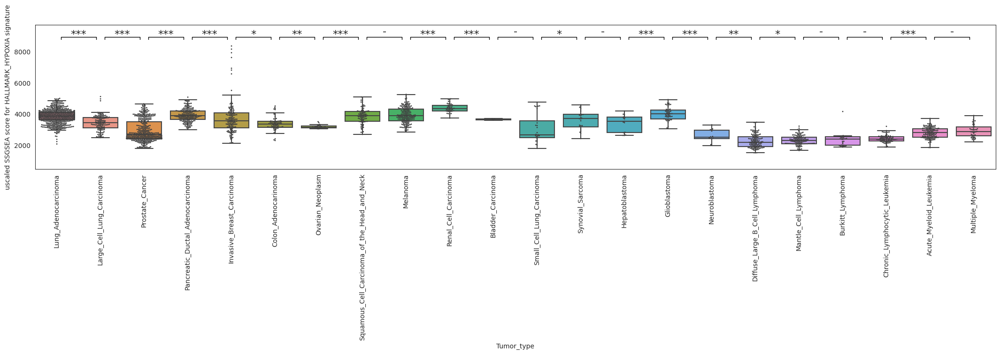

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Lung_Adenocarcinoma",
    "Large_Cell_Lung_Carcinoma",
    "Prostate_Cancer",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Invasive_Breast_Carcinoma",
    "Colon_Adenocarinoma",
    "Ovarian_Neoplasm",
    "Squamous_Cell_Carcinoma_of_the_Head_and_Neck",
    "Melanoma",
    "Renal_Cell_Carcinoma",
    "Bladder_Carcinoma",
    "Small_Cell_Lung_Carcinoma",
    "Synovial_Sarcoma",
    "Hepatoblastoma",
    "Glioblastoma",
    "Neuroblastoma",
    "Diffuse_Large_B_Cell_Lymphoma",
    "Mantle_Cell_Lymphoma",
    "Burkitt_Lymphoma",
    "Chronic_Lymphocytic_Leukemia",
    "Acute_Myeloid_Leukemia",
    "Multiple_Myeloma",
]

boxplot_with_pvalue(
    cancer_cells_ssgsea_unscaled[signature_name],
    annot[annot["Tumor_type"].isin(categories)]["Tumor_type"],
    order=categories,
    s=2,
)

plt.xticks(rotation=90)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

# Signature validation: pancan data (TCGA)

### Definition of custom signature (once again, same as above)

In [ ]:
signature_of_interest = """FUT11	NDRG1	EPAS1	CA9	LDHA	LOX	SLC2A1	P4HA1	CA12	HK2	PDK1	PGK1	TPI1	ALDOA	PFKFB3""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']

# add here a custon signature name (as a first input)
signature_name = "Main4_Hypoxia_factors"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
# list all TCGA cohorts with expressions available
print("TCGA cohorts available:")
os.listdir("/uftp2/Datasets/TCGA/current_version/data/recombined_cohorts/")

TCGA cohorts available:


['TCGA-Astrocytoma',
 'TCGA-BLCA',
 'TCGA-CESC_AC',
 'TCGA-CESC_SCC',
 'TCGA-CHOL',
 'TCGA-DLBC',
 'TCGA-HNE_SCC',
 'TCGA-KICH',
 'TCGA-LIHC',
 'TCGA-OV',
 'TCGA-PAAD',
 'TCGA-PCPG',
 'TCGA-SKCM',
 'TCGA-THCA',
 'TCGA-ACC',
 'TCGA-BRCA_Basal',
 'TCGA-BRCA_Her2',
 'TCGA-BRCA_LumiNorm',
 'TCGA-COREAD',
 'TCGA-ESGA_AC',
 'TCGA-Glioblastoma',
 'TCGA-KIRC',
 'TCGA-KIRP',
 'TCGA-LAML',
 'TCGA-LUAD',
 'TCGA-LUSC',
 'TCGA-MESO',
 'TCGA-Oligodendroglioma',
 'TCGA-PRAD',
 'TCGA-SARC',
 'TCGA-TGCT',
 'TCGA-THYM',
 'TCGA-UCEC',
 'TCGA-UCS',
 'TCGA-UVM']

In [ ]:
# list all uftp cohorts with expressions available - here we do not show TCGA cohorts, as we take them from separate
# folder
print("Other cohorts available:")
other = os.listdir("/uftp/mvp-data/cohorts/")
for i in other:
    if "TCGA" not in i:
        print(i)

Other cohorts available:
LUAD
Meningioma
KIRC
PAAD
MCL
OV
ALCL
Leiomyosarcoma
AITL
LUSC
MESO
LIHC
PanSolid
THCA
Multiple_Myeloma
SKCM
TGCT
CHOL
KIRP
AML
Liposarcoma
THYM_without_TC
PTCL-NOS
ACC
Pancreatic_NET
PTCL_LN
CSCC-polyA
DLBCL-polyA
Esthesioneuroblastoma
PanPTCL_LN
FL
KICH
NKTCL
UCEC
SARC
PTCL_blood
no_cohort_solid
no_cohort_hematological
PanHeme
PRAD
BLCA
UCS
no_cohort
BG_NEC
PCPG
CTCL
THYM
BG_PanSolid
UVM
AdCC
NPC
FL-HCC
BG_FL-HCC


## read anno and expressions

In [ ]:
cohorts = [
    "TCGA-Astrocytoma",
    "TCGA-BLCA",
    "TCGA-CESC_AC",
    "TCGA-CESC_SCC",
    "TCGA-CHOL",
    "TCGA-DLBC",
    "TCGA-HNE_SCC",
    "TCGA-KICH",
    "TCGA-LIHC",
    "TCGA-OV",
    "TCGA-PAAD",
    "TCGA-PCPG",
    "TCGA-SKCM",
    "TCGA-THCA",
    "TCGA-ACC",
    "TCGA-BRCA_Basal",
    "TCGA-BRCA_Her2",
    "TCGA-BRCA_LumiNorm",
    "TCGA-COREAD",
    "TCGA-ESGA_AC",
    "TCGA-Glioblastoma",
    "TCGA-KIRC",
    "TCGA-KIRP",
    "TCGA-LUAD",
    "TCGA-LUSC",
    "TCGA-MESO",
    "TCGA-Oligodendroglioma",
    "TCGA-PRAD",
    "TCGA-SARC",
    "TCGA-TGCT",
    "TCGA-THYM",
    "TCGA-UCEC",
    "TCGA-UCS",
    "TCGA-UVM",
]

In [ ]:
tcga_expressions = {}
tcga_ssgsea = {}
tcga_ssgsea_unscaled = {}

for cohort in cohorts:
    e = get_expression_table(cohort, log=True).T
    s = ssgsea_formula(
        e, gmt_genes_alt_names(geneset_of_interest, e.index, verbose=False)
    ).T
    tcga_expressions[cohort] = e
    tcga_ssgsea_unscaled[cohort] = s
    tcga_ssgsea[cohort] = median_scale(s)

In [ ]:
tcga_anno = read_dataset("/uftp2/Datasets/TCGA/current_version/data/annotation.tsv")
tcga_expressions = pd.concat(tcga_expressions.values(), axis=1)
tcga_ssgsea = pd.concat(tcga_ssgsea.values())
tcga_ssgsea_unscaled = pd.concat(tcga_ssgsea_unscaled.values())

Statistics on diagnoses from TCGA

In [ ]:
cmap = plt.cm.tab20
colors = cmap(np.arange(len(tcga_anno["acronym"].value_counts())) % cmap.N)

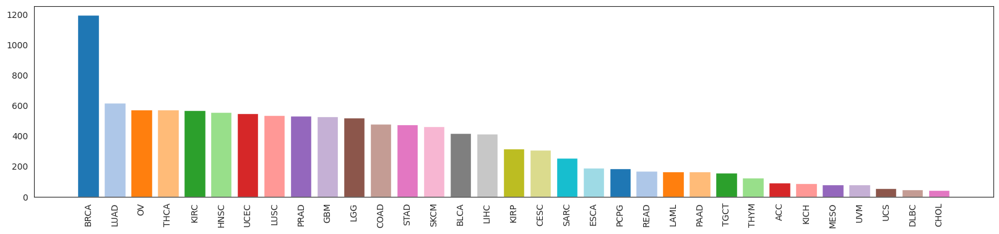

In [ ]:
plt.figure(figsize=(20, 4))
x = tcga_anno["acronym"].value_counts().sort_values(ascending=False)
plt.bar(range(len(x)), x, color=colors)
plt.xticks(range(len(x)), x.index, rotation=90)
plt.show()

In [264]:
tcga_anno.shape

(11537, 39)

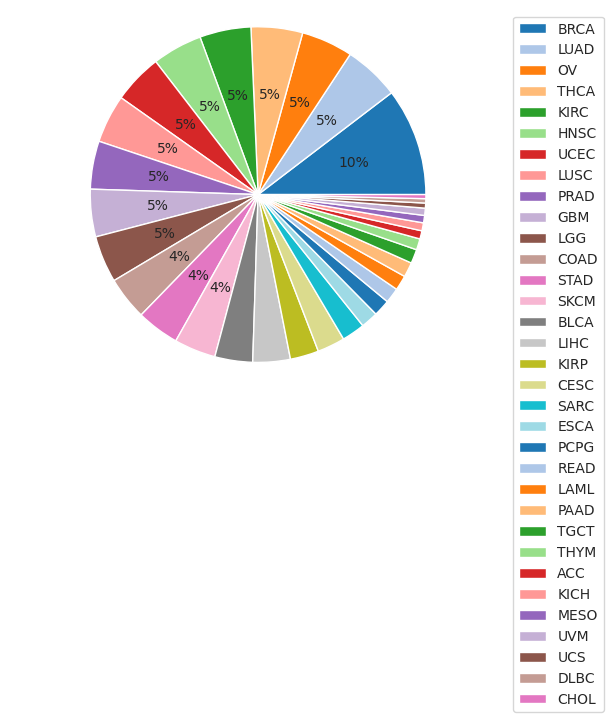

In [ ]:
fig1, ax = plt.subplots()


def autopct_more_than_1(pct):
    return ("%1.f%%" % pct) if pct > 4 else ""


p, t, a = ax.pie(x.values, autopct=autopct_more_than_1, colors=colors)
ax.axis("equal")

# normalize dataframe (not actually needed here, but for general case)
# create handles and labels for legend, take only those where value is > 1
h, l = zip(*[(h, lab) for h, lab, i in zip(p, x.index.values, x.values) if i > 1])

ax.legend(h, l, loc="best", bbox_to_anchor=(1, 1))

plt.show()

## deconvolution calculation

Temporary solution: now we have multiple models for deconvolution (see list of all available models below). 
You can pick any model suitable for you.

In [ ]:
from mldeconv.prediction import predict

In [ ]:
with open(
    "/uftp/Deconvolution/product/models/configs/product/model_v1_tumor.yaml", "r"
) as f:
    pred_config = yaml.load(f, Loader=yaml.FullLoader)
tcga_deconv = predict(2 ** (tcga_expressions) - 1, pred_config)
tcga_deconv

2024-06-07 17:23:29.186 | INFO     | mldeconv.cells_utils:timeit_wrapper:676 - Function load took 1.4417 seconds.
2024-06-07 17:23:37.086 | INFO     | mldeconv.cells_utils:timeit_wrapper:676 - Function predict_l1 took 6.3969 seconds.
2024-06-07 17:23:37.089 | INFO     | mldeconv.cells_utils:timeit_wrapper:676 - Function predict took 7.9025 seconds.


,TCGA-P5-A733-01,TCGA-HT-7601-01,TCGA-WY-A85D-01,TCGA-HT-A618-01,TCGA-DU-6408-01,TCGA-FG-5965-02,TCGA-DU-7306-01,TCGA-DU-6396-01,TCGA-DU-8166-01,TCGA-TQ-A8XE-02,...,TCGA-V4-A9EO-01,TCGA-V4-A9EL-01,TCGA-V4-A9F1-01,TCGA-VD-A8KA-01,TCGA-V4-A9F7-01,TCGA-VD-AA8P-01,TCGA-V4-A9F8-01,TCGA-VD-AA8N-01,TCGA-V4-A9EM-01,TCGA-WC-A87W-01
B_cells,0.036262,0.025204,0.034615,0.025572,0.051125,0.000000,0.044840,0.036465,0.042781,0.000897,...,0.004037,0.048547,0.006727,0.023850,0.005909,0.018844,0.007226,0.041932,0.000969,0.018935
CD4_T_cells,0.003926,0.018993,0.005593,0.007058,0.011974,0.013104,0.006393,0.007030,0.009430,0.009092,...,0.008960,0.000000,0.007857,0.010348,0.008815,0.005920,0.002393,0.030133,0.006065,0.017991
CD8_T_cells,0.004453,0.000000,0.000000,0.000462,0.002604,0.007333,0.001709,0.006053,0.002820,0.000574,...,0.006188,0.120110,0.004490,0.002459,0.002581,0.005057,0.009473,0.033358,0.004739,0.005232
CD8_T_cells_PD1_high,0.001608,0.000000,0.000000,0.000187,0.001071,0.005175,0.000641,0.000000,0.000839,0.000388,...,0.001718,0.059013,0.001763,0.000183,0.000928,0.001442,0.002214,0.009727,0.002134,0.001540
CD8_T_cells_PD1_low,0.002845,0.000000,0.000000,0.000274,0.001533,0.002159,0.001068,0.006053,0.001981,0.000186,...,0.004470,0.061097,0.002727,0.002276,0.001653,0.003615,0.007260,0.023631,0.002605,0.003693
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Myeloid_cells,0.102798,0.413966,0.206631,0.310797,0.165321,0.224645,0.175416,0.398507,0.190541,0.215254,...,0.055862,0.177763,0.142710,0.078235,0.033232,0.058854,0.107803,0.117889,0.103028,0.048058
Naive_T_cells,0.000000,0.005094,0.000000,0.001001,0.003866,0.009367,0.000023,0.001036,0.003041,0.000287,...,0.006188,0.045338,0.004490,0.002459,0.003488,0.005057,0.006264,0.034478,0.004739,0.010197
Stromal_cells,0.059904,0.072172,0.055498,0.059475,0.062881,0.074549,0.053349,0.059069,0.073759,0.092579,...,0.025479,0.029557,0.031589,0.018809,0.014272,0.026607,0.030144,0.026528,0.026963,0.043039
Memory_T_cells,0.008125,0.012437,0.005593,0.006128,0.010712,0.008315,0.007312,0.011303,0.009164,0.008295,...,0.008960,0.074771,0.007080,0.010023,0.006052,0.005167,0.005603,0.027815,0.005247,0.009457


## Validation

### train-test split

In [ ]:
tcga_expressions, tcga_anno = to_common_samples([tcga_expressions.T, tcga_anno])
tcga_expressions = tcga_expressions.T

t_expr_train, t_expr_test, t_d_train, t_d_test = train_test_split(
    tcga_expressions.T,
    tcga_anno["acronym"],
    stratify=tcga_anno["acronym"],
    random_state=42,
    train_size=0.75,
)

First, select if you want to use train data to add/remove genes to your signature, or test data to make you did not 'adjust' your data to describe train dataset best

In [ ]:
# type 'train' or 'test' below
train_or_test = "None"
if train_or_test == "train":
    tcga_expressions_to_use = t_expr_train.T
elif train_or_test == "test":
    tcga_expressions_to_use = t_expr_test.T
else:
    tcga_expressions_to_use = tcga_expressions

### Check if all genes in signatures are expressed (in progress!)

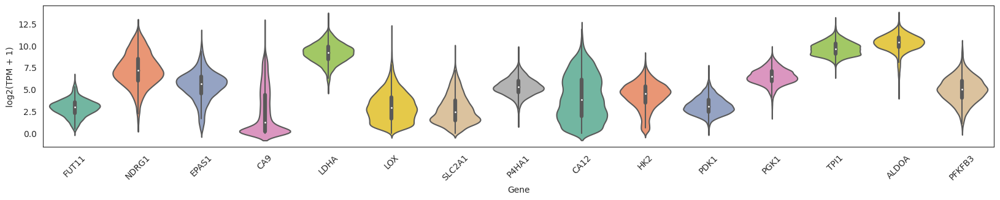

In [ ]:
df = tcga_expressions_to_use.loc[signature_of_interest]
data = pd.melt(df.T)
data["KDE"] = "Gene"

plt.figure(figsize=(20, 3))
sns.violinplot(
    x="Gene",
    y="value",
    data=pd.concat([data]),
    palette="Set2",
    split=True,
    scale="count",
    inner="box",
)

plt.ylabel("log2(TPM + 1)")
plt.xticks(rotation=45)
plt.show()

In [ ]:
gmt = read_dataset("genesets_msigdb_hypoxia.gmt")
gmt = {
    j.name: GeneSet(j.name, j.link, set(j[1:].dropna().values))
    for i, j in gmt.iterrows()
}

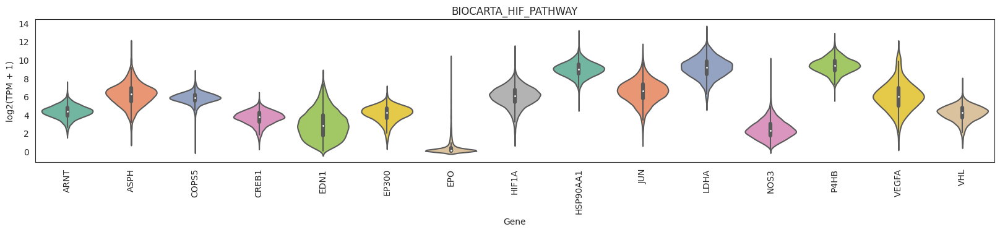

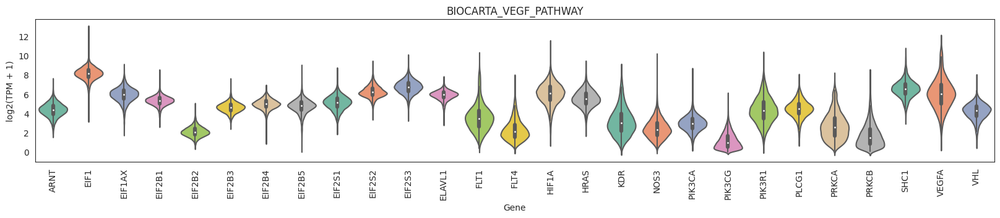

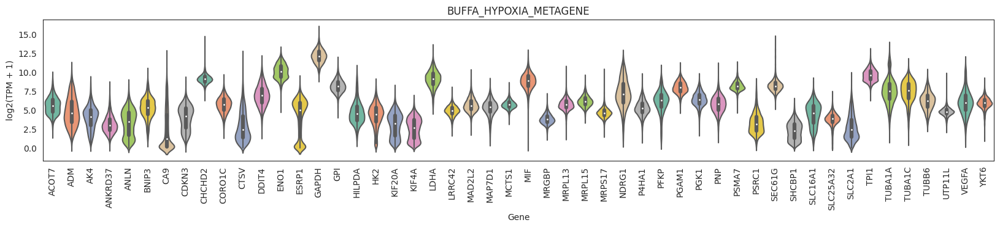

Exception ignored in: <function tqdm.__del__ at 0x7f8b930256c0>
Traceback (most recent call last):
  File "/home/jovyan/bior310/lib/python3.10/site-packages/tqdm/std.py", line 1148, in __del__
    self.close()
  File "/home/jovyan/bior310/lib/python3.10/site-packages/tqdm/notebook.py", line 279, in close
    self.disp(bar_style='danger', check_delay=False)
AttributeError: 'tqdm_notebook' object has no attribute 'disp'


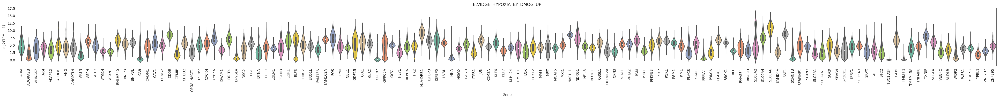

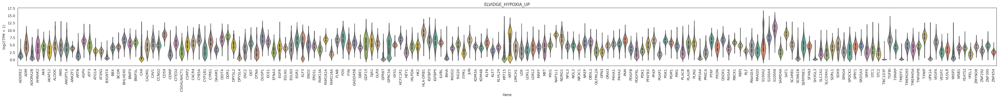

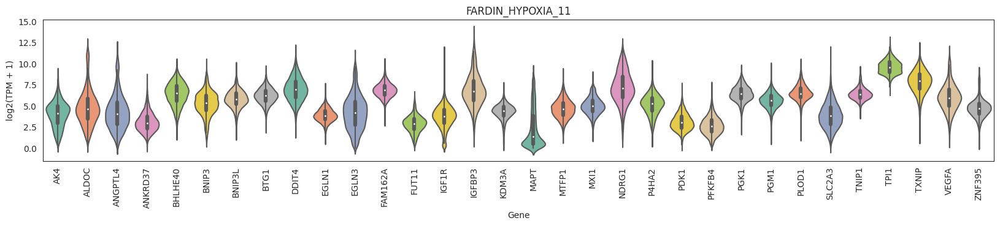

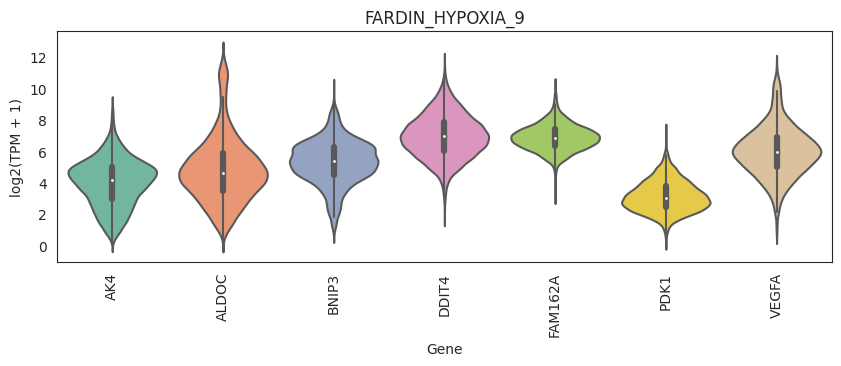

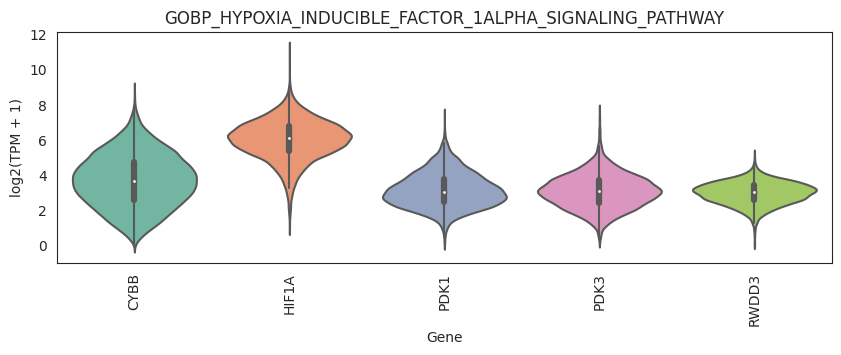

...

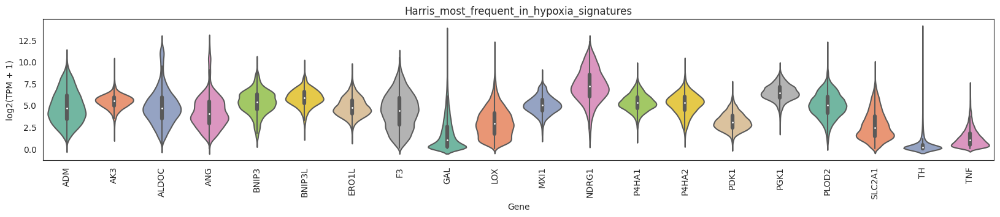

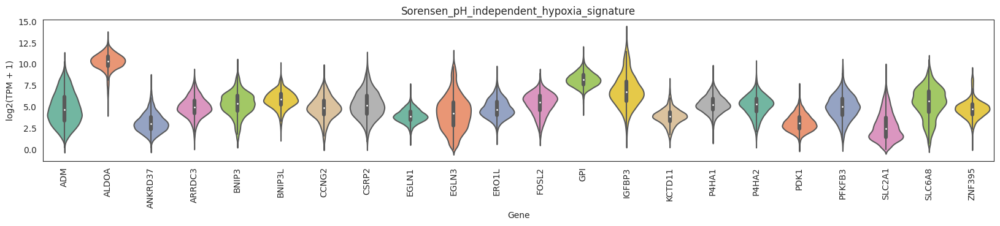

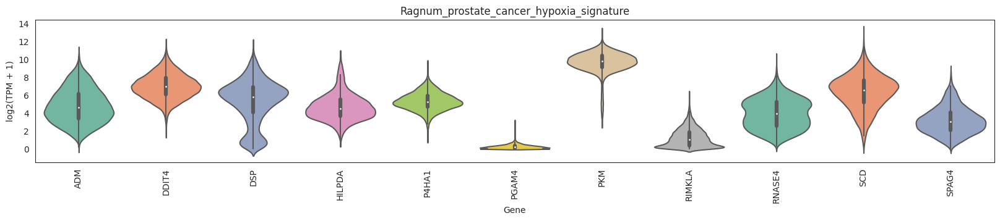

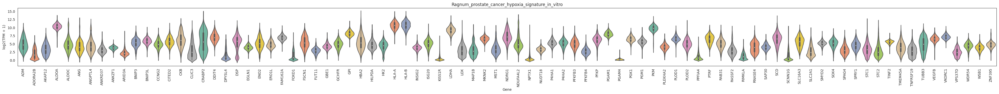

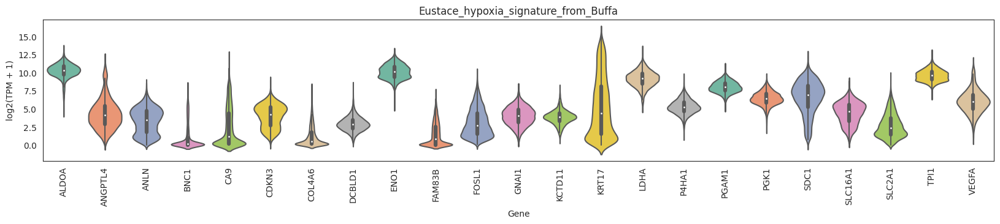

In [ ]:
for i in gmt.keys():
    df = tcga_expressions_to_use.loc[
        np.intersect1d(
            list(
                update_gene_names(gmt[i].genes, tcga_expressions_to_use.index).values()
            ),
            tcga_expressions_to_use.index,
        )
    ]
    data = pd.melt(df.T)
    data["KDE"] = "Gene"
    if len(gmt[i].genes) <= 10:
        w = 10
    elif len(gmt[i].genes) <= 100:
        w = 20
    else:
        w = 50
    plt.figure(figsize=(w, 3))
    sns.violinplot(
        x="Gene",
        y="value",
        data=pd.concat([data]),
        palette="Set2",
        split=True,
        scale="count",
        inner="box",
    )
    plt.title(i)
    plt.ylabel("log2(TPM + 1)")
    plt.xticks(rotation=90, fontsize=10)
    plt.rcParams["svg.fonttype"] = "none"
    #    plt.savefig(f"/uftp/users/msavchenko/figures/Hypoxia_violin_{i}.svg", format="svg")
    plt.show()

### Check if there are anticorrelating genes

Figure 5A

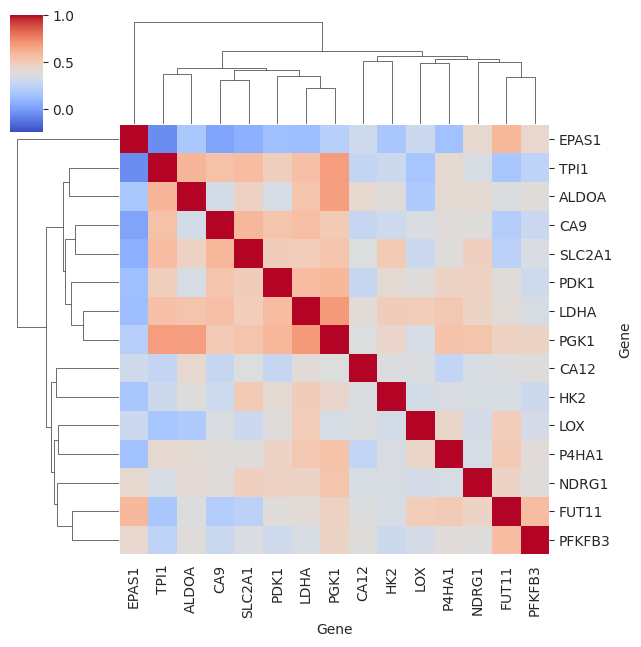

In [ ]:
sns.clustermap(
    tcga_expressions.T[signature_of_interest].corr(method="spearman"),
    figsize=(6.5, 6.5),
    cmap=default_cmap,
    annot=False,
    annot_kws={"fontsize": 10},
    vmin=-0.25,
    vmax=1,
)
# plt.title(signature_name, loc='center')
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Hypoxia_signature_correlation_clustermap_PanCan.svg",
    format="svg",
)
plt.show()

### HALLMARK_HYPOXIA

In [ ]:
signature_of_interest = """ADM,ADORA2B,AK4,AKAP12,ALDOA,ALDOB,ALDOC,AMPD3,ANGPTL4,ANKZF1,ANXA2,ATF3,ATP7A,B3GALT6,B4GALNT2,BCAN,BCL2,BGN,BHLHE40,BNIP3L,BRS3,BTG1,CA12,CASP6,CAV1,CCNG2,CCRN4L,CDKN1A,CDKN1B,CDKN1C,CHST2,CHST3,CITED2,COL5A1,CP,CSRP2,CTGF,CXCR4,ACKR3,CYR61,DCN,DDIT3,DDIT4,DPYSL4,DTNA,DUSP1,EDN2,EFNA1,EFNA3,EGFR,ENO1,ENO2,ENO3,ERO1L,ERRFI1,ETS1,EXT1,F3,FAM162A,FBP1,FOS,FOSL2,FOXO3,GAA,GALK1,GAPDH,GAPDHS,GBE1,GCK,GCNT2,GLRX,GPC1,GPC3,GPC4,GPI,GRHPR,GYS1,HAS1,HDLBP,HEXA,HK1,HK2,HMOX1,HOXB9,HS3ST1,HSPA5,IDS,IER3,IGFBP1,IGFBP3,IL6,ILVBL,INHA,IRS2,ISG20,JMJD6,JUN,KDELR3,KDM3A,KIF5A,KLF6,KLF7,KLHL24,LALBA,LARGE,LDHA,LDHC,LOX,LXN,MAFF,MAP3K1,MIF,MT1E,MT2A,MXI1,MYH9,NAGK,NCAN,NDRG1,NDST1,NDST2,NEDD4L,NFIL3,NR3C1,P4HA1,P4HA2,PAM,PCK1,PDGFB,PDK1,PDK3,PFKFB3,PFKL,PFKP,PGAM2,PGF,PGK1,PGM1,PGM2,PHKG1,PIM1,PKLR,PKP1,PLAC8,PLAUR,PLIN2,PNRC1,PPARGC1A,PPFIA4,PPP1R15A,PPP1R3C,PRDX5,PRKCA,PRKCDBP,PTRF,PYGM,RBPJ,RORA,RRAGD,S100A4,SAP30,SCARB1,SDC2,SDC3,SDC4,SELENBP1,SERPINE1,SIAH2,SLC25A1,SLC2A1,SLC2A3,SLC2A5,SLC37A4,SLC6A6,SRPX,STC1,STC2,SULT2B1,TES,TGFB3,TGFBI,TGM2,TIPARP,TKTL1,TMEM45A,TNFAIP3,TPBG,TPD52,TPI1,TPST2,UGP2,VEGFA,VHL,VLDLR,WISP2,WSB1,XPNPEP1,ZFP36,ZNF292""".split(
    ","
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']
# STBD1,
# add here a custon signature name (as a first input)
signature_name = "HALLMARK_HYPOXIA"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

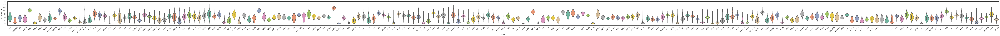

In [ ]:
df = tcga_expressions_to_use.loc[signature_of_interest]
data = pd.melt(df.T)
data["KDE"] = "Gene"

plt.figure(figsize=(120, 3))
sns.violinplot(
    x="Gene",
    y="value",
    data=pd.concat([data]),
    palette="Set2",
    split=True,
    scale="count",
    inner="box",
)

plt.ylabel("log2(TPM + 1)")
plt.xticks(rotation=45)
plt.show()

In [ ]:
sns.clustermap(
    tcga_expressions.T[signature_of_interest].corr(method="spearman"),
    figsize=(120, 120),
    cmap=default_cmap,
    annot=False,
    annot_kws={"fontsize": 10},
    vmin=-0.25,
    vmax=1,
)
# plt.title(signature_name, loc='center')
plt.show()

In [ ]:
signature_of_interest = """FUT11	NDRG1	EPAS1	CA9	LDHA	LOX	SLC2A1	P4HA1	CA12	HK2	PDK1	PGK1	TPI1	ALDOA	PFKFB3""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']

# add here a custon signature name (as a first input)
signature_name = "Main4_Hypoxia_factors"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

### Check if this signature overlaps/correlates with existing signatures from Chess DB

In [ ]:
PROCESSES_LIST = []
manual_genesets = {
    "Autophagy_Up": {
        "MAP1LC3B",
        "VMP1",
        "GABARAP",
        "ATG14",
        "GABARAPL1",
        "NBR1",
        "ATG9A",
        "TFEB",
        "RB1CC1",
        "ATG7",
        "ATG4B",
        "ATG12",
        "ATG13",
        "GABARAPL2",
    },
    #    'Apoptosis_Up': {'BAX', 'BAK1', 'BID', 'BCL2L11', 'BBC3', 'PMAIP1', 'HRK', 'FAS', 'TNFRSF10A', 'TNFRSF10B', 'FADD', 'CASP8', 'CASP9', 'APAF1', 'AIFM1', 'XAF1'},
    "Apoptosis_Down": {
        "BCL2",
        "BCL2L1",
        "BCL2L2",
        "BCL2A1",
        "MCL1",
        "XIAP",
        "BIRC2",
        "BIRC3",
        "BIRC5",
        "CFLAR",
        "TNFRSF10D",
    },
    "Proliferation_rate": {
        "MKI67",
        "ESCO2",
        "CETN3",
        "CDK2",
        "CCND1",
        "CCNE1",
        "AURKA",
        "AURKB",
        "E2F1",
        "MYBL2",
        "BUB1",
        "PLK1",
        "CCNB1",
        "MCM2",
        "MCM6",
    },
    "Senescence_Up": {
        "CDKN2A",
        "CDKN1A",
        "CDKN2B",
        "GLB1",
        "SERPINE1",
        "DPP4",
        "CEBPB",
        "BCL2L1",
        "BCL2L2",
        "TNFRSF10D",
        "ITGB3",
        "IGFBP3",
        "MMP3",
        "CCL2",
        "IL6",
        "CXCL8",
        "CXCL1",
        "IL1B",
        "TGFB1",
        "GDF15",
        "IGFBP7",
        "PLAU",
        "STAT1",
        "IGFBP2",
        "ATF3",
    },
    "Senescence_Down": {
        "LMNB1",
        "CCNA2",
        "CCNB1",
        "CCNB2",
        "EZH2",
        "BMI1",
        "SIRT1",
        "FOXM1",
        "TWIST1",
        "AURKA",
        "AURKB",
        "DNMT1",
        "NFE2L2",
        "ID1",
        "HNRNPD",
    },
    #    'Apoptosis_Up_new': {'BCL2L11', 'PMAIP1', 'FAS', 'TNFRSF10A', 'TNFRSF10B', 'CASP8', 'APAF1', 'XAF1'},
    "HALLMARK_APOPTOSIS": {
        "ADD1",
        "AIFM3",
        "ANKH",
        "ANXA1",
        "APP",
        "ATF3",
        "AVPR1A",
        "BAX",
        "BCAP31",
        "BCL10",
        "BCL2L1",
        "BCL2L10",
        "BCL2L11",
        "BCL2L2",
        "BGN",
        "BID",
        "BIK",
        "BIRC3",
        "BMF",
        "BMP2",
        "BNIP3L",
        "BRCA1",
        "BTG2",
        "BTG3",
        "CASP1",
        "CASP2",
        "CASP3",
        "CASP4",
        "CASP6",
        "CASP7",
        "CASP8",
        "CASP9",
        "CAV1",
        "CCNA1",
        "CCND1",
        "CCND2",
        "CD14",
        "CD2",
        "CD38",
        "CD44",
        "CD69",
        "CDC25B",
        "CDK2",
        "CDKN1A",
        "CDKN1B",
        "CFLAR",
        "CLU",
        "CREBBP",
        "CTH",
        "CTNNB1",
        "CYLD",
        "DAP",
        "DAP3",
        "DCN",
        "DDIT3",
        "DFFA",
        "DIABLO",
        "DNAJA1",
        "DNAJC3",
        "DNM1L",
        "DPYD",
        "EBP",
        "EGR3",
        "EMP1",
        "ENO2",
        "ERBB2",
        "ERBB3",
        "EREG",
        "ETF1",
        "F2",
        "F2R",
        "FAS",
        "FASLG",
        "FDXR",
        "FEZ1",
        "GADD45A",
        "GADD45B",
        "GCH1",
        "GNA15",
        "GPX1",
        "GPX3",
        "GPX4",
        "GSN",
        "GSR",
        "GSTM1",
        "GUCY2D",
        "H1F0",
        "HGF",
        "HMGB2",
        "HMOX1",
        "HSPB1",
        "IER3",
        "IFITM3",
        "IFNB1",
        "IFNGR1",
        "IGF2R",
        "IGFBP6",
        "IL18",
        "IL1A",
        "IL1B",
        "IL6",
        "IRF1",
        "ISG20",
        "JUN",
        "KRT18",
        "LEF1",
        "LGALS3",
        "LMNA",
        "LPPR4",
        "LUM",
        "MADD",
        "MCL1",
        "MGMT",
        "MMP2",
        "NEDD9",
        "NEFH",
        "PAK1",
        "PDCD4",
        "PDGFRB",
        "PEA15",
        "PLAT",
        "PLCB2",
        "PMAIP1",
        "PPP2R5B",
        "PPP3R1",
        "PPT1",
        "PRF1",
        "PSEN1",
        "PSEN2",
        "PTK2",
        "RARA",
        "RELA",
        "RETSAT",
        "RHOB",
        "RHOT2",
        "RNASEL",
        "ROCK1",
        "SAT1",
        "SATB1",
        "SC5D",
        "SLC20A1",
        "SMAD7",
        "SOD1",
        "SOD2",
        "SPTAN1",
        "SQSTM1",
        "TAP1",
        "TGFB2",
        "TGFBR3",
        "TIMP1",
        "TIMP2",
        "TIMP3",
        "TNF",
        "TNFRSF12A",
        "TNFSF10",
        "TOP2A",
        "TSPO",
        "TXNIP",
        "VDAC2",
        "WEE1",
        "XIAP",
    },
    "Apoptosis_Up": {
        "BCL10",
        "BIK",
        "CASP2",
        "CASP3",
        "CASP6",
        "CASP7",
        "CASP8",
        "CYLD",
        "FAS",
        "IER3",
        "PMAIP1",
        "TNFRSF12A",
        "BCL2L11",
        "TNFRSF10A",
        "TNFRSF10B",
        "APAF1",
        "XAF1",
        "CASP8AP2",
    },
    "Hypoxia": {
        "FUT11",
        "NDRG1",
        "EPAS1",
        "CA9",
        "LDHA",
        "LOX",
        "SLC2A1",
        "P4HA1",
        "CA12",
        "HK2",
        "PDK1",
        "PGK1",
        "TPI1",
        "ALDOA",
        "PFKFB3",
    },
    "HALLMARK_HYPOXIA": {
        "ADM",
        "ADORA2B",
        "AK4",
        "AKAP12",
        "ALDOA",
        "ALDOB",
        "ALDOC",
        "AMPD3",
        "ANGPTL4",
        "ANKZF1",
        "ANXA2",
        "ATF3",
        "ATP7A",
        "B3GALT6",
        "B4GALNT2",
        "BCAN",
        "BCL2",
        "BGN",
        "BHLHE40",
        "BNIP3L",
        "BRS3",
        "BTG1",
        "CA12",
        "CASP6",
        "CAV1",
        "CCNG2",
        "CCRN4L",
        "CDKN1A",
        "CDKN1B",
        "CDKN1C",
        "CHST2",
        "CHST3",
        "CITED2",
        "COL5A1",
        "CP",
        "CSRP2",
        "CTGF",
        "CXCR4",
        "ACKR3",
        "CYR61",
        "DCN",
        "DDIT3",
        "DDIT4",
        "DPYSL4",
        "DTNA",
        "DUSP1",
        "EDN2",
        "EFNA1",
        "EFNA3",
        "EGFR",
        "ENO1",
        "ENO2",
        "ENO3",
        "ERO1L",
        "ERRFI1",
        "ETS1",
        "EXT1",
        "F3",
        "FAM162A",
        "FBP1",
        "FOS",
        "FOSL2",
        "FOXO3",
        "GAA",
        "GALK1",
        "GAPDH",
        "GAPDHS",
        "GBE1",
        "GCK",
        "GCNT2",
        "GLRX",
        "GPC1",
        "GPC3",
        "GPC4",
        "GPI",
        "GRHPR",
        "GYS1",
        "HAS1",
        "HDLBP",
        "HEXA",
        "HK1",
        "HK2",
        "HMOX1",
        "HOXB9",
        "HS3ST1",
        "HSPA5",
        "IDS",
        "IER3",
        "IGFBP1",
        "IGFBP3",
        "IL6",
        "ILVBL",
        "INHA",
        "IRS2",
        "ISG20",
        "JMJD6",
        "JUN",
        "KDELR3",
        "KDM3A",
        "KIF5A",
        "KLF6",
        "KLF7",
        "KLHL24",
        "LALBA",
        "LARGE",
        "LDHA",
        "LDHC",
        "LOX",
        "LXN",
        "MAFF",
        "MAP3K1",
        "MIF",
        "MT1E",
        "MT2A",
        "MXI1",
        "MYH9",
        "NAGK",
        "NCAN",
        "NDRG1",
        "NDST1",
        "NDST2",
        "NEDD4L",
        "NFIL3",
        "NR3C1",
        "P4HA1",
        "P4HA2",
        "PAM",
        "PCK1",
        "PDGFB",
        "PDK1",
        "PDK3",
        "PFKFB3",
        "PFKL",
        "PFKP",
        "PGAM2",
        "PGF",
        "PGK1",
        "PGM1",
        "PGM2",
        "PHKG1",
        "PIM1",
        "PKLR",
        "PKP1",
        "PLAC8",
        "PLAUR",
        "PLIN2",
        "PNRC1",
        "PPARGC1A",
        "PPFIA4",
        "PPP1R15A",
        "PPP1R3C",
        "PRDX5",
        "PRKCA",
        "PRKCDBP",
        "PTRF",
        "PYGM",
        "RBPJ",
        "RORA",
        "RRAGD",
        "S100A4",
        "SAP30",
        "SCARB1",
        "SDC2",
        "SDC3",
        "SDC4",
        "SELENBP1",
        "SERPINE1",
        "SIAH2",
        "SLC25A1",
        "SLC2A1",
        "SLC2A3",
        "SLC2A5",
        "SLC37A4",
        "SLC6A6",
        "SRPX",
        "STC1",
        "STC2",
        "SULT2B1",
        "TES",
        "TGFB3",
        "TGFBI",
        "TGM2",
        "TIPARP",
        "TKTL1",
        "TMEM45A",
        "TNFAIP3",
        "TPBG",
        "TPD52",
        "TPI1",
        "TPST2",
        "UGP2",
        "VEGFA",
        "VHL",
        "VLDLR",
        "WISP2",
        "WSB1",
        "XPNPEP1",
        "ZFP36",
        "ZNF292",
    },
}
if manual_genesets:
    gmt_manual = {k: GeneSet(k, "", set(v)) for k, v in manual_genesets.items()}
else:
    gmt_manual = dict()
if PROCESSES_LIST:
    gmt_chess = {k: gmt[k] for k in PROCESSES_LIST}
else:
    gmt_chess = dict()

gmt_final = {**gmt_manual, **gmt_chess}

for process in gmt_final:
    print(process + ":", *gmt_final[process].genes)

Autophagy_Up: MAP1LC3B ATG7 ATG13 ATG9A ATG14 GABARAPL1 GABARAP ATG4B ATG12 NBR1 TFEB VMP1 RB1CC1 GABARAPL2
Apoptosis_Down: TNFRSF10D CFLAR BCL2L2 BCL2A1 BIRC5 BIRC2 BCL2L1 BIRC3 XIAP MCL1 BCL2
Proliferation_rate: CCNE1 AURKB AURKA CCNB1 CCND1 CDK2 E2F1 BUB1 MYBL2 MKI67 CETN3 ESCO2 PLK1 MCM6 MCM2
Senescence_Up: GLB1 TNFRSF10D IGFBP2 ATF3 CDKN2B BCL2L1 STAT1 IGFBP7 CDKN1A TGFB1 BCL2L2 SERPINE1 CCL2 PLAU IL6 CEBPB MMP3 CDKN2A CXCL8 GDF15 CXCL1 ITGB3 IL1B DPP4 IGFBP3
Senescence_Down: FOXM1 CCNA2 AURKB AURKA NFE2L2 CCNB1 BMI1 CCNB2 HNRNPD EZH2 LMNB1 TWIST1 ID1 SIRT1 DNMT1
HALLMARK_APOPTOSIS: F2 BTG3 BCL2L11 GSN ATF3 DAP GPX1 PSEN2 LEF1 FEZ1 MGMT PEA15 PLAT TGFB2 TGFBR3 EMP1 CASP1 NEFH CDK2 IGF2R DNAJC3 CDC25B BMF DCN CASP3 CD69 WEE1 LUM BNIP3L PRF1 VDAC2 CD2 LMNA IFNGR1 DPYD CTNNB1 SOD1 DIABLO TNFRSF12A FASLG IFNB1 RARA CCND2 ETF1 CDKN1A ANKH BCAP31 CTH SATB1 KRT18 CASP8 HMGB2 SQSTM1 CASP6 GADD45B SPTAN1 CD38 TNFSF10 RETSAT SAT1 PSEN1 ERBB3 TOP2A ANXA1 TSPO CASP9 H1F0 CDKN1B ENO2 GUCY2D PL

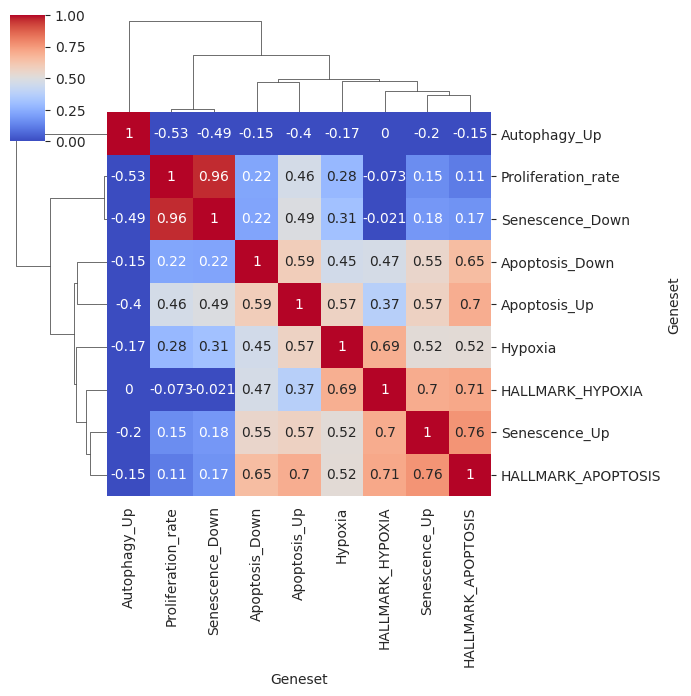

In [ ]:
df = ssgsea_formula(tcga_expressions, gmt_final)
# median scale added
df = median_scale(df.T).T
df.index.name = "Geneset"

clustered_heatmap(df, metric="spearman", vmin=0, vmax=1, figsize=(7, 7))
plt.show()

### Correlation with any celltype from deconvolution

In [ ]:
# list all available celltypes from deconvolution
tcga_deconv.index.tolist()

['B_cells',
 'CD4_T_cells',
 'CD8_T_cells',
 'CD8_T_cells_PD1_high',
 'CD8_T_cells_PD1_low',
 'Central_memory_T_helpers',
 'Class_switched_memory_B_cells',
 'Conventional_T_cells',
 'Cytotoxic_NK_cells',
 'Effector_memory_T_helpers',
 'Endothelium',
 'Fibroblasts',
 'Macrophages',
 'Macrophages_M1',
 'Macrophages_M2',
 'Mature_B_cells',
 'Memory_CD8_T_cells',
 'NK_cells',
 'Naive_B_cells',
 'Naive_CD8_T_cells',
 'Naive_T_helpers',
 'Neutrophils',
 'Non_switched_memory_B_cells',
 'Regulatory_NK_cells',
 'Secreting_B_cells',
 'T_cells',
 'Th17_cells',
 'Th1_cells',
 'Th2_cells',
 'Transitional_memory_T_helpers',
 'Tregs',
 'Other',
 'Lymphoid_cells',
 'Myeloid_cells',
 'Naive_T_cells',
 'Stromal_cells',
 'Memory_T_cells',
 'Tumor']

In [295]:
tcga_deconv_ss, _ = to_common_samples([tcga_deconv.T, tcga_expressions_to_use.T])
tcga_deconv_ss = tcga_deconv_ss.T

tcga_ssgsea_ss, _ = to_common_samples([tcga_ssgsea, tcga_expressions_to_use.T])

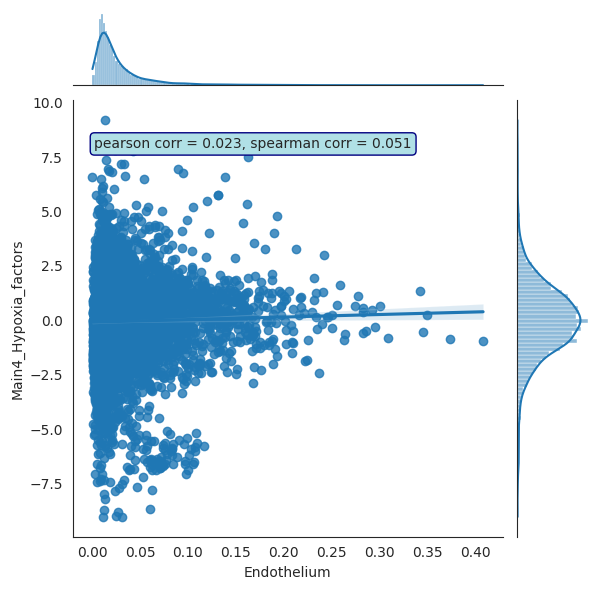

In [ ]:
celltype_from_deconv = "Endothelium"

g = sns.jointplot(
    tcga_deconv_ss.loc[celltype_from_deconv], tcga_ssgsea_ss[signature_name], kind="reg"
)
r, p = scipy.stats.pearsonr(
    tcga_deconv_ss.loc[celltype_from_deconv], tcga_ssgsea_ss[signature_name]
)
rs, ps = scipy.stats.spearmanr(
    tcga_deconv_ss.loc[celltype_from_deconv], tcga_ssgsea_ss[signature_name]
)

g.ax_joint.annotate(
    f"pearson corr = {r:.3f}, spearman corr = {rs:.3f}",
    xy=(0.05, 0.9),
    xycoords="axes fraction",
    ha="left",
    va="center",
    bbox={"boxstyle": "round", "fc": "powderblue", "ec": "navy"},  # fontsize=10.5
)
plt.show()

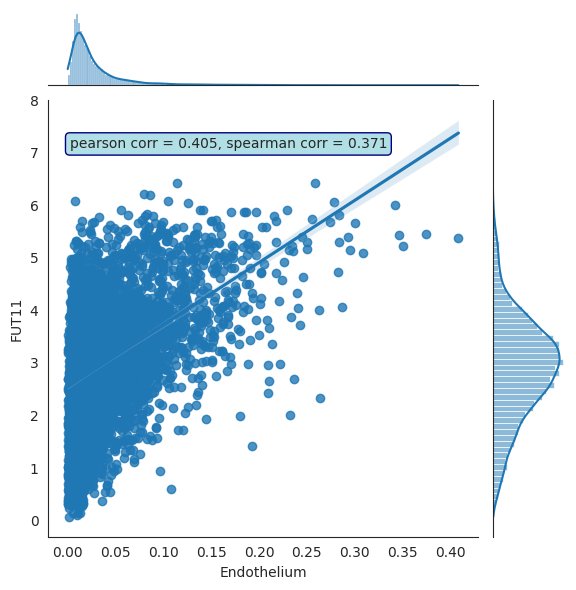

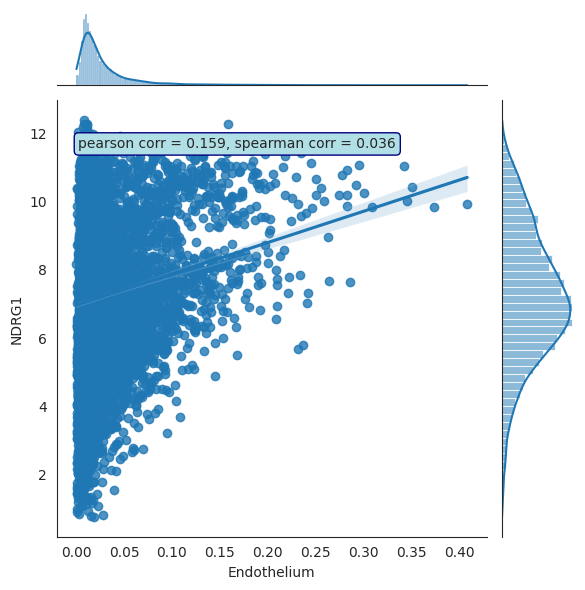

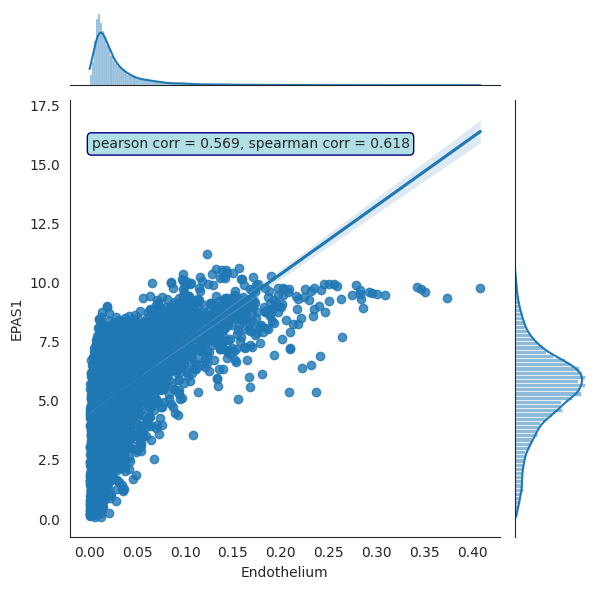

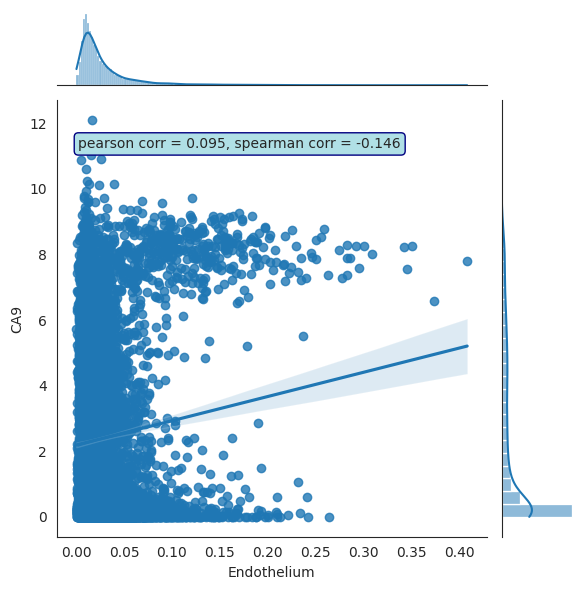

In [ ]:
# comparison with deconvolution for every gene (log2 (TPM+1)) in your signature of interest
for gene in signature_of_interest:
    g = sns.jointplot(
        tcga_deconv_ss.loc[celltype_from_deconv],
        tcga_expressions_to_use.loc[gene],
        kind="reg",
    )

    r, p = scipy.stats.pearsonr(
        tcga_deconv_ss.loc[celltype_from_deconv], tcga_expressions_to_use.loc[gene]
    )
    rs, ps = scipy.stats.spearmanr(
        tcga_deconv_ss.loc[celltype_from_deconv], tcga_expressions_to_use.loc[gene]
    )

    g.ax_joint.annotate(
        f"pearson corr = {r:.3f}, spearman corr = {rs:.3f}",
        xy=(0.05, 0.9),
        xycoords="axes fraction",
        ha="left",
        va="center",
        bbox={"boxstyle": "round", "fc": "powderblue", "ec": "navy"},  # fontsize=10.5
    )
    plt.show()

In [ ]:
deconv_corr_by_diagnosis = pd.DataFrame(
    columns=tcga_ssgsea_.keys(), index=tcga_deconv.index
)
for key, value in tcga_ssgsea_.items():
    value = value.reindex(tcga_expressions_to_use.columns).dropna()
    for celltype in tcga_deconv.index:
        deconv_corr_by_diagnosis.at[celltype, key] = scipy.stats.spearmanr(
            value[signature_name], tcga_deconv_ss[value.index].loc[celltype]
        ).correlation

In [ ]:
plt.figure(figsize=(20, 20))
sns.heatmap(
    deconv_corr_by_diagnosis.astype(float),
    cmap=default_cmap,
    annot=True,
    annot_kws={"fontsize": 10},
    vmin=0,
    vmax=1,
)
plt.show()

In [ ]:
signatures = geneset_of_interest
cell_types = [
    "NK_cells",
    "CD8_T_cells",
    "CD4_T_cells",
    "B_cells",
    "Macrophages",
    "Fibroblasts",
    "Endothelium",
    "Other",
]
corr_scores = []
for name, genes in signatures.items():
    ssgsea_scores = tcga_ssgsea_ss
    corr = tcga_deconv_ss.T[cell_types].corrwith(
        ssgsea_scores[name], axis="index", method="spearman"
    )
    corr.name = name
    corr_scores.append(corr)
corr_scores = pd.concat(corr_scores, axis=1)
f, ax = plt.subplots(figsize=(len(signatures) * 2, len(cell_types) * 1.5))
sns.heatmap(
    corr_scores,
    cbar=True,
    cmap="coolwarm",
    xticklabels=True,
    annot=True,
    vmin=0,
    vmax=1,
    ax=ax,
)

# Signature validation: single cell data

In [301]:
import scanpy as sc

### Definition of custom signature (once again, same as above)

In [ ]:
signature_of_interest = """FUT11	NDRG1	EPAS1	CA9	LDHA	LOX	SLC2A1	P4HA1	CA12	HK2	PDK1	PGK1	TPI1	ALDOA	PFKFB3""".split(
    "\t"
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']

# add here a custon signature name (as a first input)
signature_name = "Main4_Hypoxia_factors"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

### read annotation and expressions

https://docs.google.com/spreadsheets/d/1OPG6o5rq8lOnP1QZm8gSmgLPjq3Vz-gM6o3i8wzkBbQ/edit#gid=0 - here we have a full list of single cell data, pick anything suitable for your signature. Replace path in cell below with the path you see in H5ad column

In [ ]:
# ccRCC
adata = sc.read(
    "/uftp/single_cell/annotations/BG_Lab_datasets/220628_NovaA_RNA_10X/220628_NovaA_Sample6_stromal_ccRCC/220628_NovaA_Sample6.h5ad"
)

In [304]:
# check which column describes celltype in your  adata and pick this columns for the next cell in notebook
adata.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,predicted.annotation.l2,predicted.annotation.l2.score,mapping.score,CHESS_CAF_genes,endothelium_genes,...,senescence_genes,hypoxia_genes,tumor_growth_and_invasion_promotion_genes,tumor_growth_promotion_cytokine_genes,invasion_and_metastasis_induction_cytokine_genes,proliferation_genes,NFKB_genes,WNT_genes,TGFb_genes,Cell_type
AAACCCACAACCGTAT-1,582,725.0,36.0,4.965518,4,Connecting Tubule,0.312018,0.667875,-0.089549,-0.048709,...,-0.008320,-0.162195,0.320693,-0.160569,-0.021249,0.256663,0.084512,-0.020309,-0.069256,Tumor
AAACCCATCACCTGTC-1,789,1066.0,31.0,2.908068,4,Inner Medullary Collecting Duct,0.842988,0.825130,-0.150975,-0.028208,...,0.073560,0.291244,-0.236817,-0.191972,-0.055376,-0.171340,0.305808,-0.084591,0.113410,Tumor
AAACCCATCATGACAC-1,2896,9523.0,469.0,4.924919,0,Inner Medullary Collecting Duct,0.855052,0.751079,-0.145431,-0.083674,...,0.141164,0.308535,-0.392788,-0.276646,-0.053219,-0.165238,0.046793,-0.103775,-0.094525,Tumor
AAACGAACAAGGGCAT-1,521,680.0,41.0,6.029412,11,Papillary Tip Epithelial,0.586911,0.904170,-0.092688,-0.016801,...,0.243609,0.189177,-0.127984,-0.139345,-0.036648,-0.130229,0.242370,-0.007447,-0.071667,Tumor
AAACGAACATGACTCA-1,1560,2790.0,74.0,2.652330,1,Inner Medullary Collecting Duct,0.853989,0.865627,0.009267,-0.077636,...,0.106541,0.726778,-0.343166,-0.219569,-0.055311,-0.130145,-0.053139,-0.102003,0.094348,Tumor
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTCAGTGCGCT-1,2801,7906.0,955.0,12.079433,3,Inner Medullary Collecting Duct,0.854806,0.804543,-0.043865,-0.086304,...,-0.107645,0.001158,0.235438,-0.334119,-0.064686,-0.145432,0.023563,-0.051771,-0.116190,Tumor
TTTGTTGCACGTACAT-1,4095,13503.0,979.0,7.250240,5,Inner Medullary Collecting Duct,0.856718,0.820337,-0.086678,-0.087329,...,0.077802,0.334476,-0.332726,-0.033288,-0.035422,-0.174304,0.405278,-0.131786,-0.007198,Tumor
TTTGTTGGTAATCAGA-1,495,624.0,68.0,10.897436,10,Inner Medullary Collecting Duct,0.566459,0.904901,-0.096056,-0.008617,...,0.015371,-0.182559,-0.153951,-0.127692,-0.022554,-0.108408,-0.103789,-0.082476,-0.066827,Tumor
TTTGTTGGTCCTTGTC-1,1116,1614.0,73.0,4.522924,3,Inner Medullary Collecting Duct,0.738147,0.759420,0.045919,-0.042253,...,0.219301,0.004663,0.118095,-0.185748,-0.050550,-0.247595,-0.164118,0.004677,-0.088945,Tumor


In [ ]:
celltype_col = "leiden"

In [ ]:
# logn TPM+1
adata.X = scipy.sparse.csc_matrix(adata.X)
expr_df = pd.DataFrame.sparse.from_spmatrix(
    adata.X, index=adata.obs_names, columns=adata.var_names
).T
expr_df

,AAACCCACAACCGTAT-1,AAACCCATCACCTGTC-1,AAACCCATCATGACAC-1,AAACGAACAAGGGCAT-1,AAACGAACATGACTCA-1,AAACGAACATTGCTTT-1,AAACGAATCCAATCTT-1,AAACGCTAGCATGCAG-1,AAACGCTGTTCGAACT-1,AAACGCTTCCATACAG-1,...,TTTGGAGCAAACCATC-1,TTTGGAGCAAAGGAGA-1,TTTGGAGTCAGATTGC-1,TTTGGAGTCCGAGAAG-1,TTTGGTTCAGGAAGTC-1,TTTGGTTCAGTGCGCT-1,TTTGTTGCACGTACAT-1,TTTGTTGGTAATCAGA-1,TTTGTTGGTCCTTGTC-1,TTTGTTGTCTCGAACA-1
OR4F5,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
FO538757.3,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
FO538757.2,-0.278418,-0.250136,-0.405505,-0.29495,-0.271037,-0.302011,-0.254944,1.679188,-0.336813,-0.230207,...,-0.388805,-0.286561,-0.371934,-0.39014,-0.279189,1.533536,-0.500853,-0.372768,-0.284177,1.597116
OR4F29,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
OR4F16,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC006328.4,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CDY1,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
SPRY3-1,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
VAMP7-1,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


### delete genes w zero counts

In [307]:
row_sums = expr_df.sum(axis=1)
row_sums

OR4F5         0.000000
FO538757.3    0.000000
FO538757.2   -0.000005
OR4F29        0.000000
OR4F16        0.000000
                ...   
AC006328.4    0.000000
CDY1          0.000000
SPRY3-1       0.000000
VAMP7-1       0.000000
IL9R-1        0.000000
Length: 20097, dtype: float32

In [308]:
row_sums = row_sums[row_sums > 0]
row_sums

NOC2L      0.000023
PERM1      0.000013
RNF223     0.000033
TNFRSF4    0.000060
FAM132A    0.000001
             ...   
RAB39B     0.000056
F8A3       0.000021
IL9R       0.000023
ZFY        0.000005
PCDH11Y    0.000012
Length: 8196, dtype: float32

In [ ]:
# If the matrix is too big (> 20k cells) it can be better to replace expr_df instead of creating a copy
expr_df = expr_df.loc[row_sums.index]
expr_df

,AAACCCACAACCGTAT-1,AAACCCATCACCTGTC-1,AAACCCATCATGACAC-1,AAACGAACAAGGGCAT-1,AAACGAACATGACTCA-1,AAACGAACATTGCTTT-1,AAACGAATCCAATCTT-1,AAACGCTAGCATGCAG-1,AAACGCTGTTCGAACT-1,AAACGCTTCCATACAG-1,...,TTTGGAGCAAACCATC-1,TTTGGAGCAAAGGAGA-1,TTTGGAGTCAGATTGC-1,TTTGGAGTCCGAGAAG-1,TTTGGTTCAGGAAGTC-1,TTTGGTTCAGTGCGCT-1,TTTGTTGCACGTACAT-1,TTTGTTGGTAATCAGA-1,TTTGTTGGTCCTTGTC-1,TTTGTTGTCTCGAACA-1
NOC2L,-0.237045,-0.219039,-0.482928,-0.250034,-0.263902,-0.266190,2.652720,-0.481404,1.946141,-0.206090,...,-0.448351,-0.265819,-0.350840,-0.392191,-0.241803,-0.533464,0.765050,-0.313668,-0.256017,-0.401827
PERM1,-0.039231,-0.023247,-0.008274,-0.047038,-0.015399,-0.043765,0.004680,-0.052208,-0.008048,-0.012146,...,-0.013753,-0.029136,-0.058278,-0.050026,-0.037007,-0.065358,-0.011123,-0.082240,-0.032950,0.001296
RNF223,-0.191006,-0.197050,-0.336765,-0.190057,-0.225660,-0.200769,-0.247578,-0.295794,-0.286511,-0.201036,...,-0.315237,-0.213992,-0.227893,-0.255195,-0.195316,-0.308605,-0.402254,-0.188195,-0.205819,-0.306808
TNFRSF4,-0.087309,-0.102937,-0.116195,-0.079655,-0.110346,-0.082758,-0.129830,-0.073490,-0.116935,-0.113793,...,-0.111038,-0.096982,-0.068232,-0.076051,-0.089448,-0.060450,-0.112723,-0.045120,-0.093323,-0.125898
FAM132A,-0.057339,-0.076266,-0.114476,-0.048401,-0.089476,-0.053725,-0.115440,-0.058732,-0.107052,-0.089378,...,-0.105015,-0.072222,-0.041522,-0.054987,-0.060503,-0.045878,-0.121272,-0.008468,-0.066677,-0.120678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RAB39B,0.001278,0.015567,-0.072141,-0.007211,0.003245,-0.011430,0.010392,-0.093047,-0.033977,0.025650,...,-0.062366,-0.004153,-0.048998,-0.059858,0.000651,-0.118213,-0.124887,-0.047314,-0.002486,-0.038266
F8A3,-0.048600,-0.037623,-0.065832,-0.054536,-0.039597,-0.055008,-0.029921,-0.089008,-0.051223,-0.029939,...,-0.064008,-0.047171,-0.074339,-0.075616,-0.048068,-0.103145,-0.086902,-0.081997,-0.047857,-0.049619
IL9R,0.070725,0.063189,-0.120931,0.071761,0.025620,0.057703,-0.002768,-0.068043,-0.054548,0.058234,...,-0.092649,0.040647,0.021473,-0.014359,0.065096,-0.085332,-0.207509,0.073237,0.051336,-0.081096
ZFY,0.011305,0.009354,-0.077518,0.010988,-0.007872,0.004578,-0.019412,-0.056700,-0.045610,0.008132,...,-0.064505,-0.002088,-0.014339,-0.030688,0.008833,-0.066377,-0.119399,0.008023,0.002648,-0.057386


### ssgsea score comparison

In [ ]:
# cgenes = expr_df_final
# cgenes = cgenes.fillna(cgenes.median(axis=1))

cprocesses = ssgsea_formula(
    expr_df,
    gmt_genes_alt_names(geneset_of_interest, expr_df.index, verbose=False),
    rank_method="average",
).T
cprocesses_sc = median_scale(cprocesses)
# if we don't want to scale ssgsea scores:
# cprocesses_sc = cprocesses

In [311]:
cprocesses_sc["Cell_types"] = adata.obs[celltype_col].tolist()
cprocesses_sc["Cell_name"] = cprocesses_sc.index
cprocesses_sc

,Main4_Hypoxia_factors,Cell_types,Cell_name
AAACCCACAACCGTAT-1,-2.643371,4,AAACCCACAACCGTAT-1
AAACCCATCACCTGTC-1,-0.612574,4,AAACCCATCACCTGTC-1
AAACCCATCATGACAC-1,1.643731,0,AAACCCATCATGACAC-1
AAACGAACAAGGGCAT-1,-0.599655,11,AAACGAACAAGGGCAT-1
AAACGAACATGACTCA-1,1.252917,1,AAACGAACATGACTCA-1
...,...,...,...
TTTGGTTCAGTGCGCT-1,0.257095,3,TTTGGTTCAGTGCGCT-1
TTTGTTGCACGTACAT-1,1.973077,5,TTTGTTGCACGTACAT-1
TTTGTTGGTAATCAGA-1,-2.340930,10,TTTGTTGGTAATCAGA-1
TTTGTTGGTCCTTGTC-1,-1.553636,3,TTTGTTGGTCCTTGTC-1


In [ ]:
# sort all ssdata according to signature abundance
ctypes_median = pd.Series(data="NA", index=set(adata.obs[celltype_col].tolist()))

for type_name in cprocesses_sc["Cell_types"]:
    ctypes_median[type_name] = cprocesses_sc.loc[
        cprocesses_sc["Cell_types"] == type_name
    ][signature_name].median()

In [ ]:
df_median = ctypes_median.sort_values(ascending=False)
df_median

1      1.61899
13     1.16621
2     0.597066
5     0.477083
0     0.411733
3     0.309056
12    0.119773
8     0.078482
11   -0.561977
14   -0.563279
6    -0.621856
9     -0.62242
4    -1.354039
10   -1.435548
7    -1.469999
15   -1.517772
dtype: object

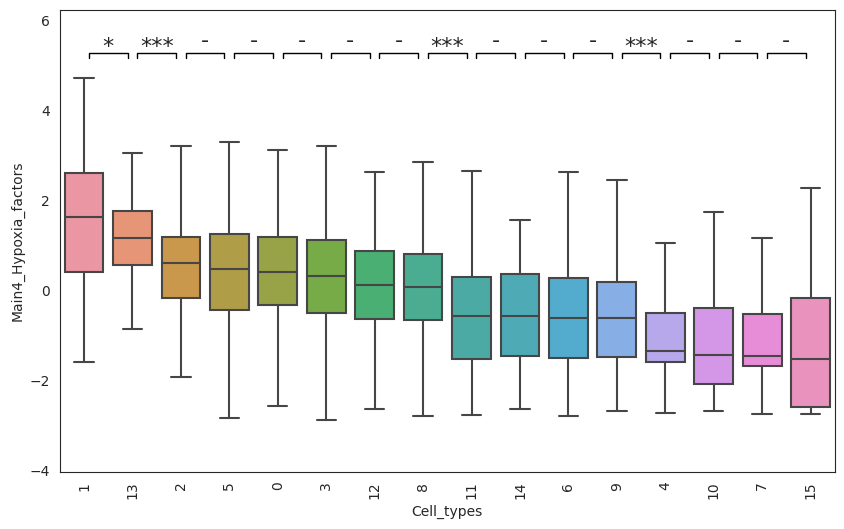

In [ ]:
ax = boxplot_with_pvalue(
    cprocesses_sc[signature_name],
    cprocesses_sc["Cell_types"],
    order=df_median.index,
    swarm=False,
    figsize=[10, 6],
)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.show()

### UMAP plots

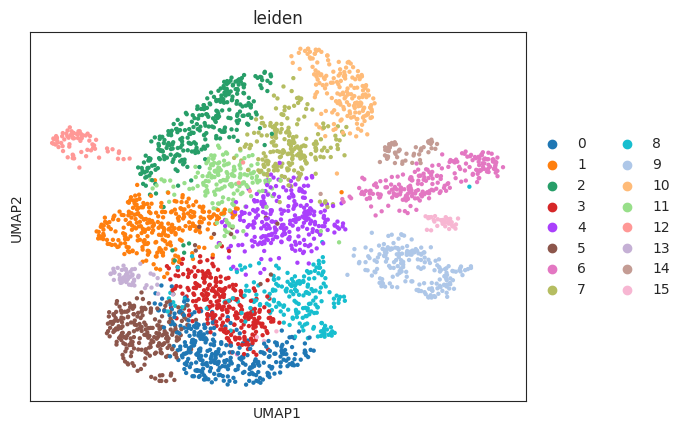

In [319]:
sc.pl.umap(adata, color=[celltype_col])

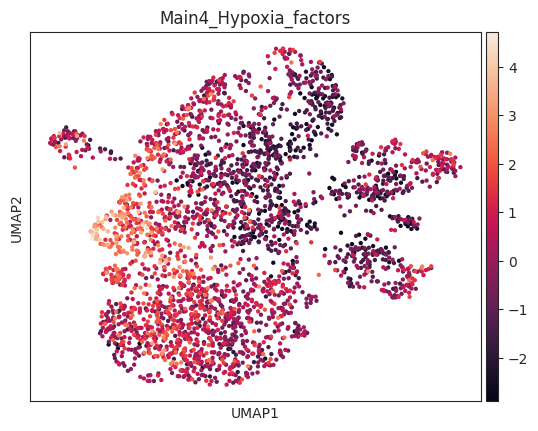

In [ ]:
# umap with ssgsea score
adata.obs[signature_name] = cprocesses_sc[signature_name]
sc.pl.umap(adata, color=[signature_name])

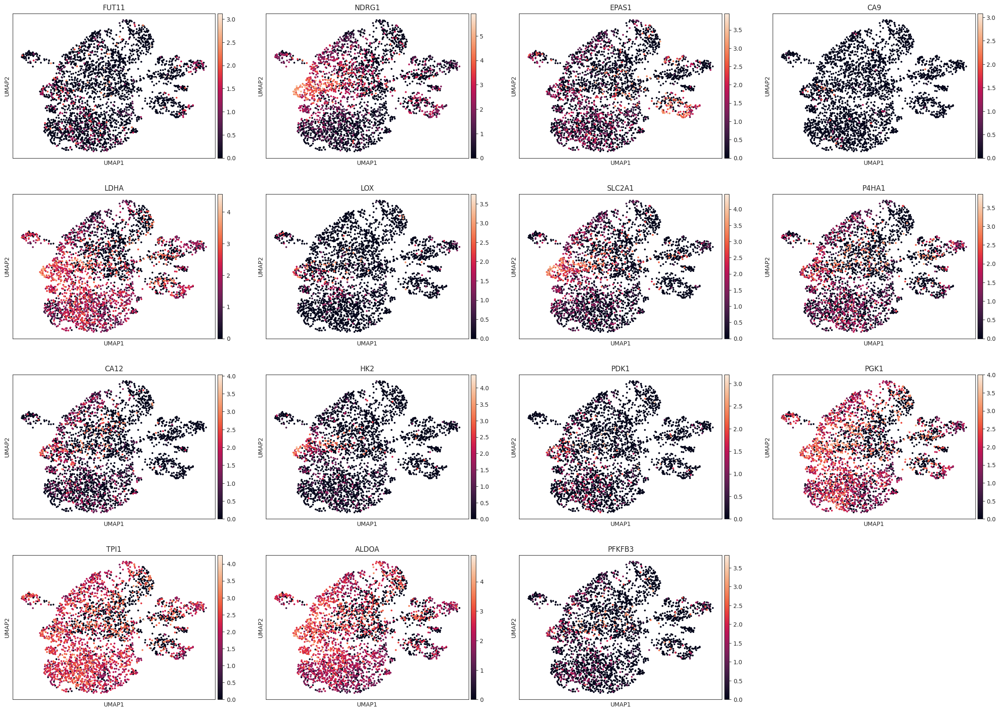

In [ ]:
# umap with custom genes (ln expressions)
genes_of_interest = signature_of_interest
sc.pl.umap(adata, color=genes_of_interest)

#### HALLMARK_HYPOXIA

In [ ]:
signature_of_interest = """ADM,ADORA2B,AK4,AKAP12,ALDOA,ALDOB,ALDOC,AMPD3,ANGPTL4,ANKZF1,ANXA2,ATF3,ATP7A,B3GALT6,B4GALNT2,BCAN,BCL2,BGN,BHLHE40,BNIP3L,BRS3,BTG1,CA12,CASP6,CAV1,CCNG2,CCRN4L,CDKN1A,CDKN1B,CDKN1C,CHST2,CHST3,CITED2,COL5A1,CP,CSRP2,CTGF,CXCR4,ACKR3,CYR61,DCN,DDIT3,DDIT4,DPYSL4,DTNA,DUSP1,EDN2,EFNA1,EFNA3,EGFR,ENO1,ENO2,ENO3,ERO1L,ERRFI1,ETS1,EXT1,F3,FAM162A,FBP1,FOS,FOSL2,FOXO3,GAA,GALK1,GAPDH,GAPDHS,GBE1,GCK,GCNT2,GLRX,GPC1,GPC3,GPC4,GPI,GRHPR,GYS1,HAS1,HDLBP,HEXA,HK1,HK2,HMOX1,HOXB9,HS3ST1,HSPA5,IDS,IER3,IGFBP1,IGFBP3,IL6,ILVBL,INHA,IRS2,ISG20,JMJD6,JUN,KDELR3,KDM3A,KIF5A,KLF6,KLF7,KLHL24,LALBA,LARGE,LDHA,LDHC,LOX,LXN,MAFF,MAP3K1,MIF,MT1E,MT2A,MXI1,MYH9,NAGK,NCAN,NDRG1,NDST1,NDST2,NEDD4L,NFIL3,NR3C1,P4HA1,P4HA2,PAM,PCK1,PDGFB,PDK1,PDK3,PFKFB3,PFKL,PFKP,PGAM2,PGF,PGK1,PGM1,PGM2,PHKG1,PIM1,PKLR,PKP1,PLAC8,PLAUR,PLIN2,PNRC1,PPARGC1A,PPFIA4,PPP1R15A,PPP1R3C,PRDX5,PRKCA,PRKCDBP,PTRF,PYGM,RBPJ,RORA,RRAGD,S100A4,SAP30,SCARB1,SDC2,SDC3,SDC4,SELENBP1,SERPINE1,SIAH2,SLC25A1,SLC2A1,SLC2A3,SLC2A5,SLC37A4,SLC6A6,SRPX,STC1,STC2,SULT2B1,TES,TGFB3,TGFBI,TGM2,TIPARP,TKTL1,TMEM45A,TNFAIP3,TPBG,TPD52,TPI1,TPST2,UGP2,VEGFA,VHL,VLDLR,WISP2,WSB1,XPNPEP1,ZFP36,ZNF292""".split(
    ","
)
# OR
# signature_of_interest = ['ITGAX', 'HLA-DRA', 'HLA-DRB1', 'CD1C', 'FCER1A', 'CLEC10A', 'AMICA1']
# STBD1,
# add here a custon signature name (as a first input)
signature_name = "HALLMARK_HYPOXIA"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
# cgenes = expr_df_final
# cgenes = cgenes.fillna(cgenes.median(axis=1))

cprocesses = ssgsea_formula(
    expr_df,
    gmt_genes_alt_names(geneset_of_interest, expr_df.index, verbose=False),
    rank_method="average",
).T
cprocesses_sc = median_scale(cprocesses)
# if we don't want to scale ssgsea scores:
# cprocesses_sc = cprocesses

In [326]:
cprocesses_sc["Cell_types"] = adata.obs[celltype_col].tolist()
cprocesses_sc["Cell_name"] = cprocesses_sc.index
cprocesses_sc

,HALLMARK_HYPOXIA,Cell_types,Cell_name
AAACCCACAACCGTAT-1,-2.107521,4,AAACCCACAACCGTAT-1
AAACCCATCACCTGTC-1,-1.860126,4,AAACCCATCACCTGTC-1
AAACCCATCATGACAC-1,1.103489,0,AAACCCATCATGACAC-1
AAACGAACAAGGGCAT-1,-0.667536,11,AAACGAACAAGGGCAT-1
AAACGAACATGACTCA-1,-0.190184,1,AAACGAACATGACTCA-1
...,...,...,...
TTTGGTTCAGTGCGCT-1,1.428052,3,TTTGGTTCAGTGCGCT-1
TTTGTTGCACGTACAT-1,2.341163,5,TTTGTTGCACGTACAT-1
TTTGTTGGTAATCAGA-1,-1.718026,10,TTTGTTGGTAATCAGA-1
TTTGTTGGTCCTTGTC-1,-0.748826,3,TTTGTTGGTCCTTGTC-1


In [ ]:
# sort all ssdata according to signature abundance
ctypes_median = pd.Series(data="NA", index=set(adata.obs[celltype_col].tolist()))

for type_name in cprocesses_sc["Cell_types"]:
    ctypes_median[type_name] = cprocesses_sc.loc[
        cprocesses_sc["Cell_types"] == type_name
    ][signature_name].median()

In [ ]:
df_median = ctypes_median.sort_values(ascending=False)
df_median

13    1.537022
5     0.973395
1     0.863294
0     0.647339
2     0.593213
3     0.519282
8     0.039434
14   -0.365336
12   -0.374523
15   -0.515473
9    -0.641944
6     -0.68911
11    -1.06861
7    -1.140652
4     -1.22573
10   -1.477313
dtype: object

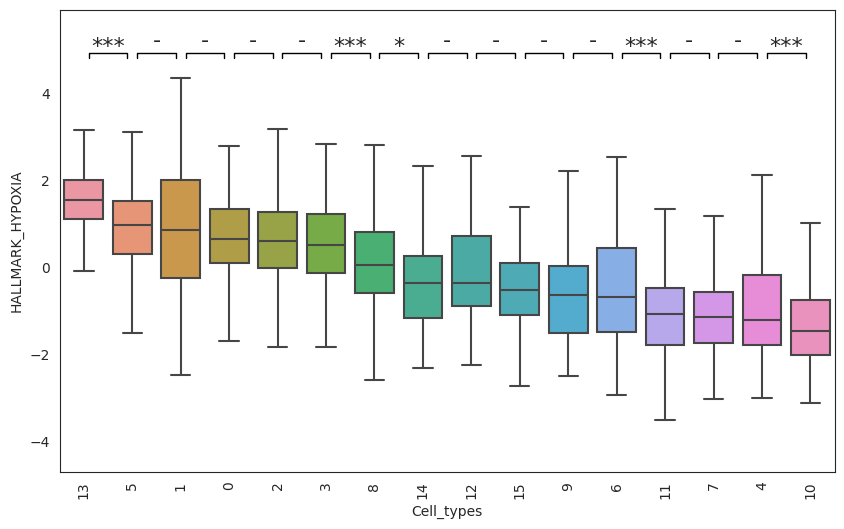

In [ ]:
ax = boxplot_with_pvalue(
    cprocesses_sc[signature_name],
    cprocesses_sc["Cell_types"],
    order=df_median.index,
    swarm=False,
    figsize=[10, 6],
)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.show()

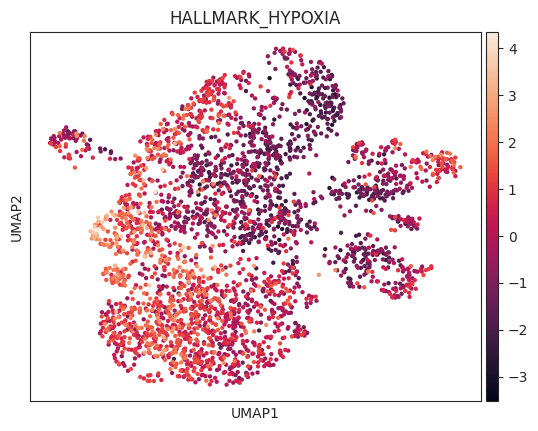

In [ ]:
# umap with ssgsea score
adata.obs[signature_name] = cprocesses_sc[signature_name]
sc.pl.umap(adata, color=[signature_name])